

---


# **PROJECT HUMAN DATA ANALYTICS**




---



**IMPORT LIBRARIES AND METHODS**

In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

#Plot
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.gridspec import GridSpec

#Pre-processing
from scipy import signal, fft, interpolate
from scipy.signal import butter, iirnotch, lfilter, filtfilt,lti, tf2zpk, freqz, get_window, windows, resample, medfilt
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split

# Evaluation metrics
import sklearn.metrics as metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support

import seaborn as sns
sns.set_theme(style="whitegrid", font_scale=1)

#Deep learning
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping 
from keras.layers import Input, Dense, Flatten, concatenate
from sklearn.utils import class_weight

#Machine learning
from sklearn.ensemble import RandomForestClassifier
#Load and save the model
import json
from keras.models import load_model

import os
import random

In [2]:
# ECG detectors installing
!pip install py-ecg-detectors
from ecgdetectors import Detectors

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 554.5/554.5 KB 10.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for gatspy: filename=gatspy-0.3-py3-none-any.whl size=43818 sha256=598b4a151ab0d731b34151f549381d46fa3d8cbba1888ad029e781b26a11c7a5
  Stored in directory: /root/.cache/pip/wheels/13/7e/da/8944bc12def4de5f19b70d9c35634f78cbe6640907ff2e71ba
Successfully built gatspy


**Seed fixation**

In [3]:
RANDOM_SEED = 456 

tf.random.set_seed(RANDOM_SEED) 
np.random.seed(RANDOM_SEED) 
random.seed(RANDOM_SEED)
tf.keras.utils.set_random_seed(RANDOM_SEED)

**Import functions**

In [4]:
#import functions-zip
!gdown 13NDn9ggl_r2A_-2kMr-39y5oOev9aQOt

Downloading...
From: https://drive.google.com/uc?id=13NDn9ggl_r2A_-2kMr-39y5oOev9aQOt
To: /content/Functions.zip
100% 6.55k/6.55k [00:00<00:00, 10.7MB/s]


In [5]:
!unzip Functions.zip -d .

Archive:  Functions.zip
  inflating: ./Functions/utils.py    
  inflating: ./Functions/ecg_preprocessing.py  
  inflating: ./Functions/signal_plot.py  
  inflating: ./Functions/filtering.py  
  inflating: ./Functions/loading_data.py  


In [6]:
!mv Functions/* .
!rmdir Functions

In [7]:
!rm Functions.zip

# **IMPORT DATA-SET**



> **1.**  Import links of zip folders;

> **2.**  unzip;

> **3.**  remove zip folders;

> **4.**  load ECG data;

> **5.** plot ECG data for each subject













In [8]:
from loading_data import load_data, data_from_csv

In [9]:
#import data-zip
#!gdown 1M6e0uV72RNy5KtL0OUTb4iLqQgbnFh_6
!gdown 1-qNqfYrRBd9fYNlgoOQN0tfHALV_fBUi

Downloading...
From: https://drive.google.com/uc?id=1-qNqfYrRBd9fYNlgoOQN0tfHALV_fBUi
To: /content/ECG_PPO_data.zip
100% 2.82M/2.82M [00:00<00:00, 50.0MB/s]


In [10]:
# unzip
!unzip ECG_PPO_data.zip -d .

Archive:  ECG_PPO_data.zip
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_03.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_11.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_03.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_01.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_09.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_01.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_07.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_12.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_07.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_13.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_04.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_05.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_13.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_06.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_09.csv  
  inflating: ./ECG_PPO_data/New_data/Task/ID_12.csv  
  inflating: ./ECG_PPO_data/New_data/Riposo/ID_08.csv  
  inflating: ./ECG_PPO_data/New_d

In [11]:
#remove data-zip
!rm ECG_PPO_data.zip 

In [12]:
# Pathway
data_path_rest = "/content/ECG_PPO_data/New_data/Riposo"
data_path_task = "/content/ECG_PPO_data/New_data/Task"

#Loading
data_rest, data_task = load_data(data_path_rest, data_path_task)

ID_07 (22922,) (22922,) (17312,) (17312,)
ID_11 (18031,) (18031,) (13683,) (13683,)
ID_08 (16644,) (16644,) (12534,) (12534,)
ID_09 (16279,) (16279,) (12236,) (12236,)
ID_04 (19491,) (19491,) (14595,) (14595,)
ID_10 (17739,) (17739,) (13361,) (13361,)
ID_12 (18688,) (18688,) (14016,) (14016,)
ID_02 (18104,) (18104,) (13626,) (13626,)
ID_06 (20732,) (20732,) (15553,) (15553,)
ID_03 (19491,) (19491,) (267,) (267,)
ID_13 (18469,) (18469,) (13841,) (13841,)
ID_05 (17593,) (17593,) (13205,) (13205,)
ID_14 (18615,) (18615,) (14041,) (14041,)
ID_01 (20805,) (20805,) (285,) (285,)
ID_15 (19710,) (19710,) (14775,) (14775,)
ID_07 (21535,) (21535,) (16263,) (16263,)
ID_11 (23360,) (23360,) (17720,) (17720,)
ID_08 (27156,) (27156,) (20389,) (20389,)
ID_09 (27083,) (27083,) (20286,) (20286,)
ID_04 (22484,) (22484,) (16843,) (16843,)
ID_10 (21243,) (21243,) (15953,) (15953,)
ID_12 (22703,) (22703,) (16984,) (16984,)
ID_02 (21170,) (21170,) (15856,) (15856,)
ID_06 (21900,) (21900,) (16414,) (16414,)


**ECG PLOT**

Functions:


1.   ECG_plot_subj;
2.   ECG_plot_subj_zoom



In [13]:
def ECG_plot_subj(data_dict, is_raw):
    
    if is_raw:
      for key, value in data_dict.items(): 
        
        #idx = key.rfind('_')
        #name = key[:idx]
        
        plt.figure(constrained_layout=True, figsize=(10,6)) 
        plt.title(f'{key}: Raw ECG signal (whole recording)', fontsize = 22) 
        plt.plot(value[0]['ECG time grid'], value[0]['raw ECG signal'], 'r')
        plt.xlabel('Time (s)', fontsize = 22)
        plt.ylabel('ECG(mV)', fontsize = 22)
          
        plt.show()
      
    else:
      for key, value in data_dict.items():

       
        idx = key.rfind('_')
        name = key[:idx]
        plt.figure(constrained_layout=True, figsize=(10,6)) #crea la figura
        
        plt.title(f'{key}: filtered ECG signal (whole recording)', fontsize = 22) 
        plt.plot(value[0]['ECG time grid'], value[0]['ECG filtered'], 'r')
        plt.xlabel('Time (s)', fontsize = 22)
        plt.ylabel('Normalized Value ECG', fontsize = 22)
        
        plt.show()

In [14]:
def ECG_plot_subj_zoom(data_dict, is_raw, i, j):
    
    if is_raw:
      for key, value in data_dict.items(): 
        

        
        plt.figure(constrained_layout=True, figsize=(10,6)) 
        plt.title(f'{key}: Raw ECG signal (subset)', fontsize = 22) 
        plt.plot(value[0]['ECG time grid'][i:j], value[0]['raw ECG signal'][i:j], 'r')
        plt.xlabel('Time (s)', fontsize = 22)
        plt.ylabel('ECG(mV)', fontsize = 22)
          
        plt.show()
      
    else:
      for key, value in data_dict.items():

      
        plt.figure(constrained_layout=True, figsize=(10,6)) 
        
        plt.title(f'{key}: filtered ECG signal (subset)', fontsize = 22) 
        plt.plot(value[0]['ECG time grid'][i:j], value[0]['ECG filtered'][i:j], 'r')
        plt.plot(value[0]['ECG time grid'][i:j], value[0]['ECG normalized'][i:j], 'g')
        plt.xlabel('Time (s)', fontsize = 22)
        plt.ylabel('Normalized Value ECG', fontsize = 22)
        
        plt.show()

**DATA REST PLOT**

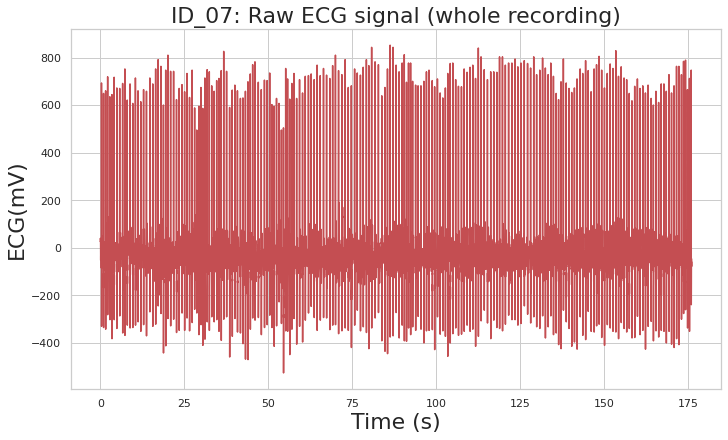

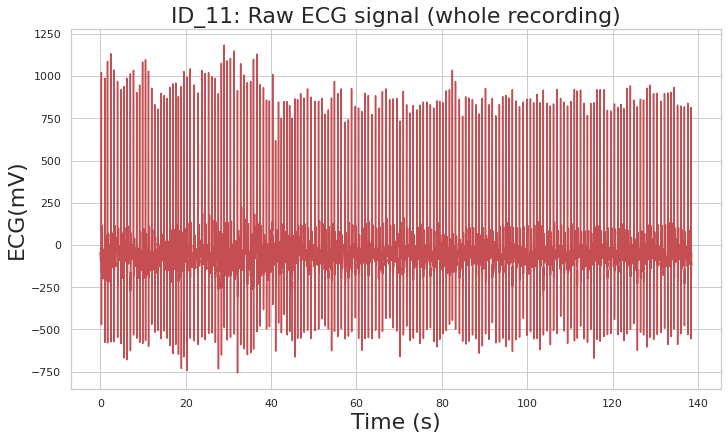

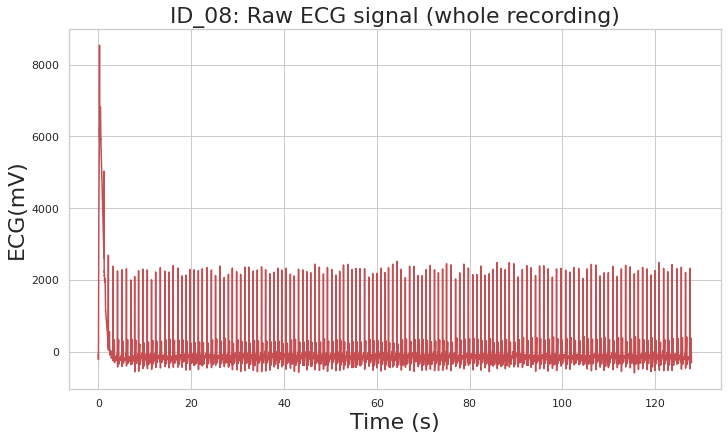

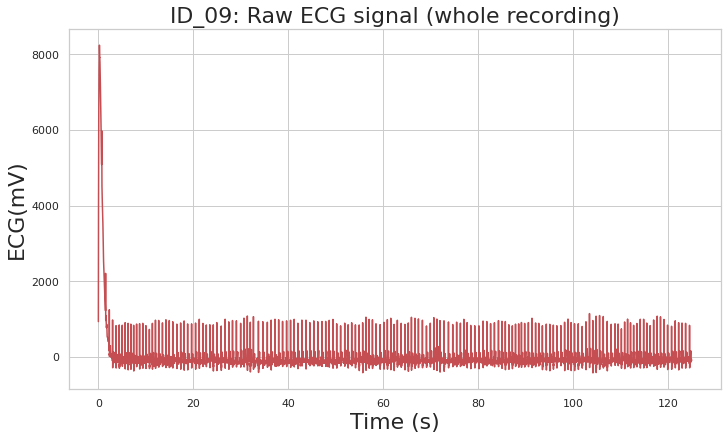

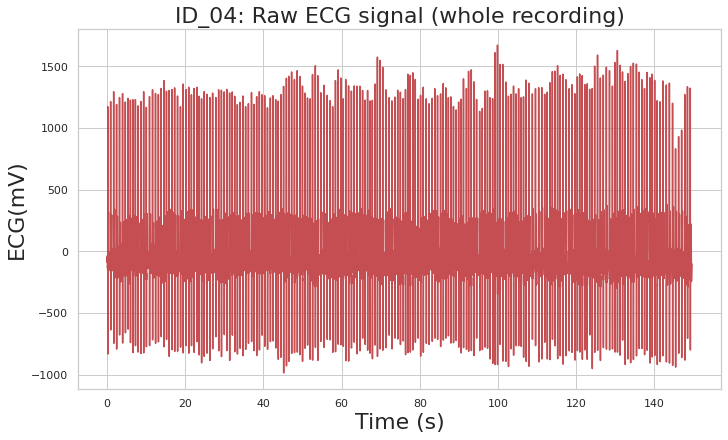

...

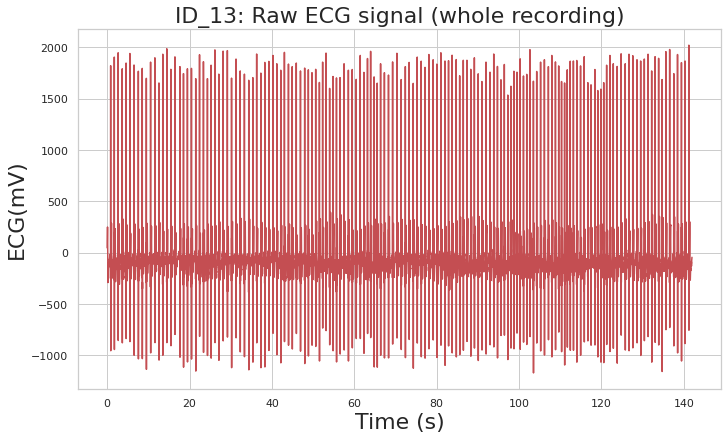

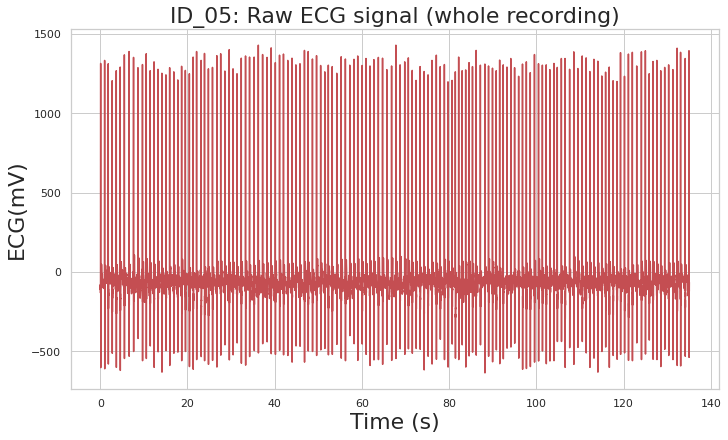

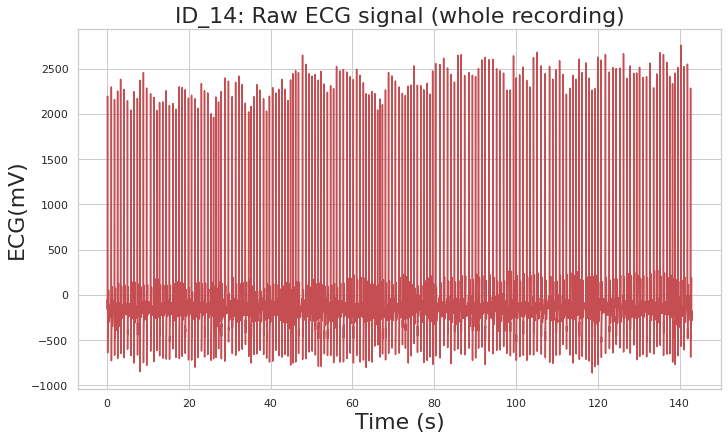

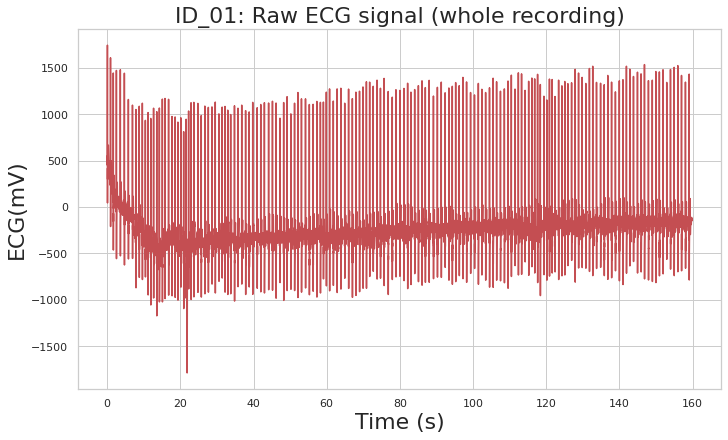

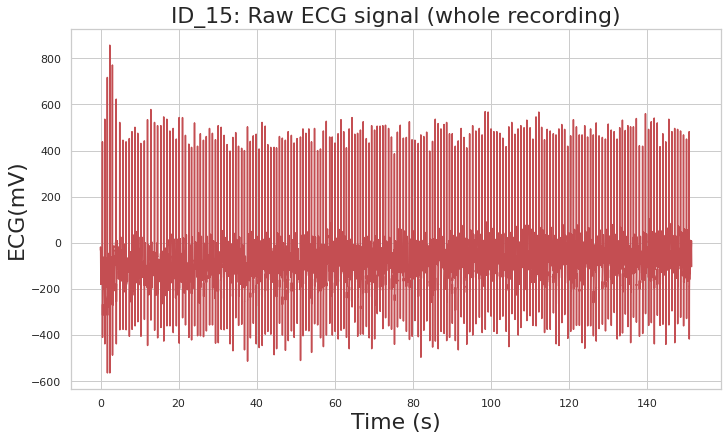

In [15]:
#ECG plot rest
ECG_plot_subj(data_rest, is_raw = True)

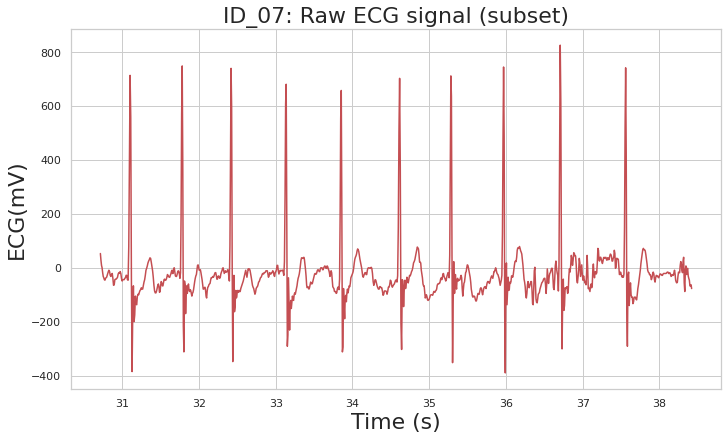

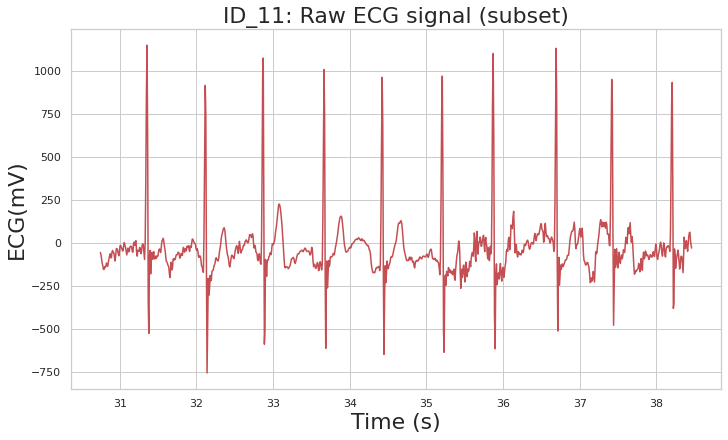

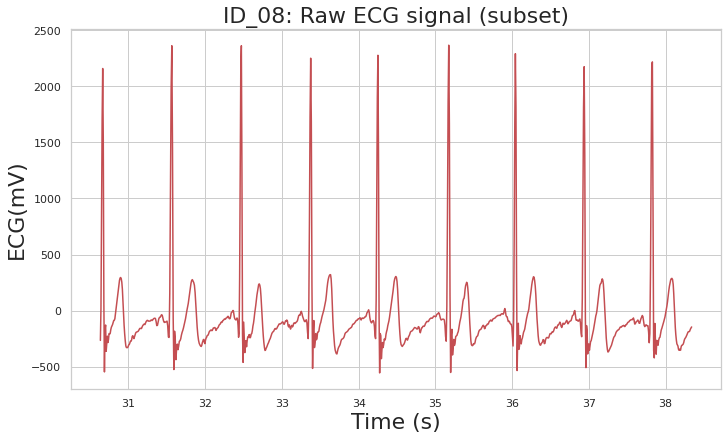

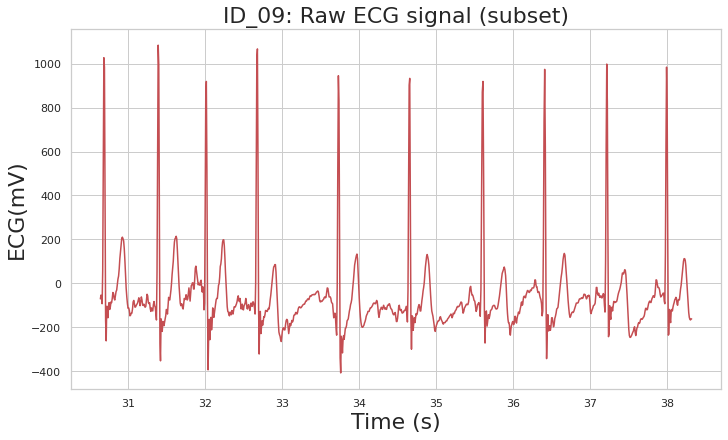

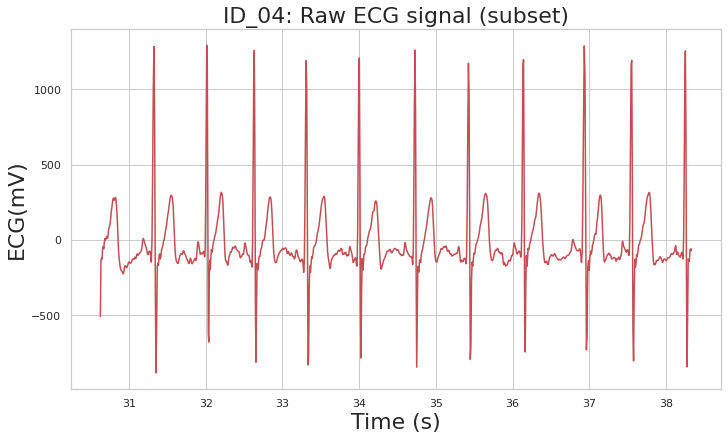

...

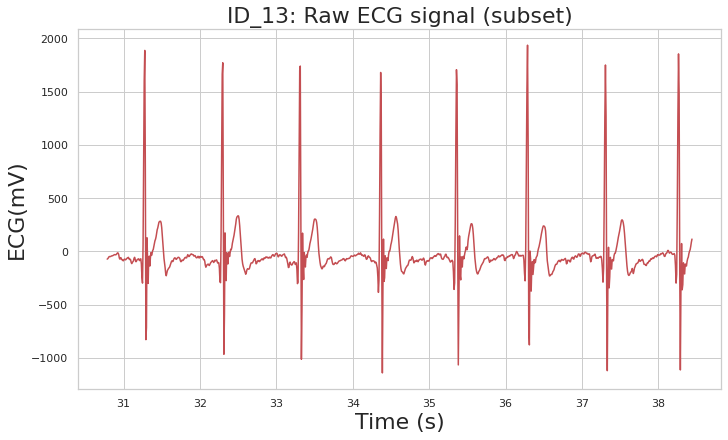

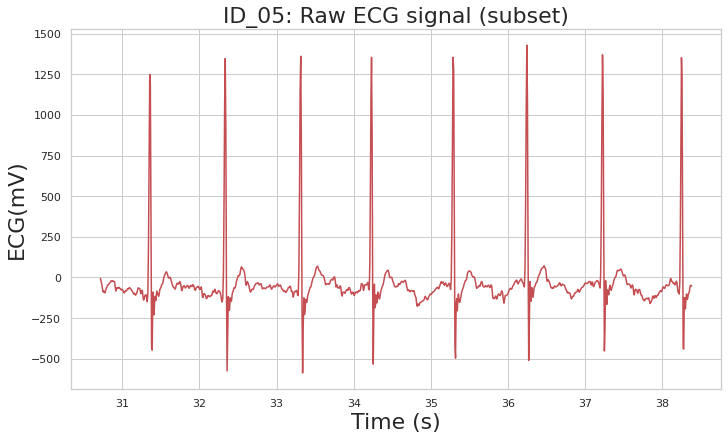

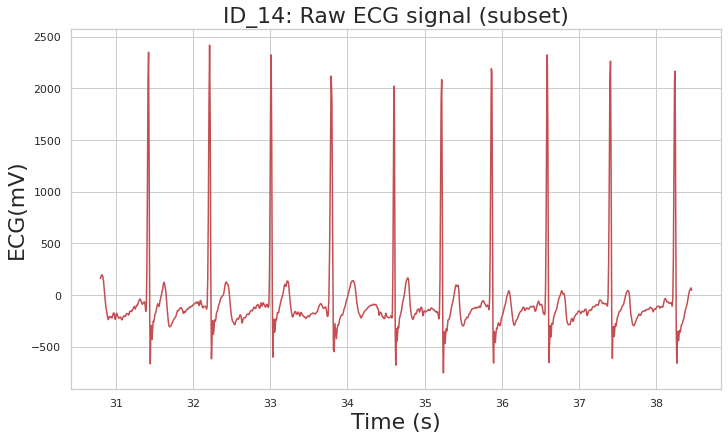

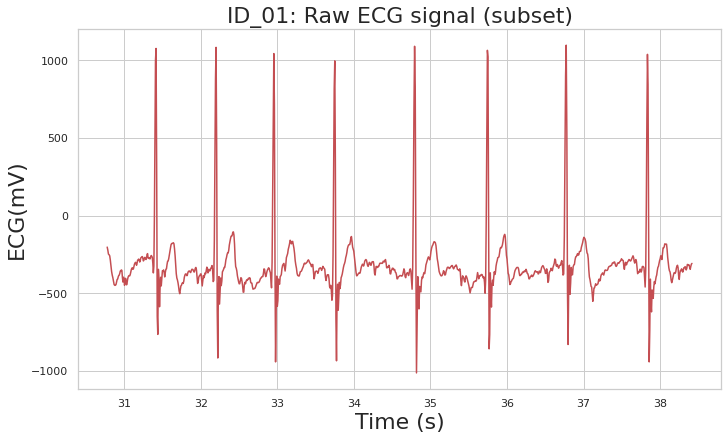

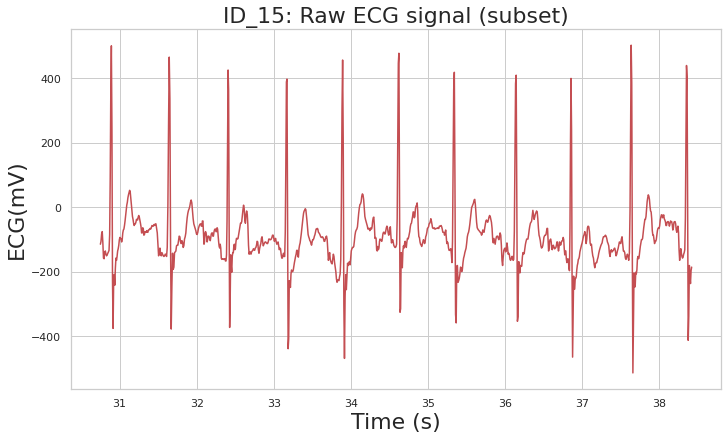

In [16]:
#ECG plot rest (zoom)
ECG_plot_subj_zoom(data_rest, is_raw = True, i = 4000, j = 5000)

**DATA TASK PLOT**

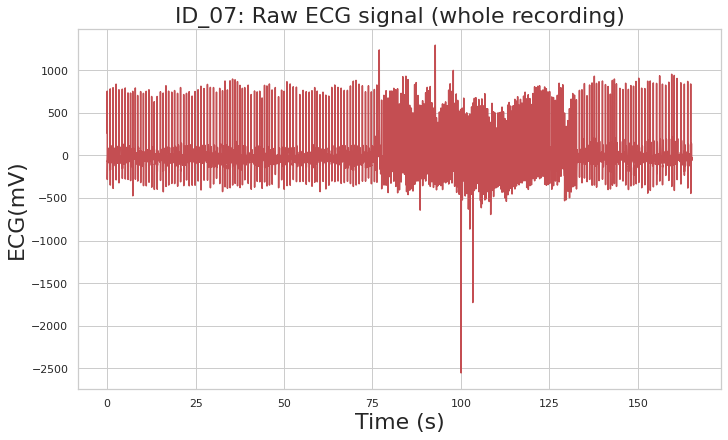

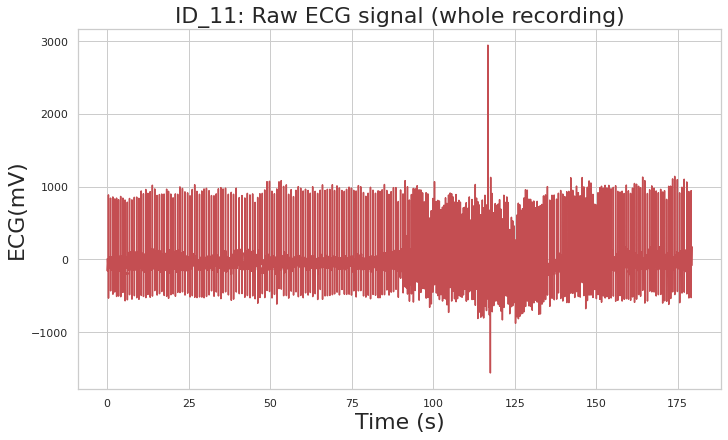

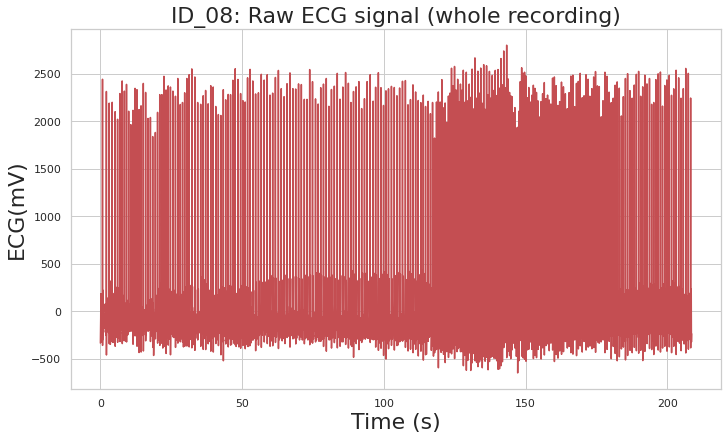

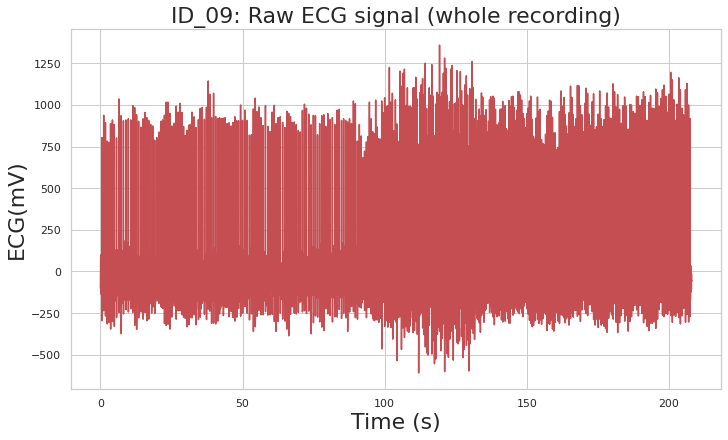

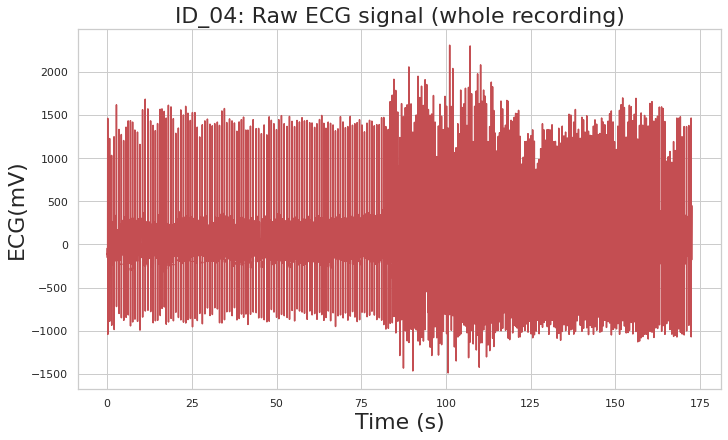

...

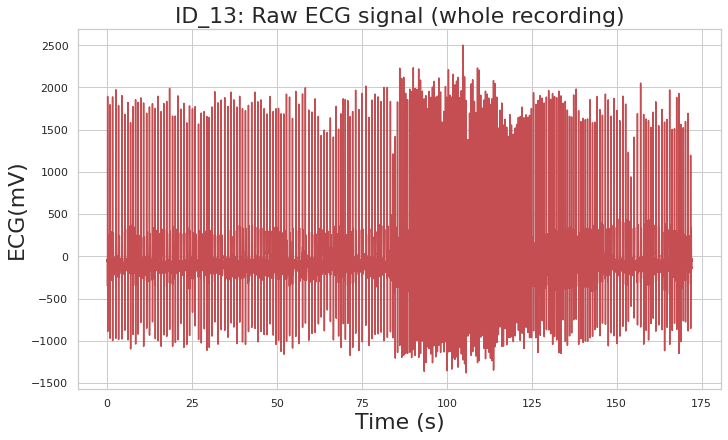

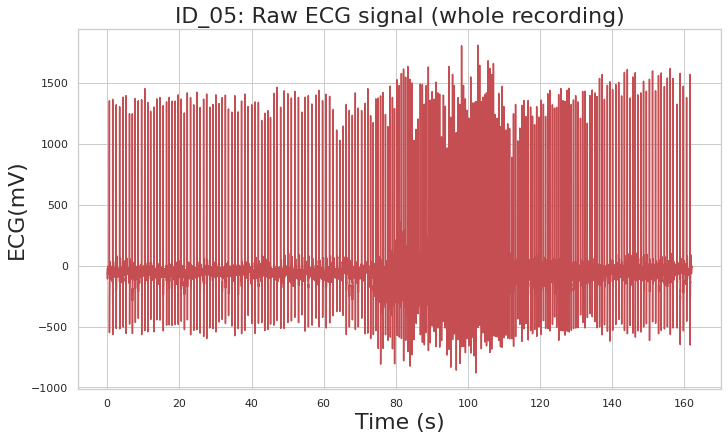

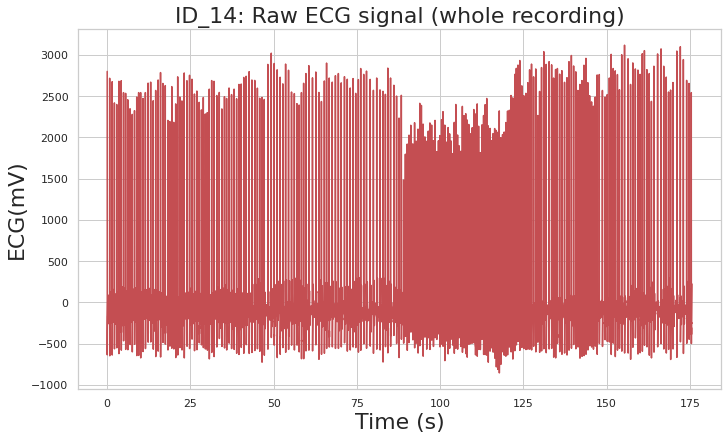

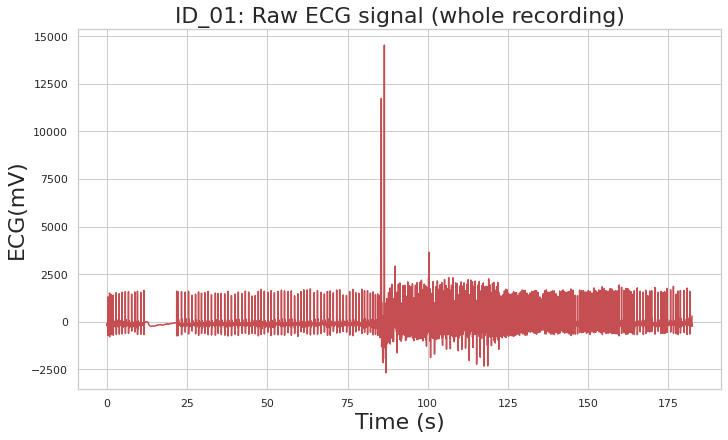

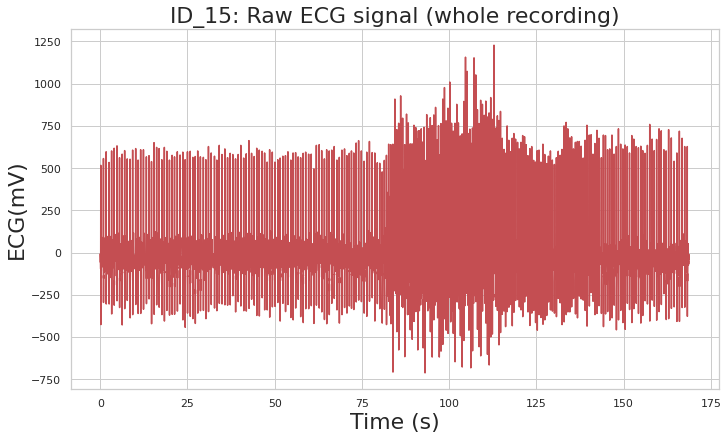

In [17]:
#ECG plot task
ECG_plot_subj(data_task, is_raw = True)

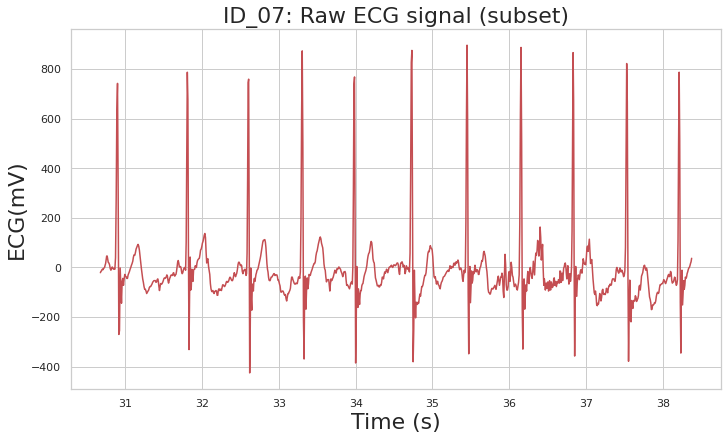

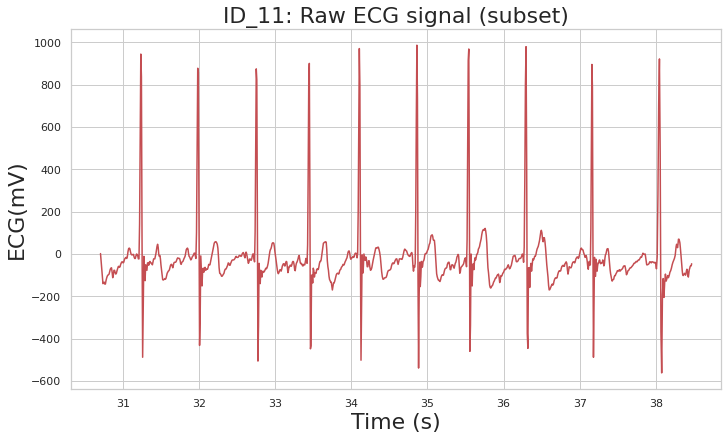

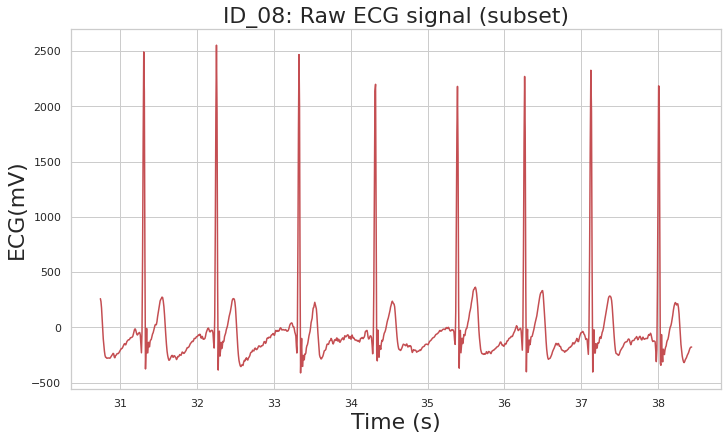

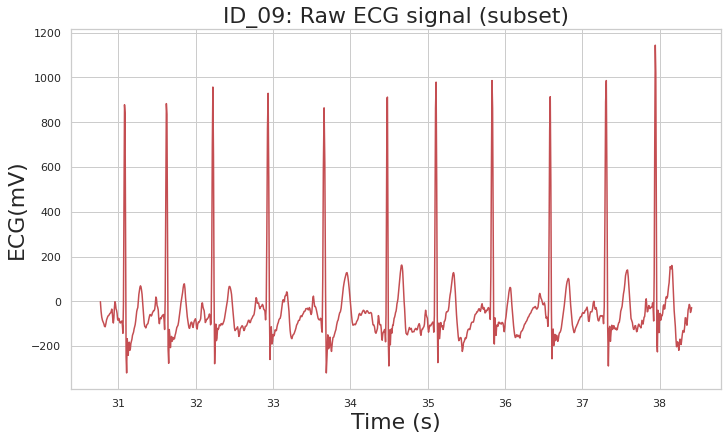

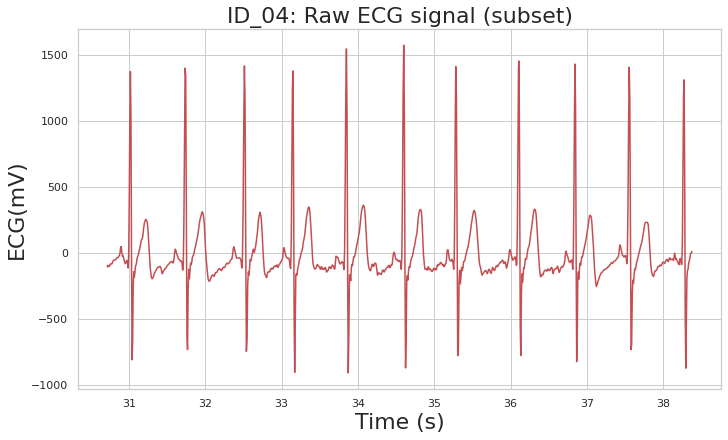

...

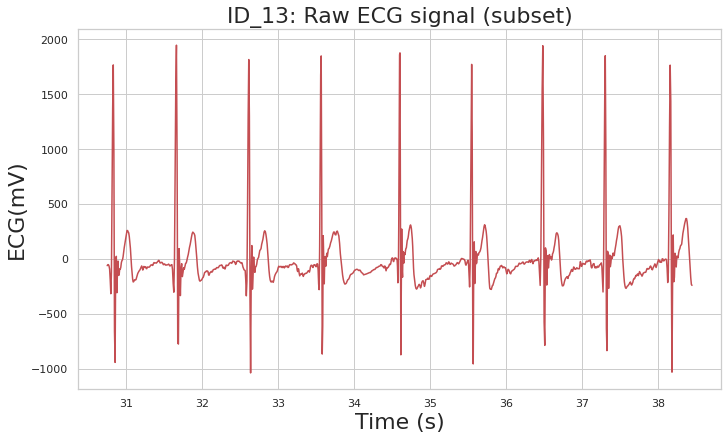

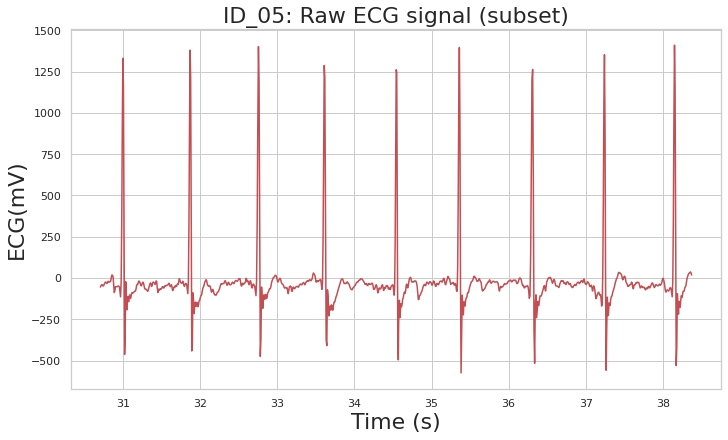

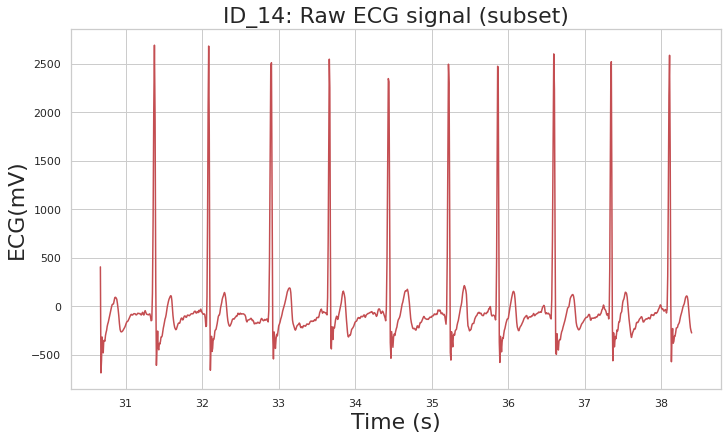

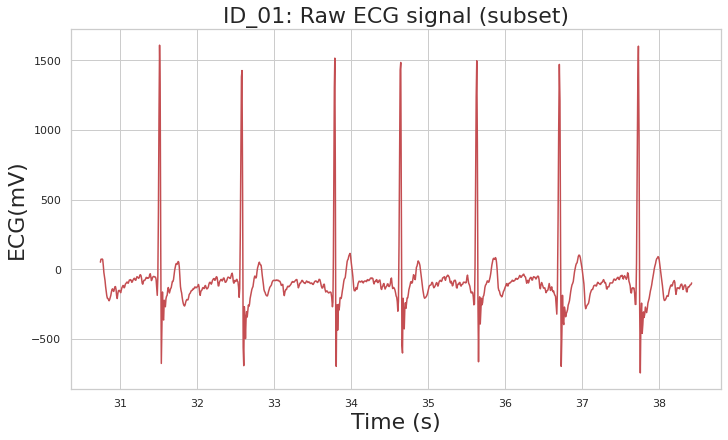

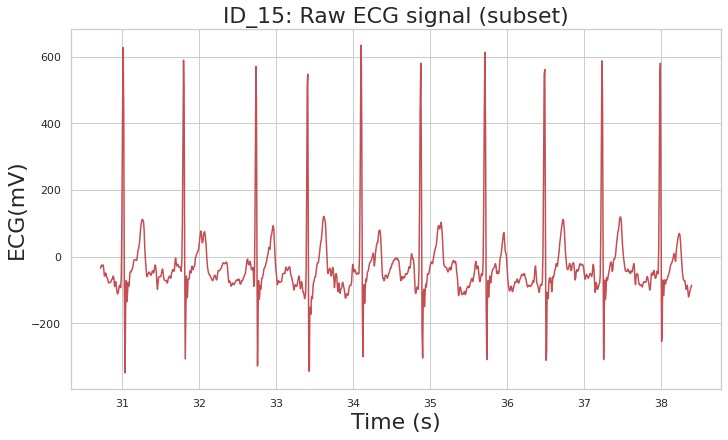

In [18]:
#ECG plot task (zoom)
ECG_plot_subj_zoom(data_task, is_raw = True, i = 4000, j = 5000)

# **ECG PRE-PROCESSING**


> **1.**  Calculation of sampling_rate (fs);


> **2.** interpolation;


> **3.** spectrum of raw ECG signals (for each subject);


> **4.** filtering
   - baseline wander removal;
   - normalization;
   - band pass filter.


> **5.** plot of filtered ECG signals (for each subject);


> **6.** spectrum of filtered ECG signals (for each subject);















**ECG DEVICE SAMPLING RATE**`

In [19]:
def sampling_rate(data_dict):
    
    fs_dict = {} 
    fs_min = float('inf')
    fs_max = 0

    for key, value in data_dict.items():
      
      timegrid_ecg = value[0]['ECG time grid']

      temp_ecg = np.zeros(shape = timegrid_ecg.size-1)
      
      for i in range(0, timegrid_ecg.size-1, 1):
        temp_ecg[i] = np.round(1/(timegrid_ecg[i+1] - timegrid_ecg[i]))

      #fs_ecg = np.round(np.mean(temp_ecg))
      fs_ecg = np.amax(temp_ecg)

      if fs_ecg > fs_max:
        fs_max = fs_ecg
      
      if fs_ecg < fs_min:
        fs_min = fs_ecg

      fs_dict[f'{key}'] = fs_ecg
    
    return fs_dict, fs_min, fs_max

In [20]:
# ECG rest
(fs_rest, fs_min_rest, fs_max_rest) = sampling_rate(data_rest)

# ECG task
(fs_task, fs_min_task, fs_max_task) = sampling_rate(data_task)

<ipython-input-19-0f0ef1736c83>:14: RuntimeWarning: divide by zero encountered in double_scalars
  temp_ecg[i] = np.round(1/(timegrid_ecg[i+1] - timegrid_ecg[i]))


**INTERPOLATION**

In [21]:
def interpolate_1D (data_dict, fs_new):

  data_dict_new = {}

  for key, value in data_dict.items():
    df_new = pd.DataFrame(columns = ['ECG time grid', 'raw ECG signal']) 

    data = np.array(value[0]['raw ECG signal'])
    time = np.array(value[0]['ECG time grid'])
    
    f = interpolate.interp1d(time, data)
    new_t = np.arange(0,time[-1], (1/fs_new))
    new_data = f(new_t)
    

    df_new['ECG time grid'] = new_t
    df_new['raw ECG signal'] = new_data

    data_dict_new[f'{key}'] = [df_new]

  return data_dict_new

In [22]:
# ECG rest
data_task_interpolated = interpolate_1D (data_task, fs_min_task)

In [23]:
# ECG task
data_rest_interpolated = interpolate_1D(data_rest, fs_min_rest)

**SPECTRUM OF RAW ECG SIGNALS**


In [24]:
def spectrum(data_dict, fs_data, is_raw):
  if is_raw:
    for key, value in data_dict.items():

      fs_ecg = fs_data
      
      signal_ecg = np.array(value[0]['raw ECG signal'])
      signal_ecg = signal_ecg - np.mean(signal_ecg) 

      n_ecg = signal_ecg.size

      X_ecg = fft.fft(signal_ecg)

      pow_spect_ecg = abs(X_ecg)**2/n_ecg

      #PLOT    
      timestep_ecg = 1/fs_ecg
      freq_ecg = np.fft.fftfreq(n_ecg, d=timestep_ecg)
      
      idx = key.rfind('_')
      name = key[:idx]

      plt.figure(figsize=(10,3))
      plt.title(f'{key}: ECG spectrum', fontsize = 20) 
      plt.plot(freq_ecg[:round(freq_ecg.size/2)],pow_spect_ecg[:round(pow_spect_ecg.size/2)])
      plt.grid(True)
      plt.xlabel ('Frequency [Hz]')

      plt.show()
    
  else:
    for key, value in data_dict.items():

      fs_ecg = fs_data
      
      signal_ecg = np.array(value[0]['ECG filtered'])
      signal_ecg = signal_ecg - np.mean(signal_ecg) 
      n_ecg = signal_ecg.size

      X_ecg = fft.fft(signal_ecg)

      pow_spect_ecg = abs(X_ecg)**2/n_ecg

      #PLOT    
      timestep_ecg = 1/fs_ecg
      freq_ecg = np.fft.fftfreq(n_ecg, d=timestep_ecg)
      
      idx = key.rfind('_')
      name = key[:idx]

      plt.figure(figsize=(10,3))
      plt.title(f'{key}: ECG spectrum of filtered data', fontsize = 20)
      plt.plot(freq_ecg[:round(freq_ecg.size/2)],pow_spect_ecg[:round(pow_spect_ecg.size/2)])
      plt.grid(True)
      plt.xlabel ('Frequency [Hz]')

      plt.show()
    

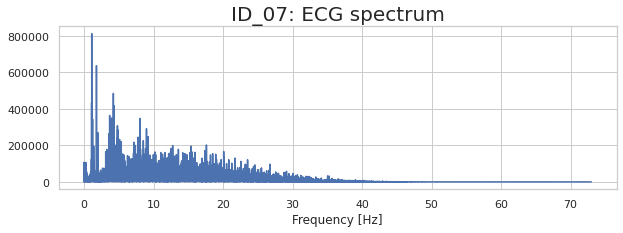

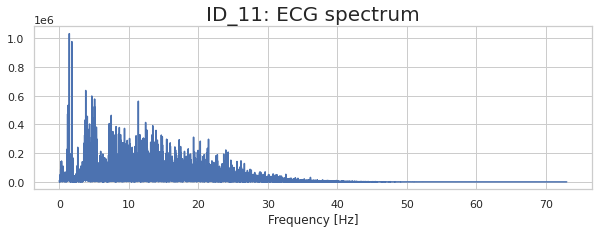

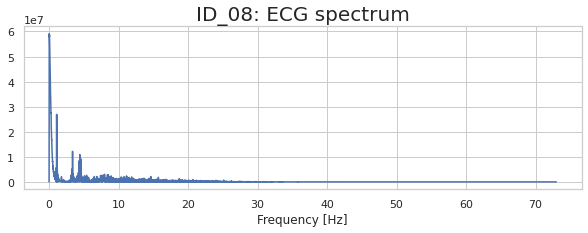

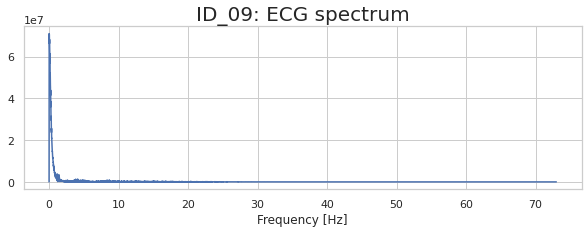

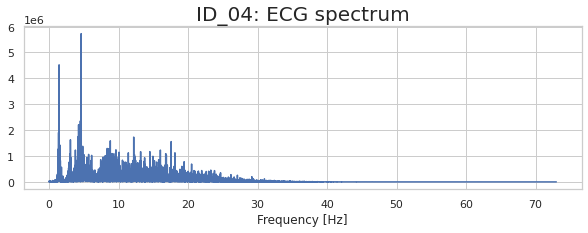

...

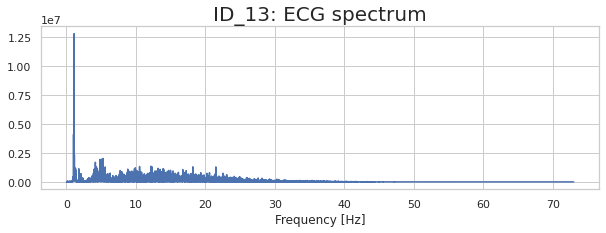

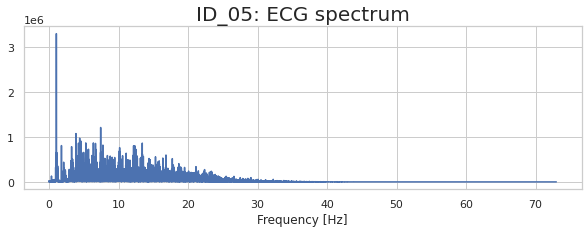

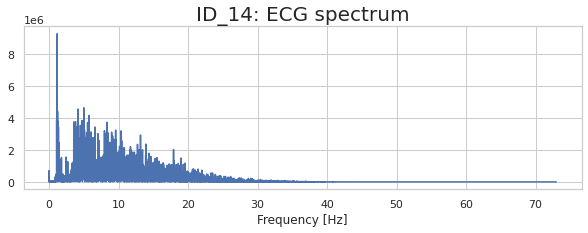

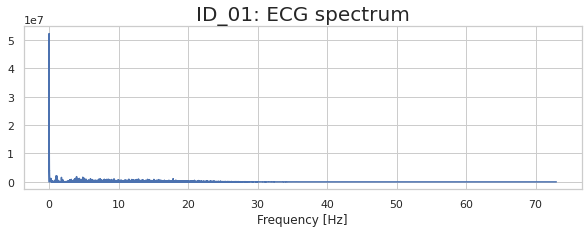

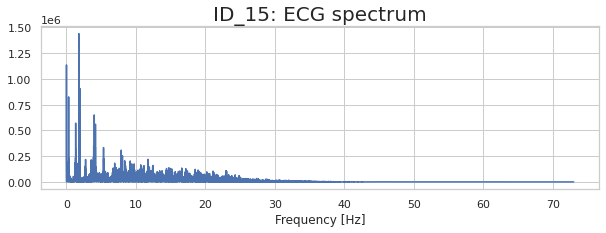

In [25]:
#Spectrum rest ECG data
spectrum(data_rest_interpolated, fs_min_rest, is_raw = True)

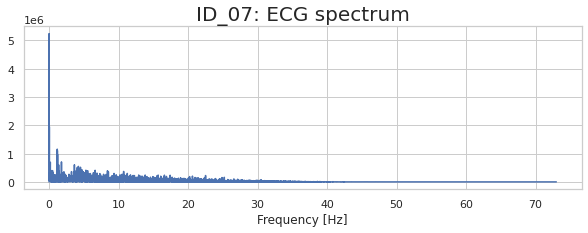

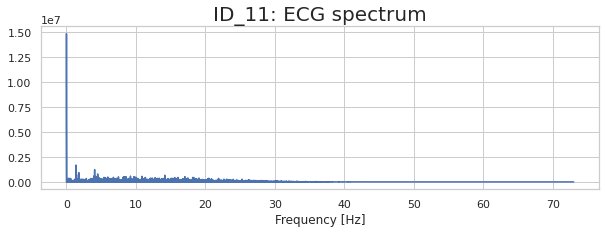

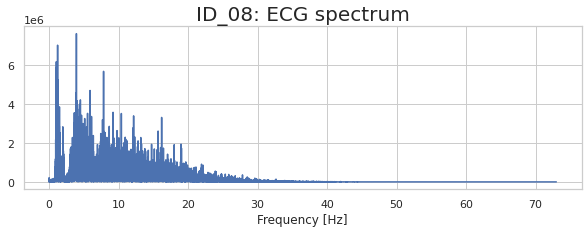

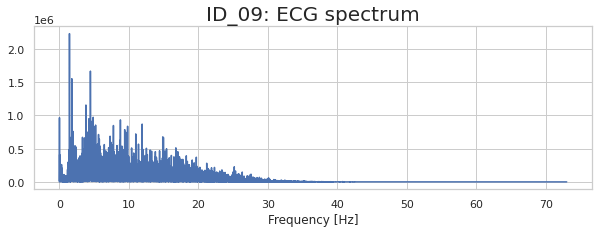

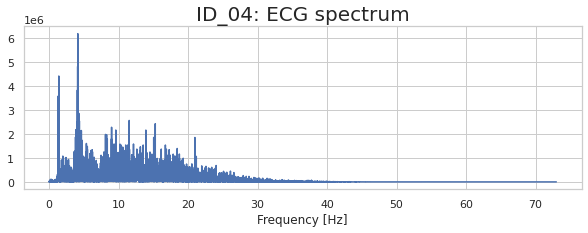

...

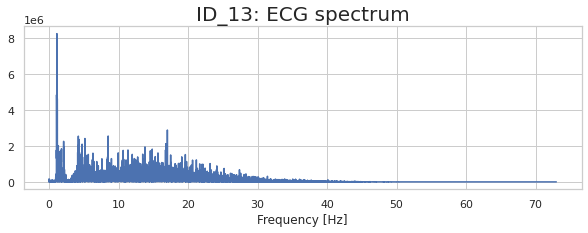

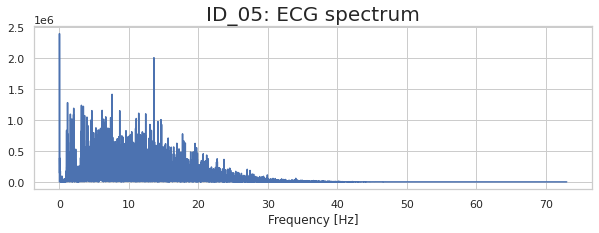

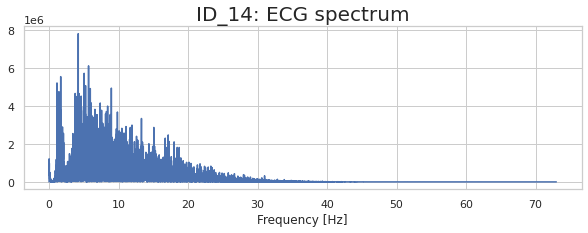

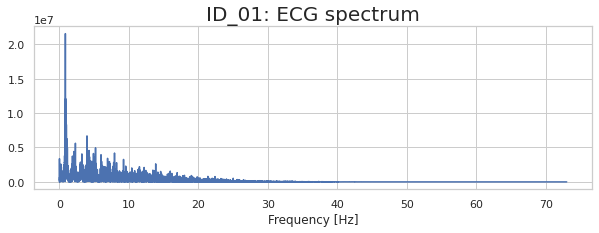

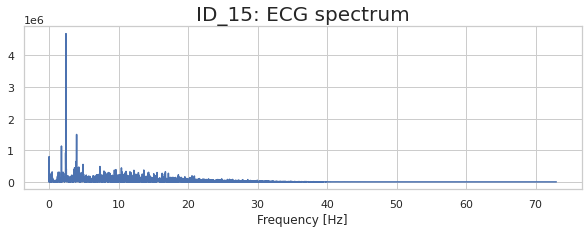

In [26]:
#Spectrum task ECG data
spectrum(data_task_interpolated, fs_min_task, is_raw = True)

**Filtering definition**

1. **BASELINE WANDER REMOVAL**

In [27]:
def baseline_wander_removal(data, fs): 
 
  ### FIRST WINDOW ###
  win_size = int(np.round(0.2 * fs))
  if win_size % 2 == 0:
    win_size = win_size + 1

  baseline = medfilt(data, win_size)

  ### SECOND WINDOW ###  
  win_size = int(np.round(0.6 * fs))
  if win_size % 2 == 0:
    win_size = win_size + 1

  baseline = medfilt(baseline, win_size)

  # Removing baseline
  filt_data = data - baseline

  return filt_data

2. **NORMALIZATION**

In [28]:
def normalize_data(data): 

  # Amplitude estimate
  norm_factor = np.percentile(data, 99) - np.percentile(data, 5)
  norm_data = np.array(data/norm_factor)

  return norm_data

3. **BAND_PASS FILTER FOR ECG**



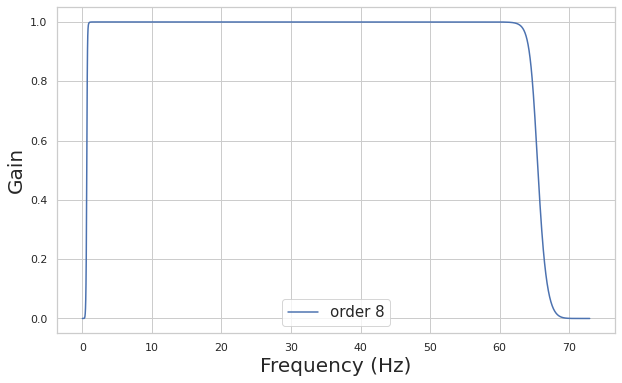

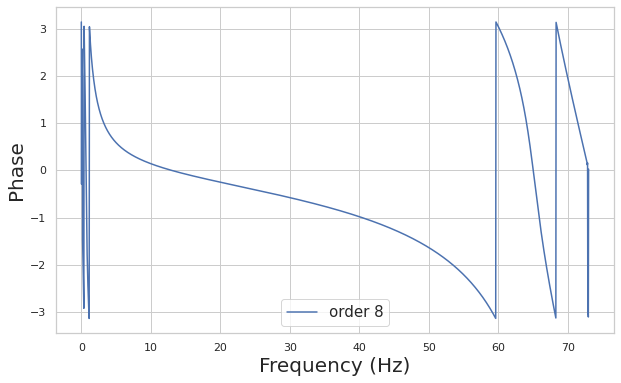

In [29]:
def butter_bandpass_filter(data, fs):

  lowcut = 0.667
  highcut = 65
  order = 8

  b, a = butter(order, [lowcut, highcut], fs = fs, btype='bandpass')
  filtered_data = filtfilt(b,a,data) #applica il filtro 

  return filtered_data


plt.figure(1, figsize=(10,6))
#plt.clf()

b, a = butter(8, [0.667, 65], fs=fs_min_task, btype ='bandpass')
w, h = freqz(b, a, fs=fs_min_task, worN=2000)

plt.plot(w, abs(h), label="order 8")
plt.xlabel('Frequency (Hz)', fontsize = 20)
plt.ylabel('Gain', fontsize = 20)
plt.grid(True)
plt.legend(loc='best', fontsize = 15)


plt.figure(2, figsize=(10,6))
b, a = butter(8, [0.667, 65], fs=fs_min_task, btype ='bandpass')
w, h = freqz(b, a, fs=fs_min_task, worN=2000)
plt.plot(w, np.angle(h), label="order 8")

plt.xlabel('Frequency (Hz)', fontsize = 20)
plt.ylabel('Phase', fontsize = 20)
plt.grid(True)
plt.legend(loc='best', fontsize = 15)

In [30]:
## Plot the frequency response for a few different orders##

# fs = fs_min_task 
# plt.figure(1, figsize=(10,6))
# #plt.clf()

# for order in [3, 6, 8]:
#   b, a = butter(order, [0.667, 65], fs=fs, btype ='bandpass')
#   w, h = freqz(b, a, fs=fs, worN=2000)

#   plt.plot(w, abs(h), label="order = %d" % order)
#   plt.xlabel('Frequency (Hz)', fontsize = 20)
#   plt.ylabel('Gain', fontsize = 20)
#   plt.grid(True)
#   plt.legend(loc='best', fontsize = 15)


# plt.figure(2, figsize=(10,6))
# for order in [3, 6, 8]:
#   b, a = butter(order, [0.667, 65], fs=fs, btype ='bandpass')
#   w, h = freqz(b, a, fs=fs, worN=2000)
#   plt.plot(w, np.angle(h), label="order = %d" % order)

#   plt.xlabel('Frequency (Hz)', fontsize = 20)
#   plt.ylabel('Phase', fontsize = 20)
#   plt.grid(True)
#   plt.legend(loc='best', fontsize = 15)

**Filtering application**

In [31]:
## PRE PROCESSING FUNCTION DEFINITION FOR ECG

def preprocessing_ecg (data_dict, fs_data):
  fs_min = fs_data
  for key, value in data_dict.items():
    data = value[0]['raw ECG signal']

    data = baseline_wander_removal(data, fs = fs_min)
    data_dict[f'{key}'][0]['ECG after baseline'] = data

    data = normalize_data (data)
    data_dict[f'{key}'][0]['ECG normalized'] = data

    data_clean = butter_bandpass_filter (data, fs = fs_min)
    data_dict[f'{key}'][0]['ECG filtered'] = data_clean

**Application of the pre-processing steps for all the ECG Signal**

In [32]:
## ECG PRE PROCESSING APPLICATION ON REST ECG
preprocessing_ecg(data_rest_interpolated, fs_data= fs_min_rest)

In [33]:
## ECG PRE PROCESSING APPLICATION ON TASK ECG
preprocessing_ecg(data_task_interpolated, fs_data= fs_min_task)

**PLOT FILTERED SIGNAL**



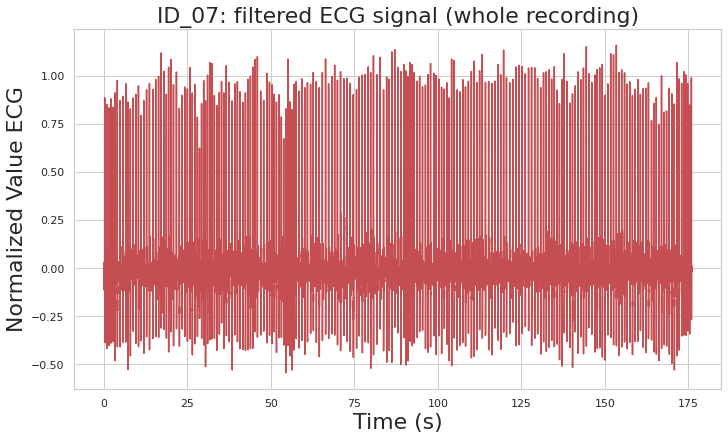

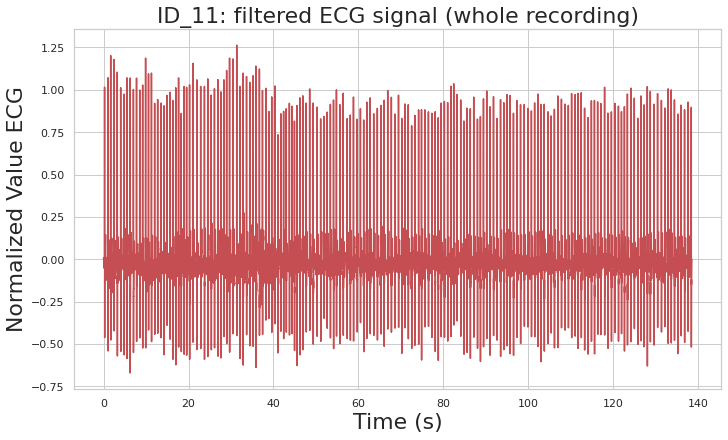

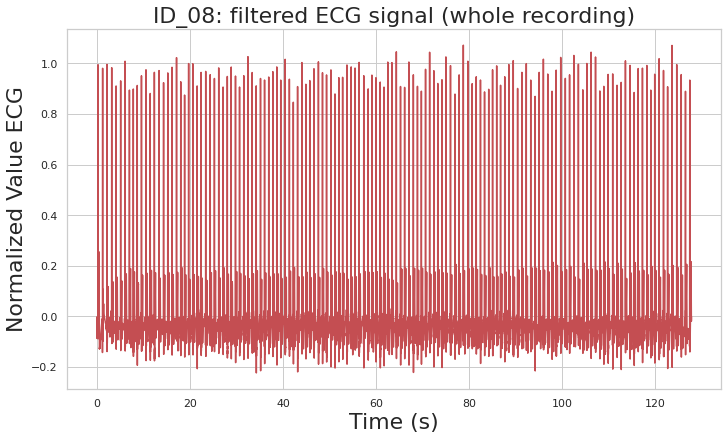

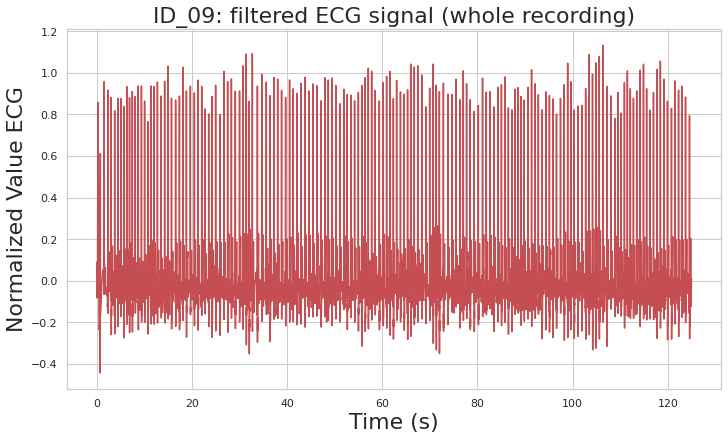

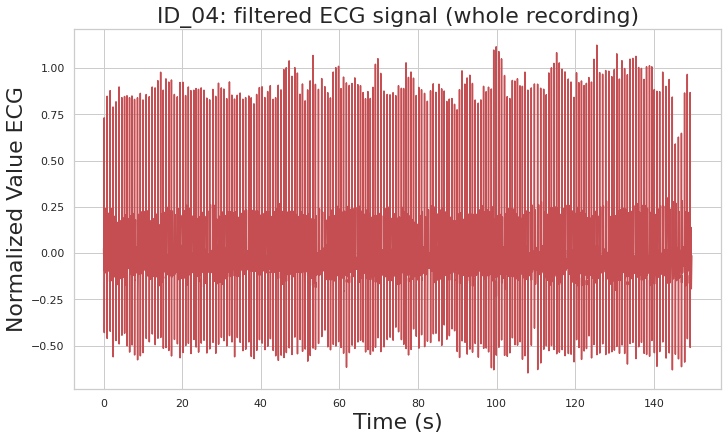

...

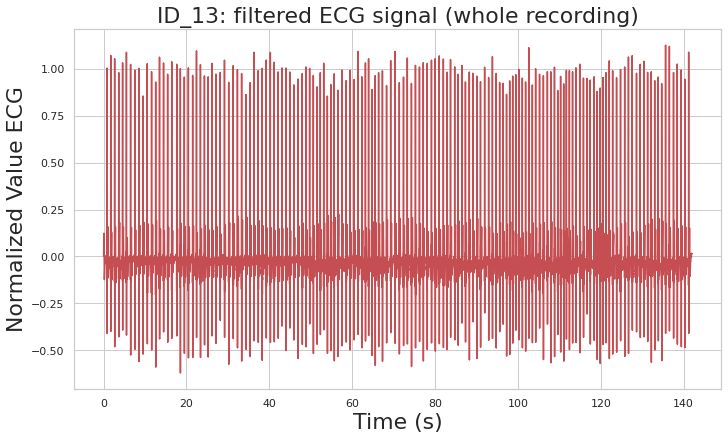

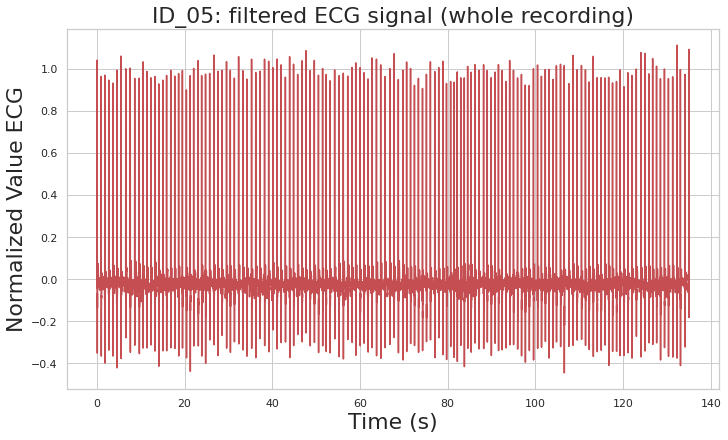

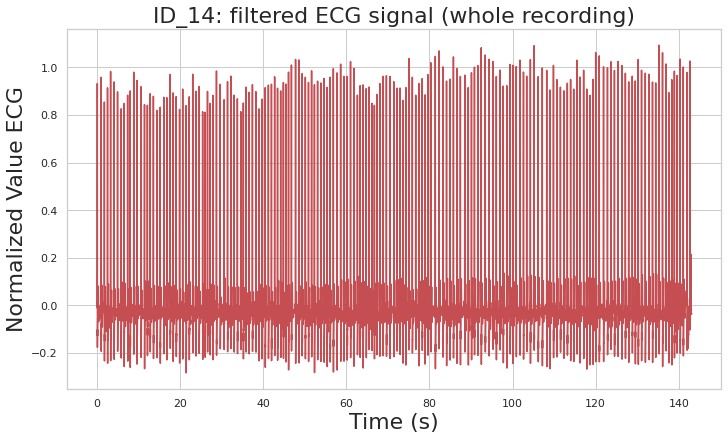

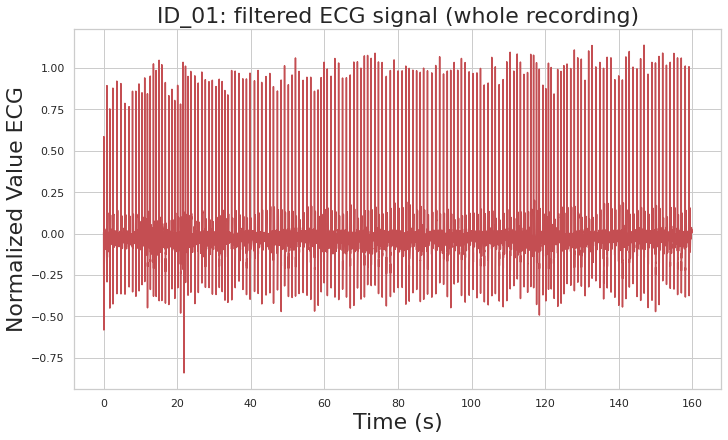

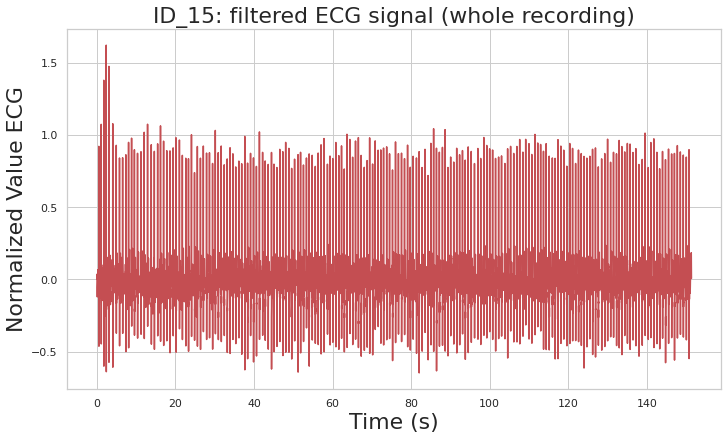

In [34]:
#ECG plot rest
ECG_plot_subj(data_rest_interpolated, is_raw = False)

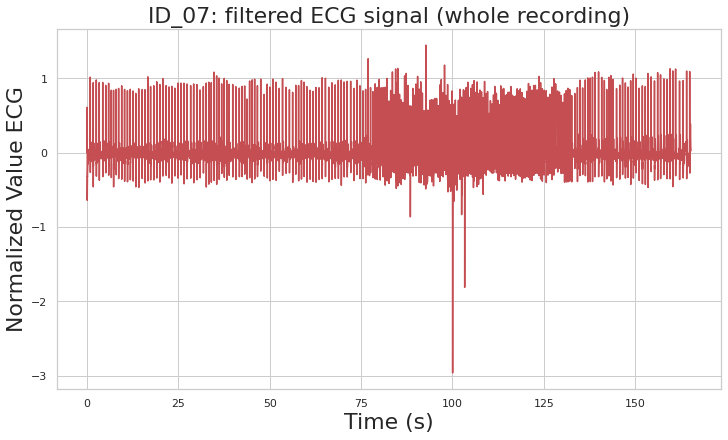

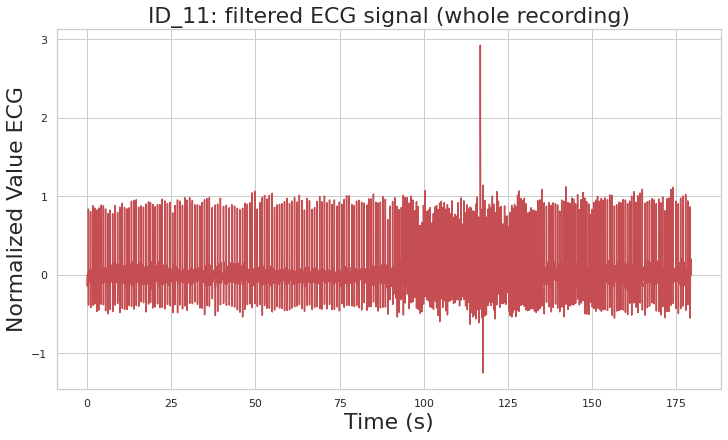

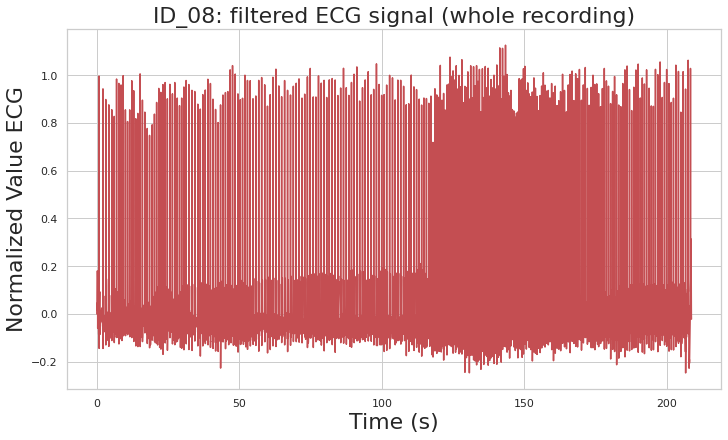

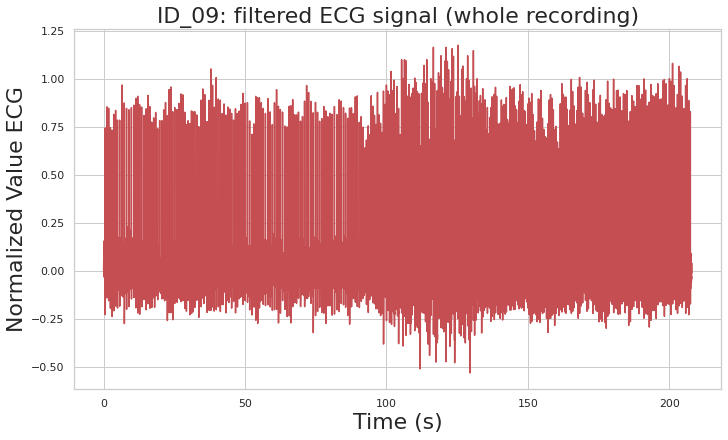

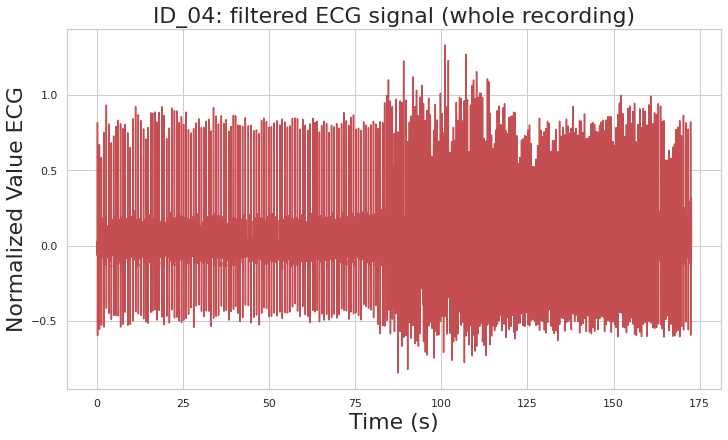

...

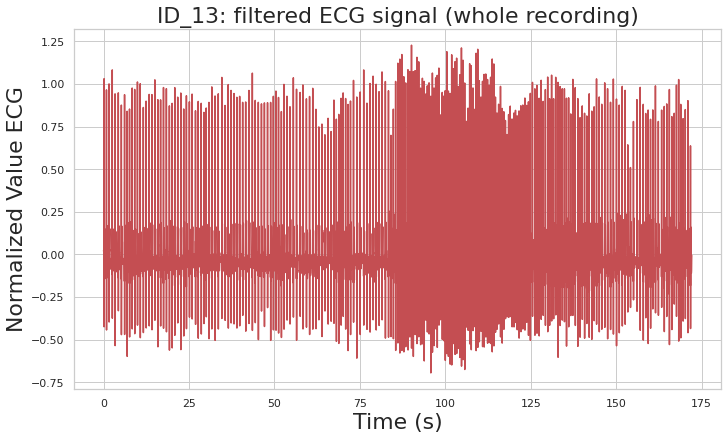

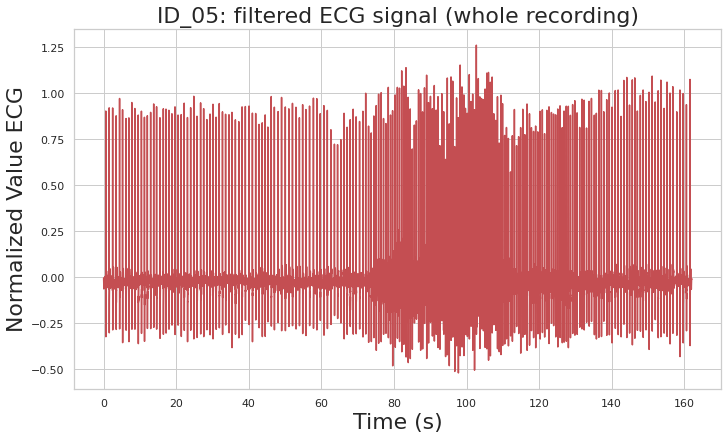

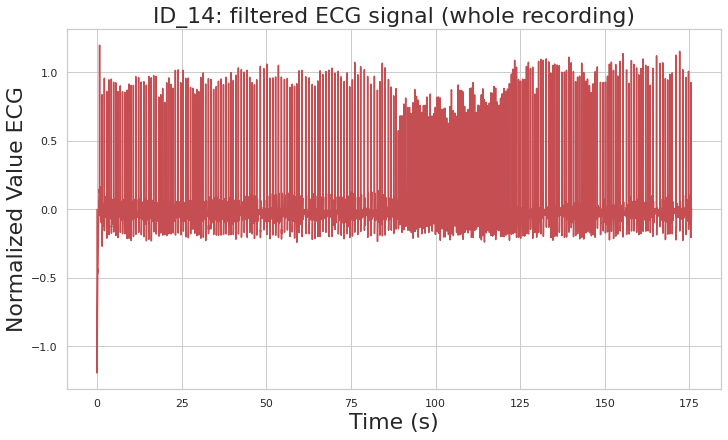

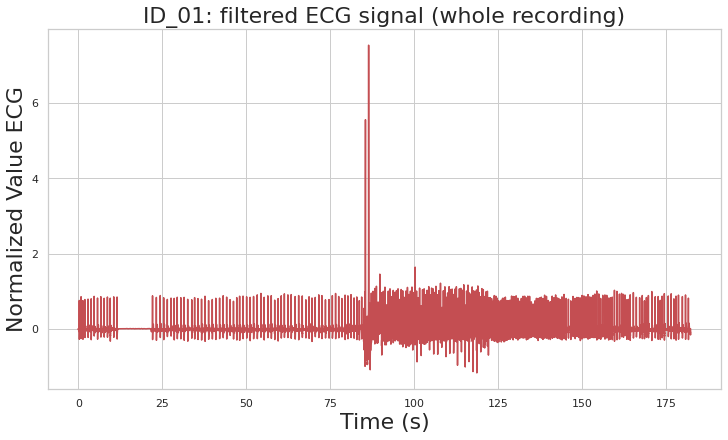

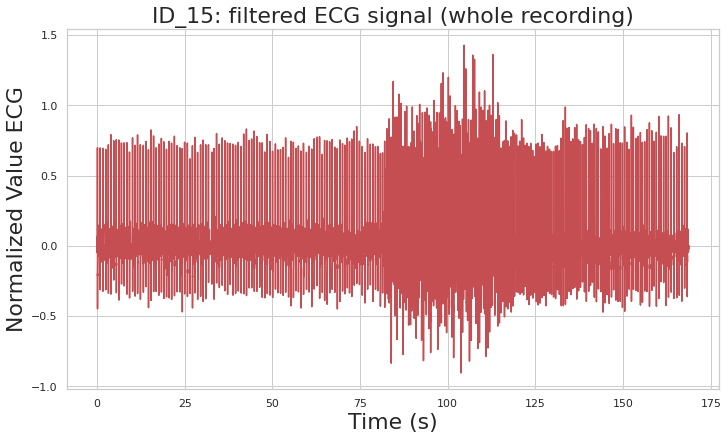

In [35]:
#ECG plot task
ECG_plot_subj(data_task_interpolated, is_raw = False)

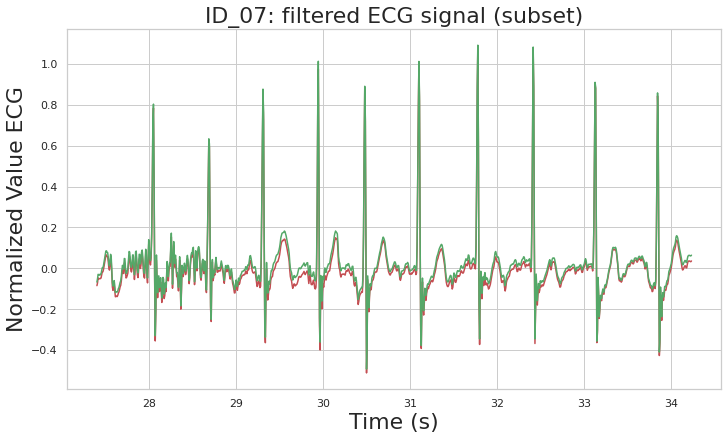

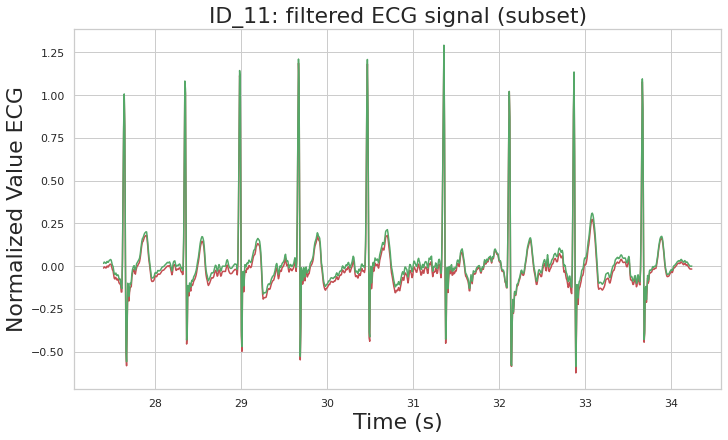

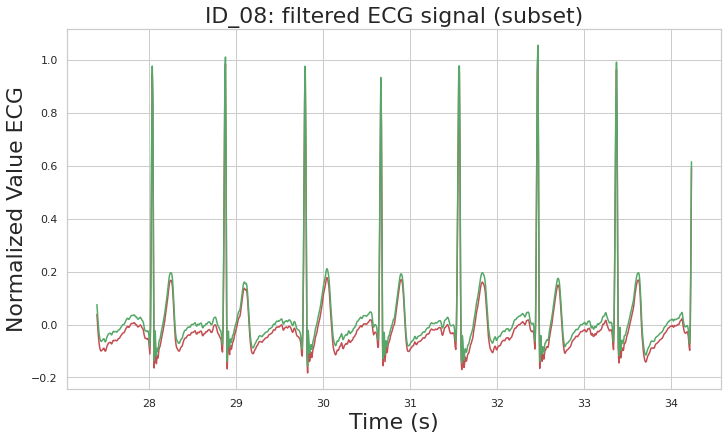

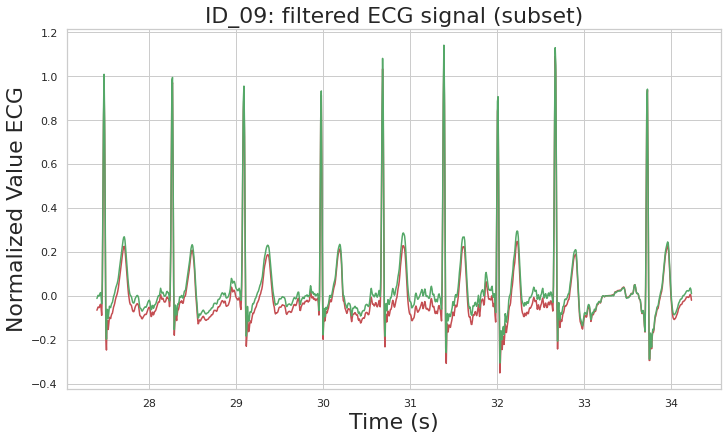

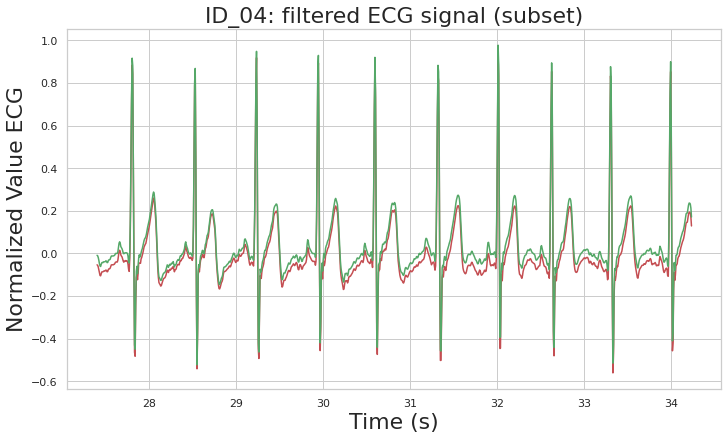

...

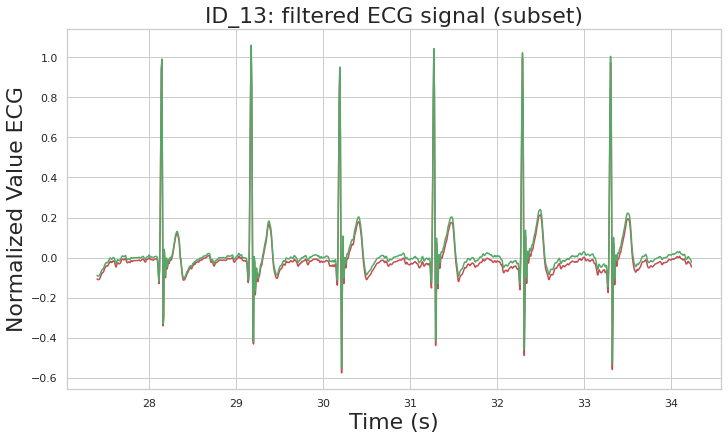

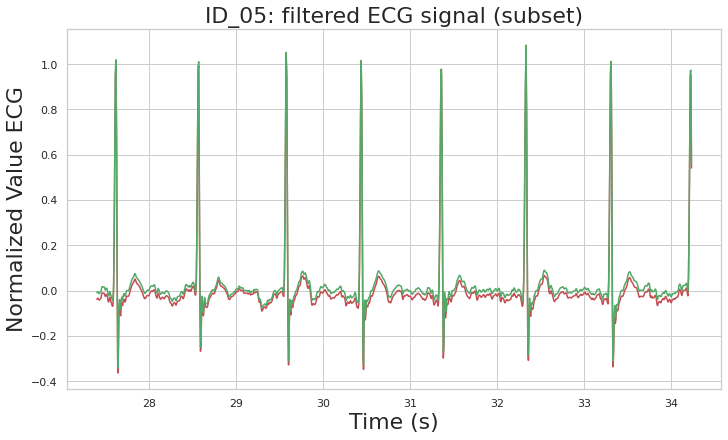

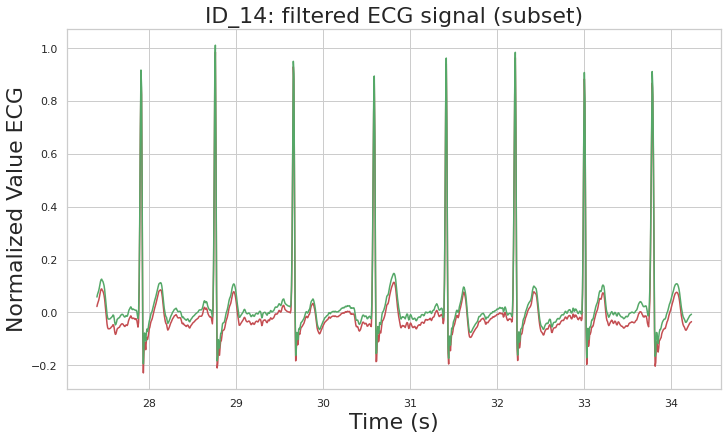

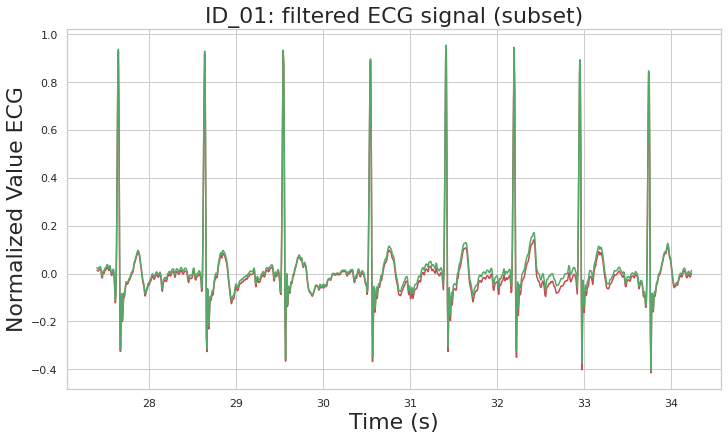

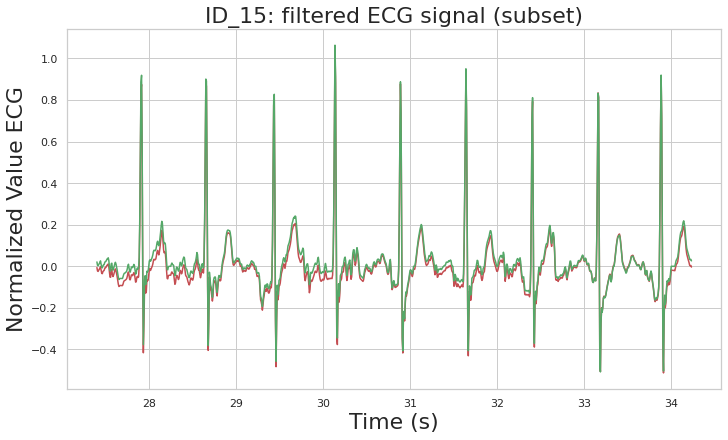

In [36]:
#ECG plot rest (zoom)
ECG_plot_subj_zoom(data_rest_interpolated, is_raw = False, i = 4000, j = 5000)

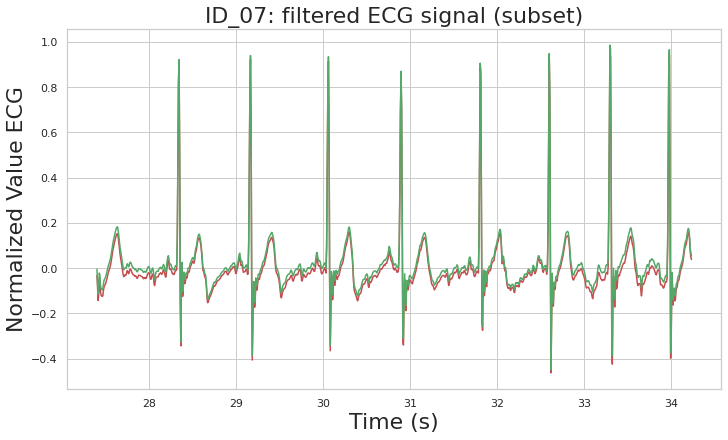

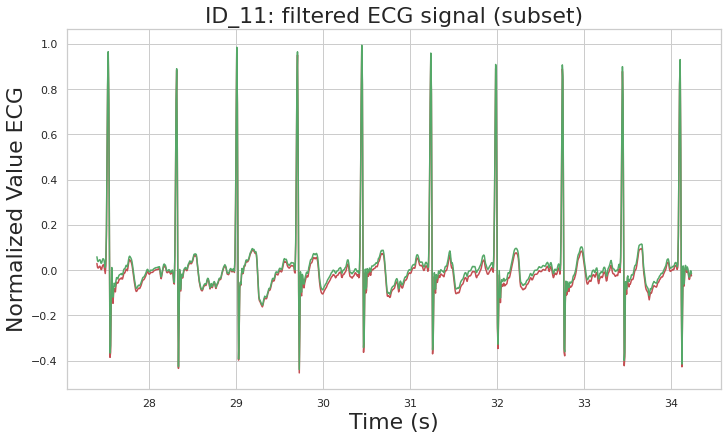

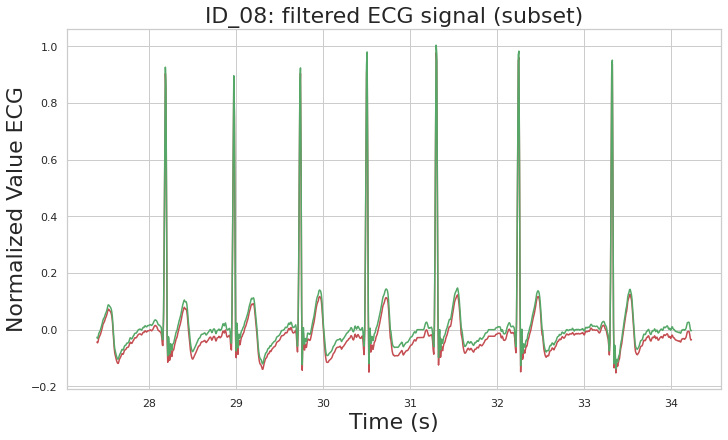

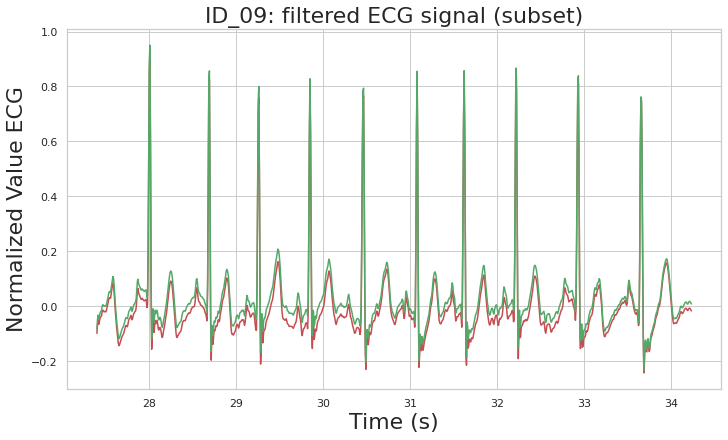

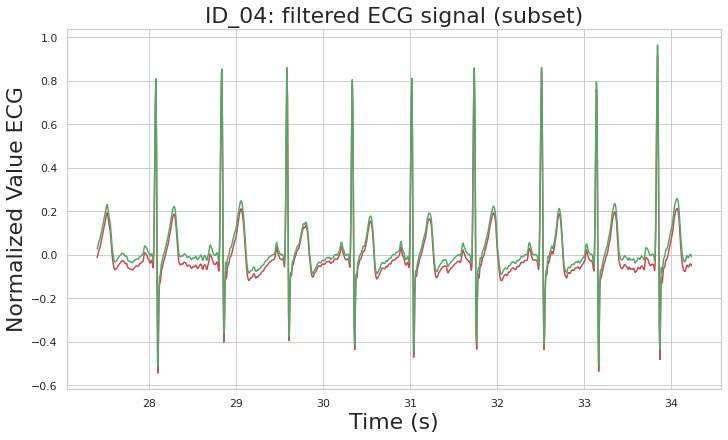

...

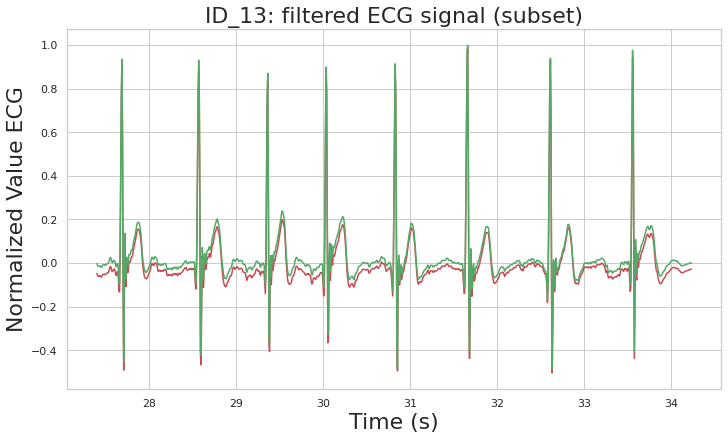

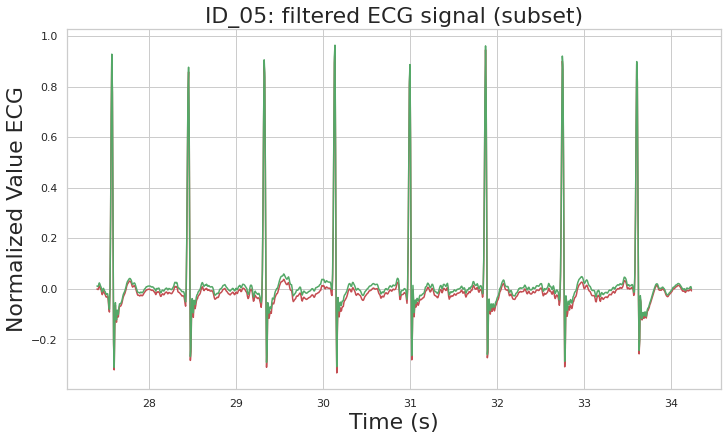

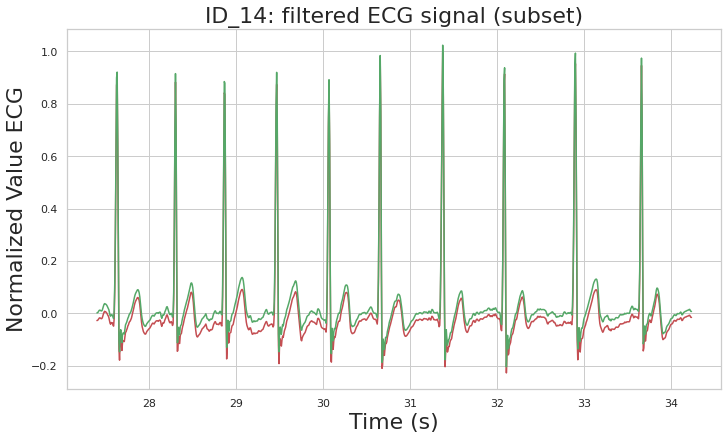

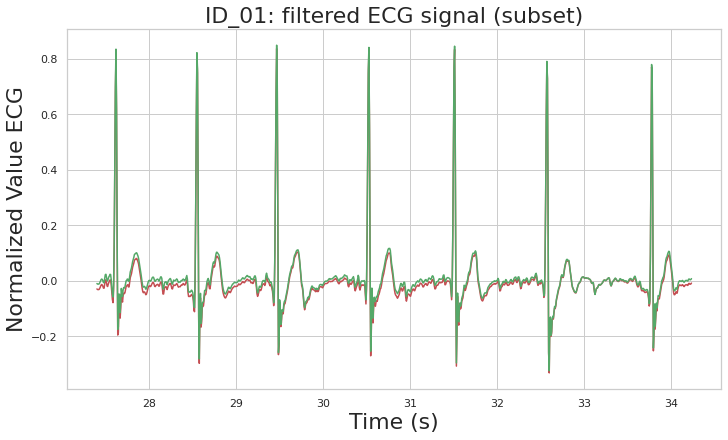

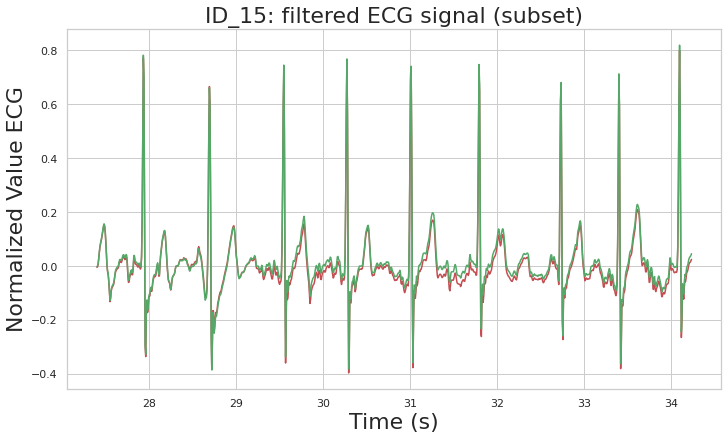

In [37]:
#ECG plot task (zoom)
ECG_plot_subj_zoom(data_task_interpolated, is_raw = False, i = 4000, j = 5000)

**VISUALIZING SPECTRUM AFTER FILTERING** 

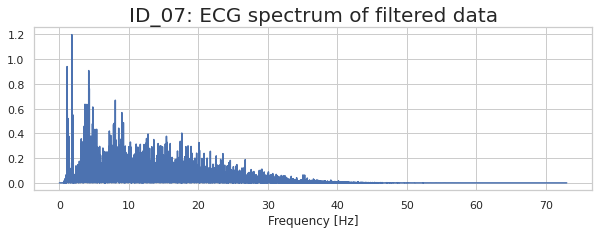

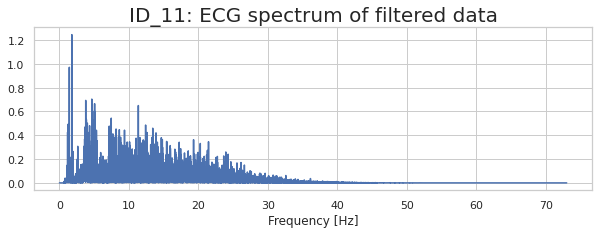

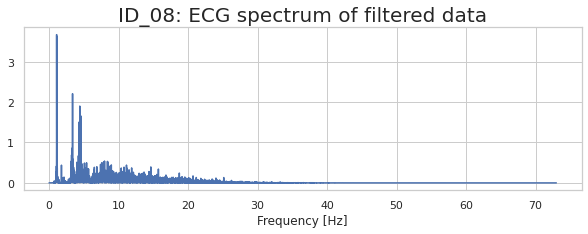

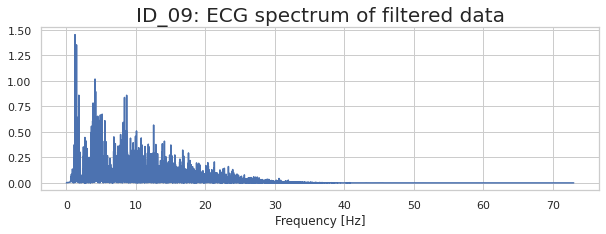

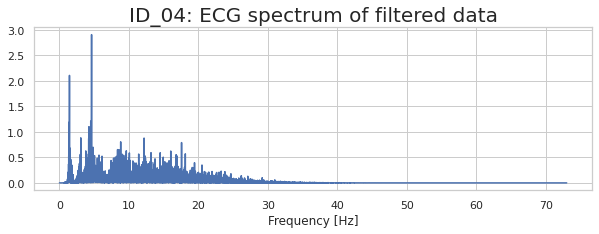

...

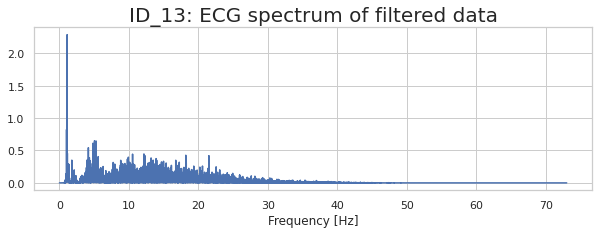

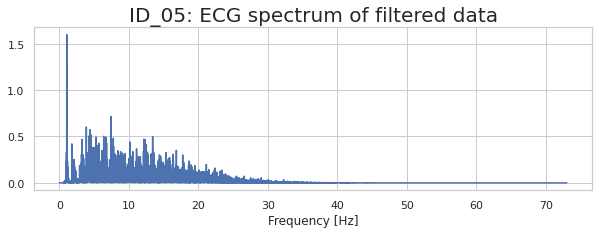

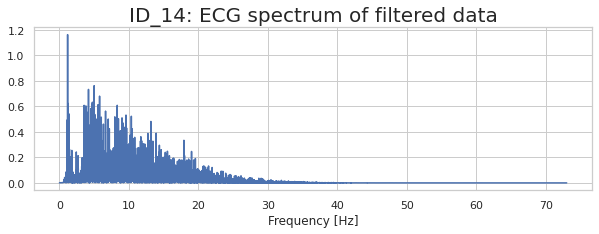

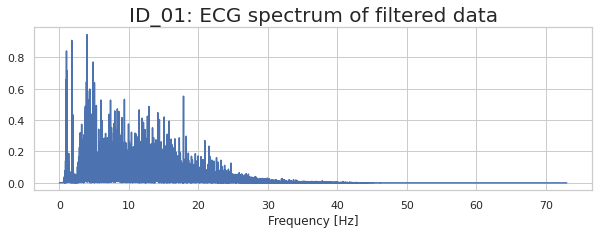

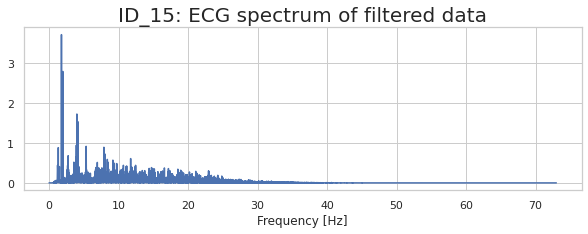

In [38]:
#Spectrum rest ECG data (filtered)
spectrum(data_rest_interpolated, fs_min_rest, is_raw = False)

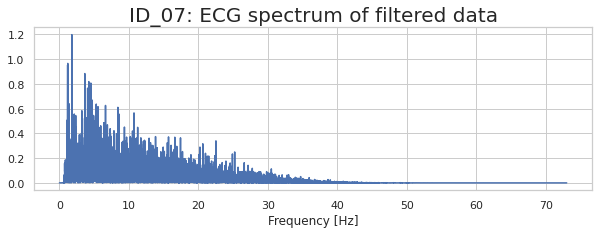

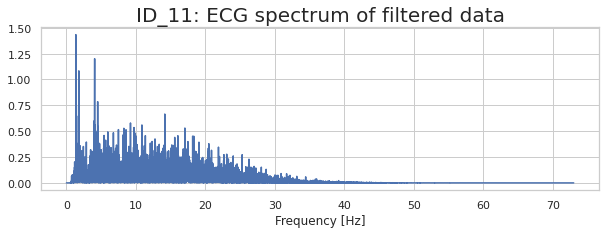

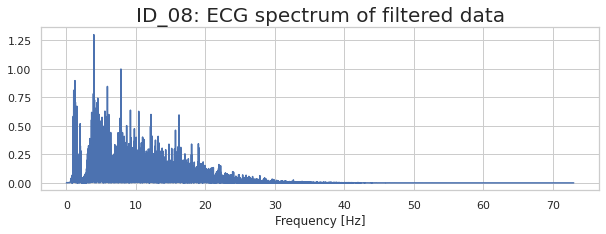

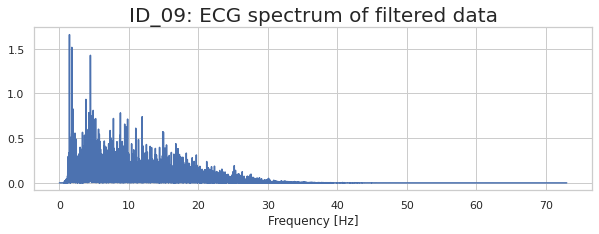

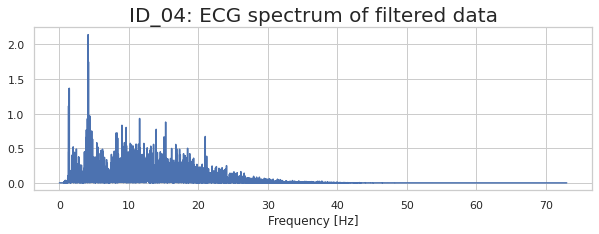

...

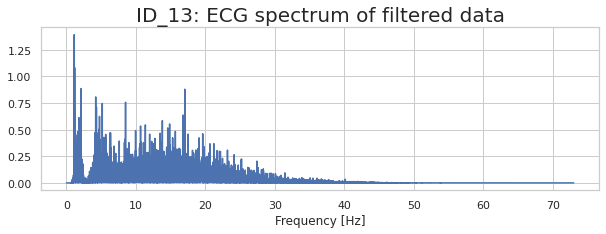

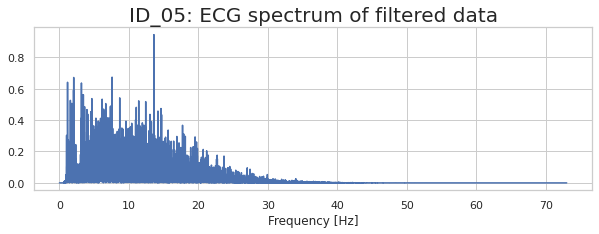

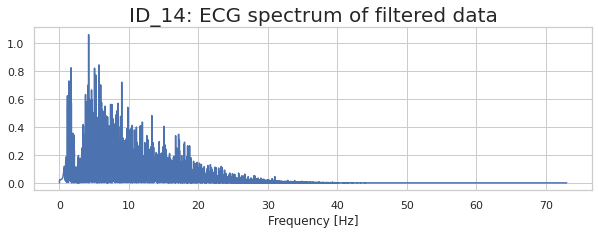

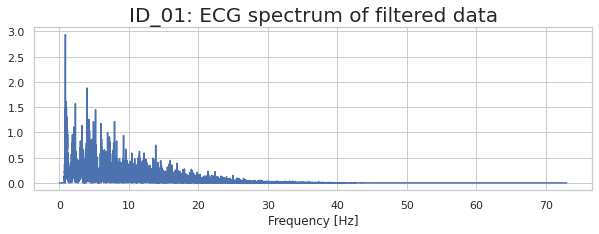

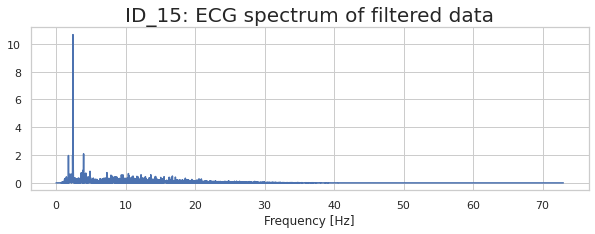

In [39]:
#Spectrum task ECG data (filtered)
spectrum(data_task_interpolated, fs_min_task, is_raw = False)

# **ECG SEGMENTATION**


> **1.** ECG segmentation for each subject;


> **2.** ECG segments cleaning;


> **3.** plot of the ECG segments after cleaning;


> **4.** moving average;


> **5.** segments concatenation;





In [40]:
def segment_ECG(data_dict, fs_data, word_len = 100): 
    
    segment_dict = {} 

    for cls, (k, v) in enumerate(data_dict.items()):
     
      key, value = (k,v)
      
      fs = fs_data 
      ecg_signal = np.array(value[0]['ECG filtered']) 
      
      detectors = Detectors(fs)
      r_peaks = detectors.two_average_detector(np.squeeze(ecg_signal))
      
      ecg_matrix = []
      original_len = []
      
      for i in range(len(r_peaks)-1):
        ecg_segment = np.array((ecg_signal[r_peaks[i]:r_peaks[i+1]]).reshape(1,-1)[0])
        original_len.append(len(ecg_segment))
        ecg_word = resample(ecg_segment, num = word_len)
        ecg_matrix.append(ecg_word)

      ecg_matrix = np.array(ecg_matrix)
      label = np.full((ecg_matrix.shape[0],), fill_value=cls)

      plt.figure(constrained_layout=True, figsize=(10,6))
      plt.title(f'{key} Segmented filtered ECG', fontsize = 22)
      plt.plot(ecg_matrix.T)
      plt.grid(True)

      plt.xlabel('Sample', fontsize = 20)
      plt.ylabel('ECG normalized', fontsize = 20)
      plt.show()

      segment_dict[f'{key}'] = [ecg_matrix, label] 

    return segment_dict

##**Data Rest Segmentation**

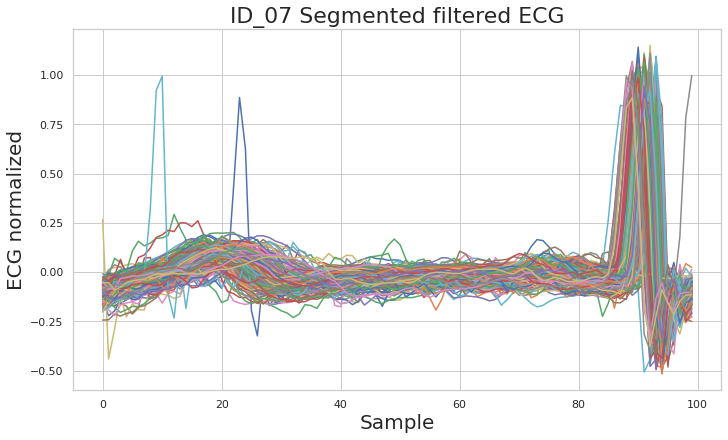

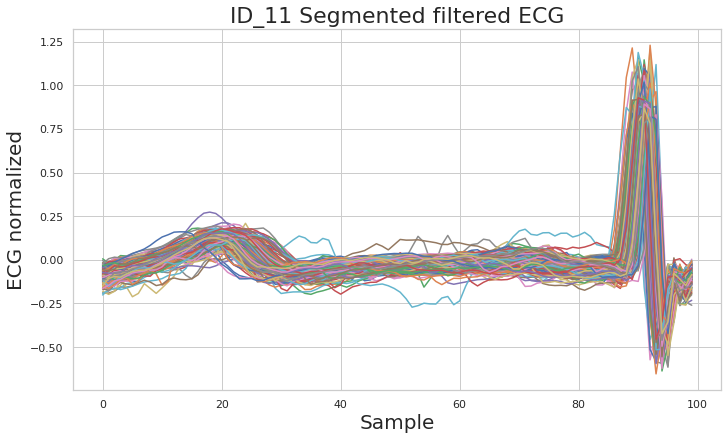

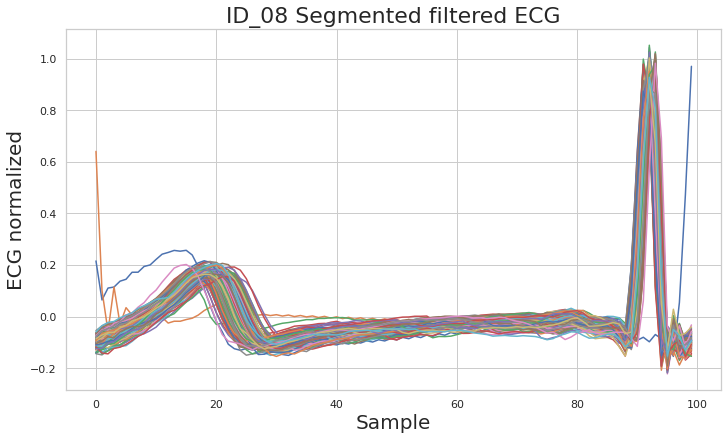

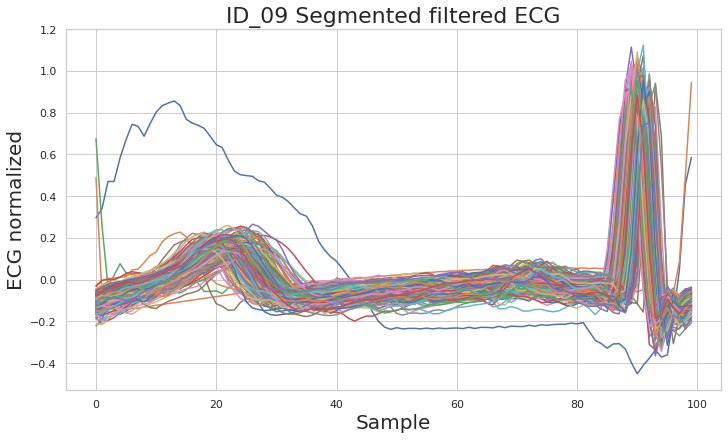

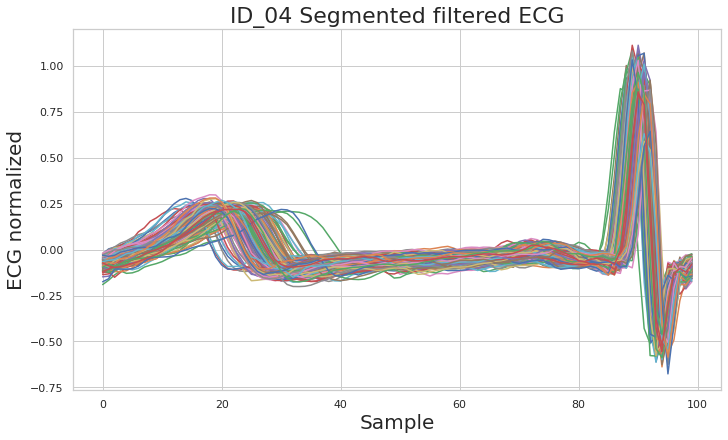

...

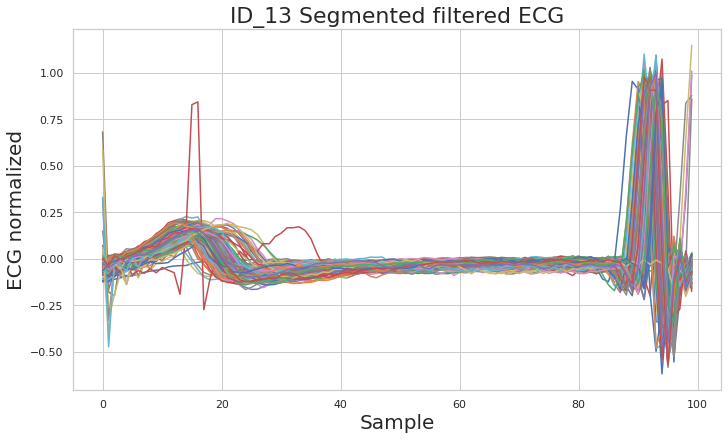

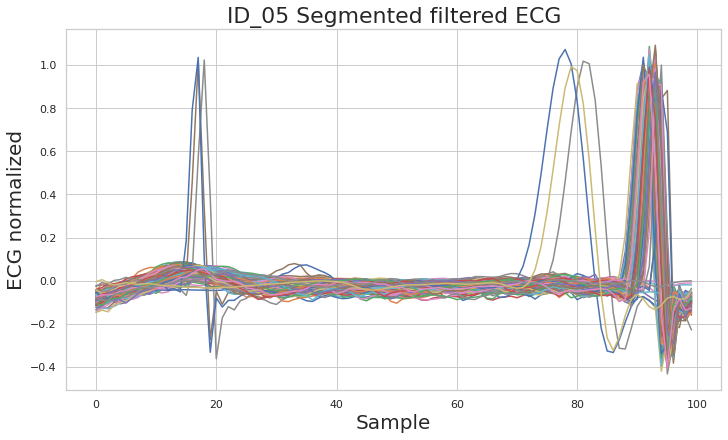

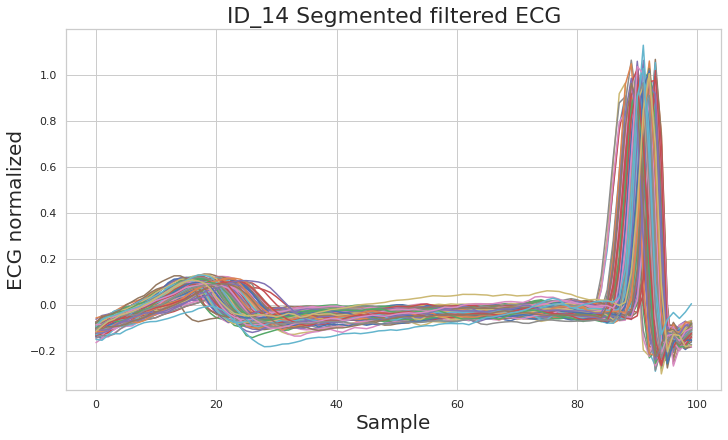

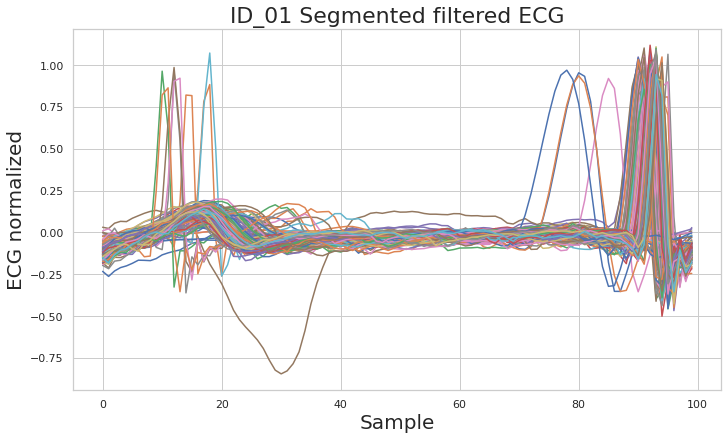

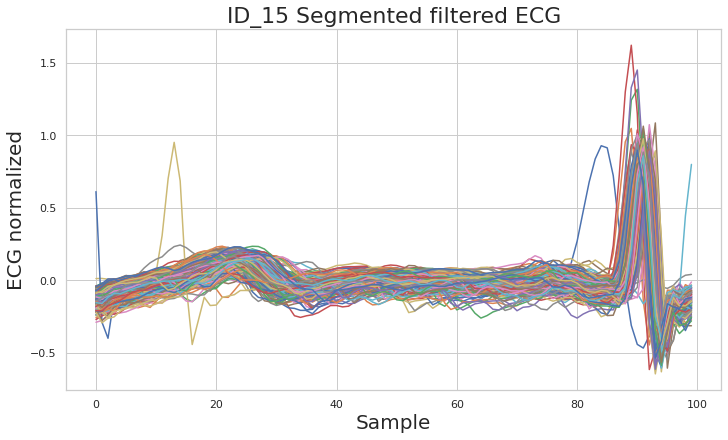

In [41]:
# ECG rest segmentation
segments_rest = segment_ECG(data_rest_interpolated, fs_min_rest, word_len = 100) 

##**Data Task Segmentation**

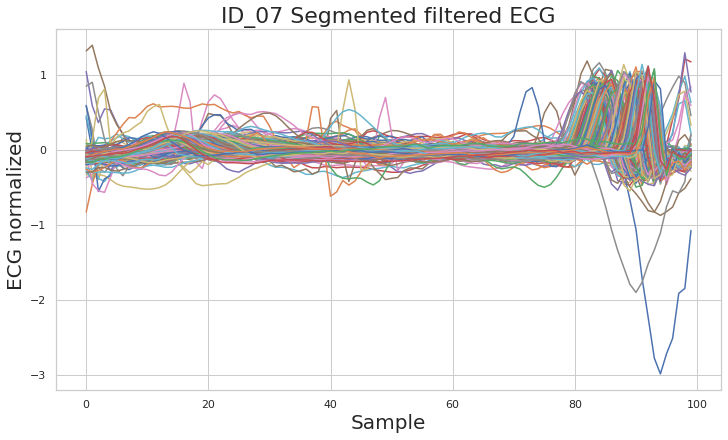

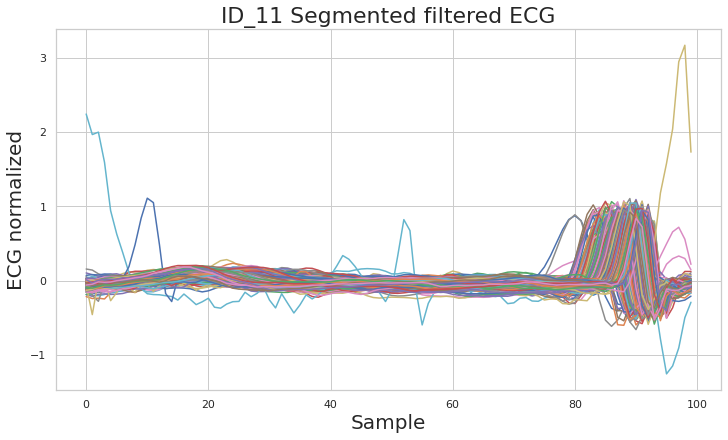

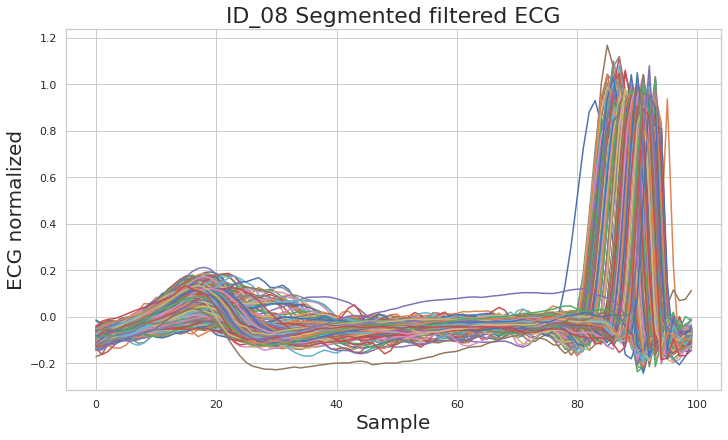

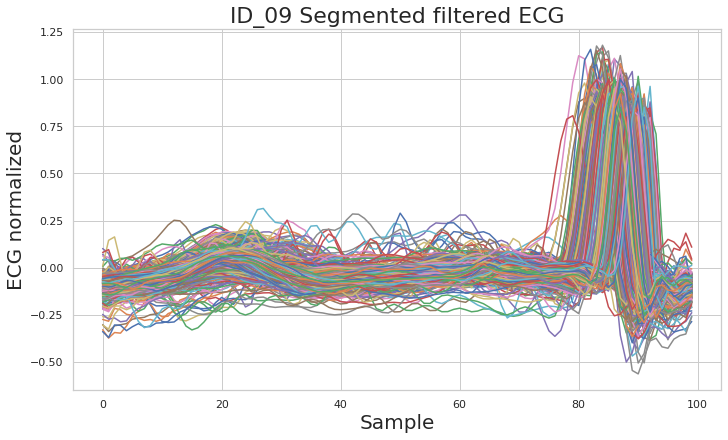

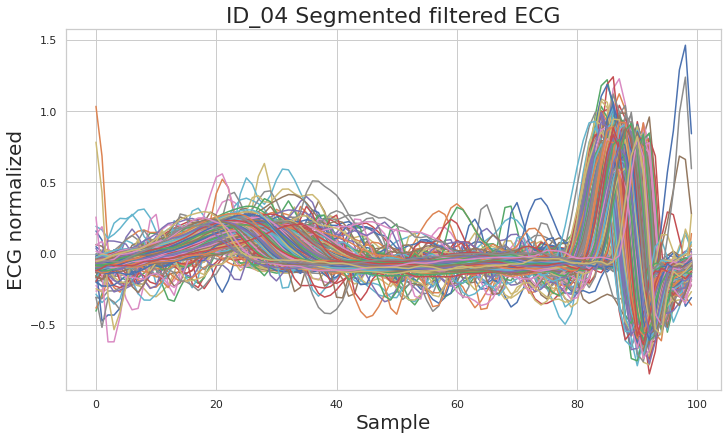

...

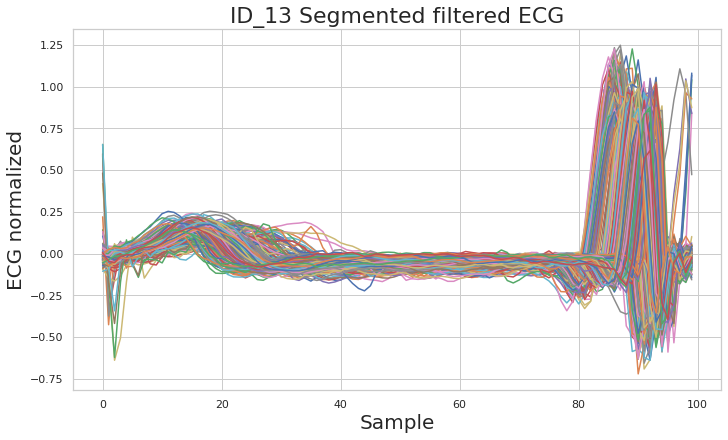

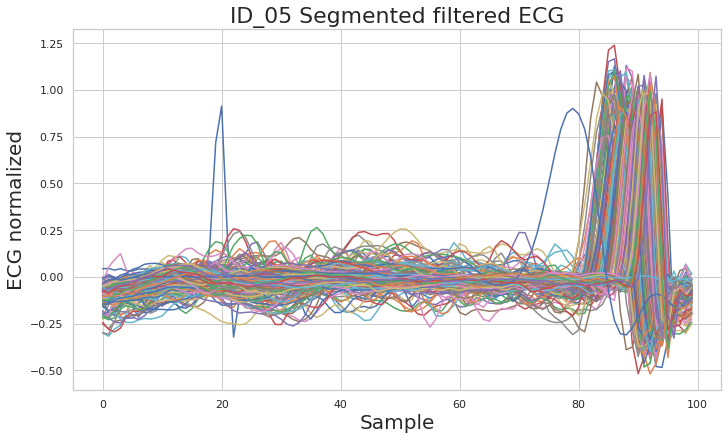

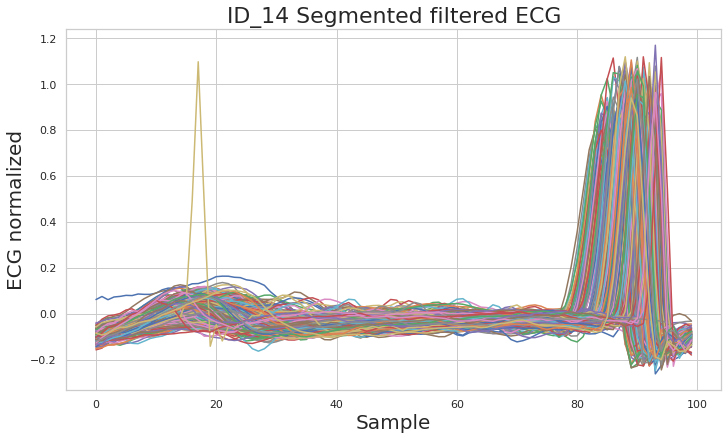

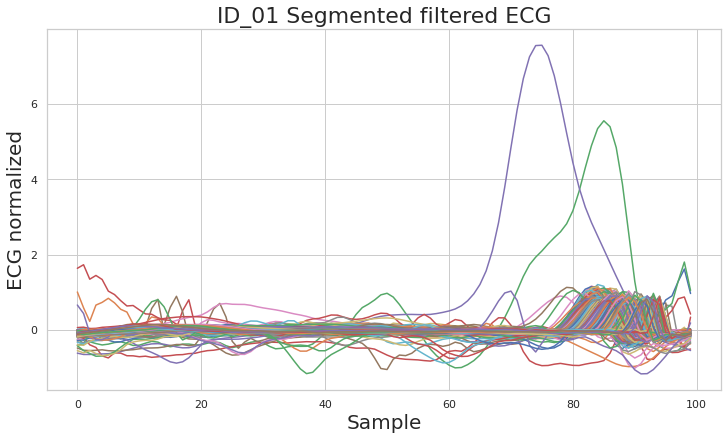

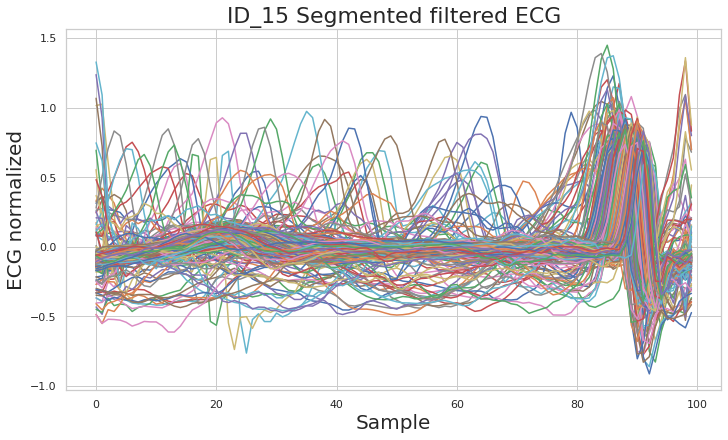

In [42]:
# ECG task segmentation
segments_task = segment_ECG(data_task_interpolated, fs_min_task, word_len = 100) 

##**Cleaning Segments, Definiton**

Bad segments were identify as segments with data points with outliers, compared to good segmented data.

In [43]:
def detect_outliers(data, th):
  threshold = th
  outlier = False
  for k in range(0, len(data), 1):
    # print(data[k])
    if abs(data[k]) > threshold:
      
      outlier = True
      break

  return outlier

Dividing the segment in 2 section: from 0 to 79 samples, the value muste be lower than *th = 0.5*; from 80 to the end, the value must be lower than *th=1.3*

In [44]:
def clean_segments (data_segment):
  
  for key, value in data_segment.items(): 
    
    segments_aux = (value[0]) 
    label_aux = (value[1]) 

    flag = False
    position = ()

    for i in range(0, segments_aux.shape[0] - 1, 1):

      start1 = 0
      stop1 = 79
      seg_aux1 = segments_aux [i,start1:stop1] 

      start2 = 80
      stop2 = 99
      seg_aux2 = segments_aux [i,start2:stop2] 

      # First condition for the first parts of the segments
      outlier1 = detect_outliers(seg_aux1, th = 0.5) 

      # Second condition for the last parts of the segments
      outlier2 = detect_outliers(seg_aux2, th = 1.3)

      # if otuliers were found, save the index of the segment
      if (outlier1 == True) or (outlier2 == True) :
        position = np.append(position, i) 

        flag = True
       
    if flag == False:
      print(f'{key}: NO BAD SEGMENTS ARE FOUND THROUGH {(segments_aux.shape[0])} SEGMENTS' ) 

    if flag == True: 
      position = position.astype(int) #
      position = position [::-1] #
      
      print(f'{key}: {len(position)}/{(segments_aux.shape[0])} BAD SEGMENTS ARE FOUND ---- {position}')

      ## CLEANING STEP ##

      for index in position: 
        data_segment[f'{key}'][0] = np.delete(data_segment[f'{key}'][0], index, axis = 0) # clean segment 'i'
        data_segment[f'{key}'][1] = np.delete(data_segment[f'{key}'][1], index, axis = 0) # clean relative Label
        


      print('\n')
      print(f'All bad segments of {key} are removed')
    
    print('\n \n')

##**Cleaning application Rest Dataset**

In [45]:
# Clean ECG rest segments
clean_segments(segments_rest)

ID_07: 2/219 BAD SEGMENTS ARE FOUND ---- [189   0]


All bad segments of ID_07 are removed

 

ID_11: NO BAD SEGMENTS ARE FOUND THROUGH 179 SEGMENTS

 

ID_08: 1/140 BAD SEGMENTS ARE FOUND ---- [1]


All bad segments of ID_08 are removed

 

ID_09: 2/165 BAD SEGMENTS ARE FOUND ---- [2 0]


All bad segments of ID_09 are removed

 

ID_04: NO BAD SEGMENTS ARE FOUND THROUGH 214 SEGMENTS

 

ID_10: 1/170 BAD SEGMENTS ARE FOUND ---- [46]


All bad segments of ID_10 are removed

 

ID_12: NO BAD SEGMENTS ARE FOUND THROUGH 162 SEGMENTS

 

ID_02: 2/142 BAD SEGMENTS ARE FOUND ---- [77 59]


All bad segments of ID_02 are removed

 

ID_06: NO BAD SEGMENTS ARE FOUND THROUGH 247 SEGMENTS

 

ID_03: 2/165 BAD SEGMENTS ARE FOUND ---- [78 34]


All bad segments of ID_03 are removed

 

ID_13: 3/155 BAD SEGMENTS ARE FOUND ---- [113  18  15]


All bad segments of ID_13 are removed

 

ID_05: 4/149 BAD SEGMENTS ARE FOUND ---- [120  97  45  30]


All bad segments of ID_05 are removed

 

ID_14: NO BAD S

##**Cleaning application Task Dataset**

In [46]:
#Clean ECG task segments
clean_segments(segments_task)

ID_07: 15/254 BAD SEGMENTS ARE FOUND ---- [149 148 147 146 142 141 140 138 125 117 116 115 106  94  26]


All bad segments of ID_07 are removed

 

ID_11: 5/287 BAD SEGMENTS ARE FOUND ---- [180 179 178 127   0]


All bad segments of ID_11 are removed

 

ID_08: NO BAD SEGMENTS ARE FOUND THROUGH 276 SEGMENTS

 

ID_09: 4/363 BAD SEGMENTS ARE FOUND ---- [233 208 195 186]


All bad segments of ID_09 are removed

 

ID_04: 10/299 BAD SEGMENTS ARE FOUND ---- [178 177 176 167 166 151 150 149 128 121]


All bad segments of ID_04 are removed

 

ID_10: 1/264 BAD SEGMENTS ARE FOUND ---- [155]


All bad segments of ID_10 are removed

 

ID_12: NO BAD SEGMENTS ARE FOUND THROUGH 241 SEGMENTS

 

ID_02: 17/210 BAD SEGMENTS ARE FOUND ---- [111 109 108 107 105 100  99  97  95  92  91  88  83  80  66  54  20]


All bad segments of ID_02 are removed

 

ID_06: 10/302 BAD SEGMENTS ARE FOUND ---- [296 206 200 196 195 193 190 187 172 100]


All bad segments of ID_06 are removed

 

ID_03: 2/257 BAD SEGMEN

**Plot the segments after the cleaning**

**Rest segments**

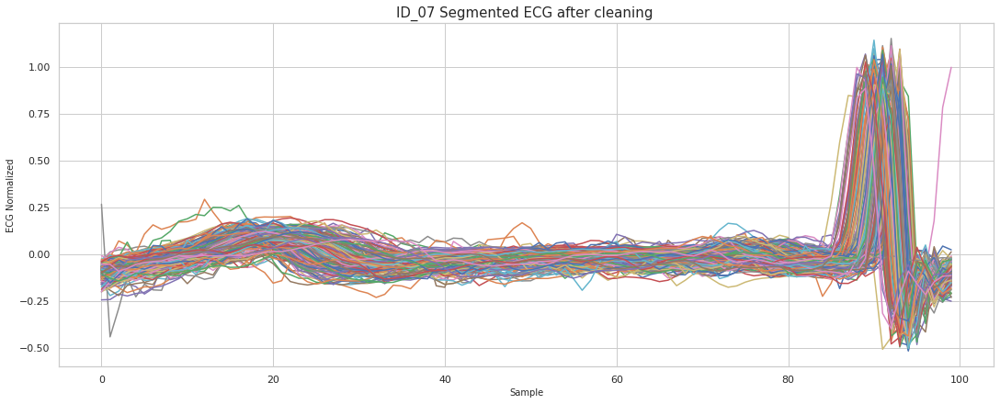

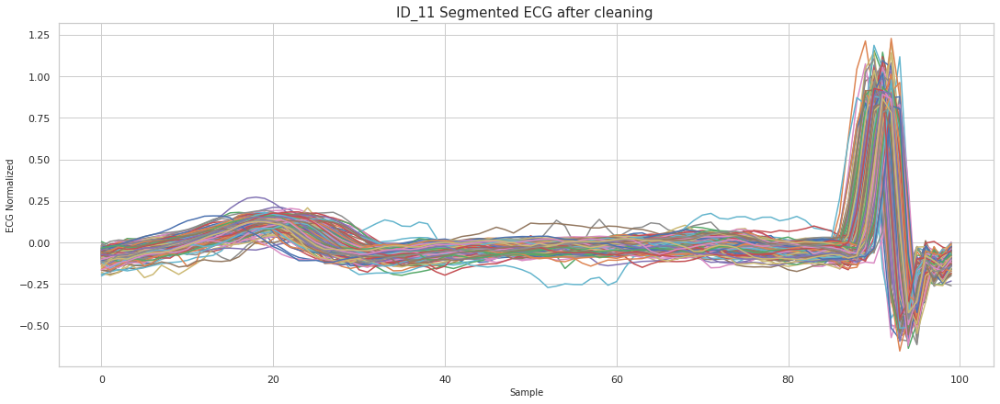

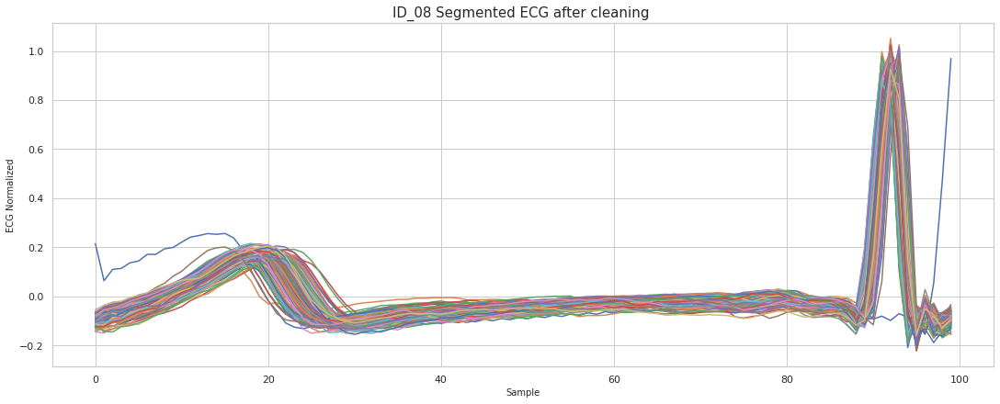

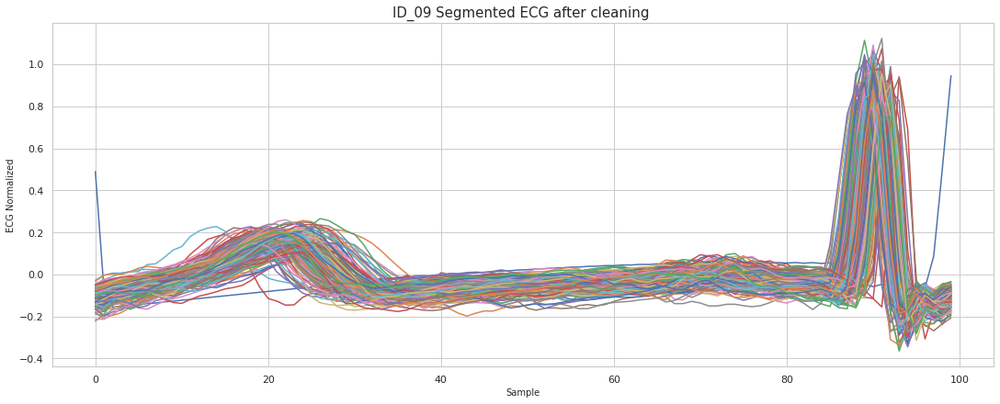

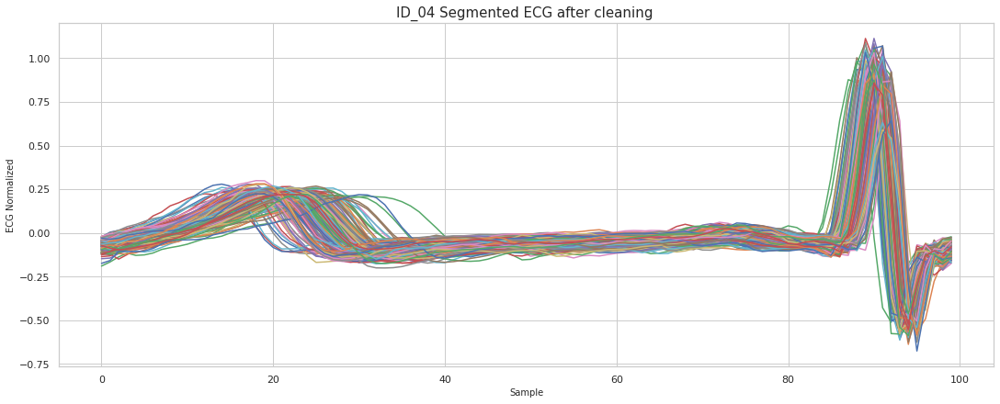

...

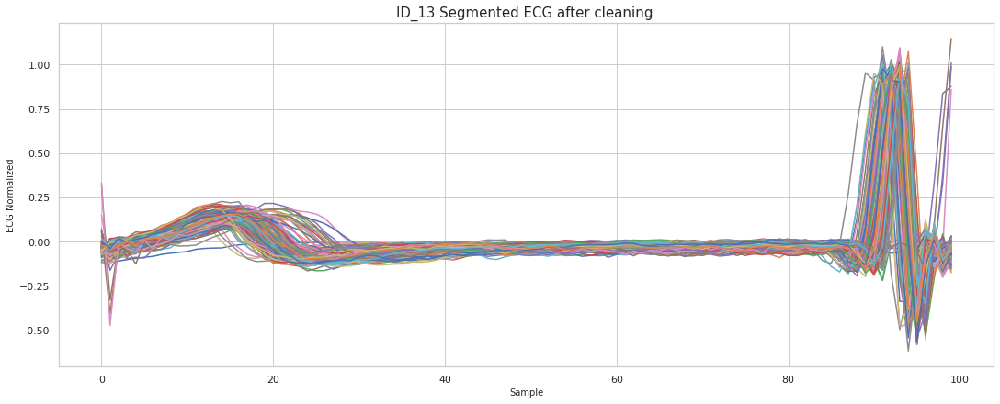

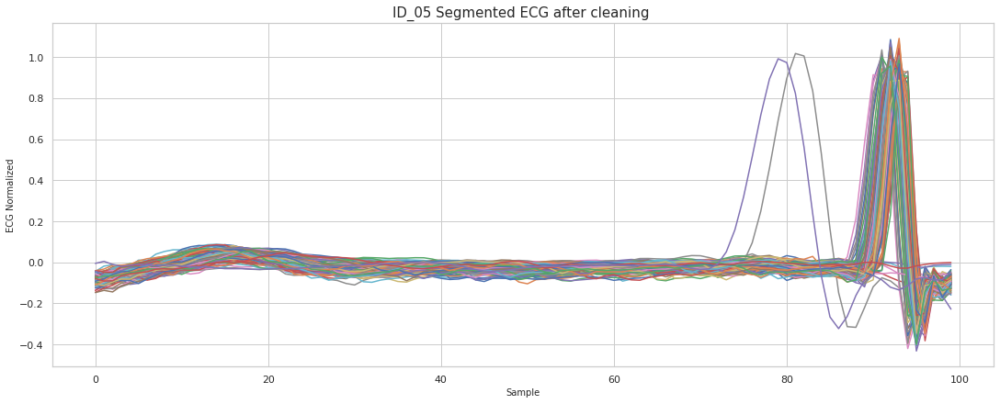

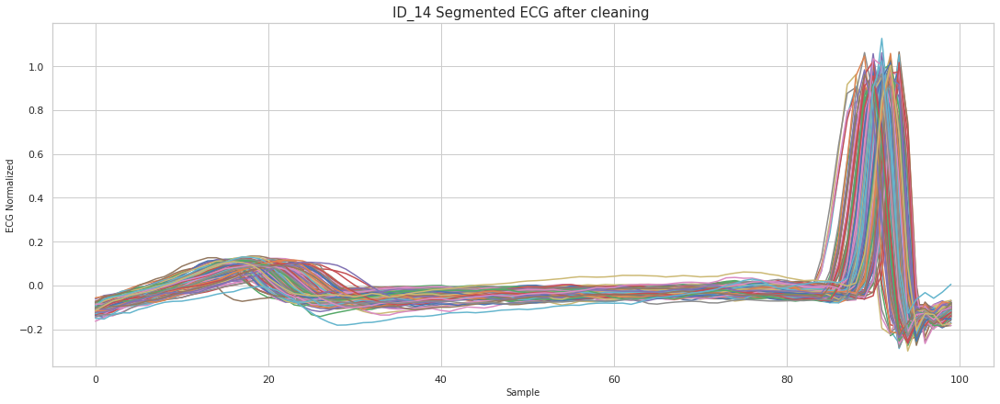

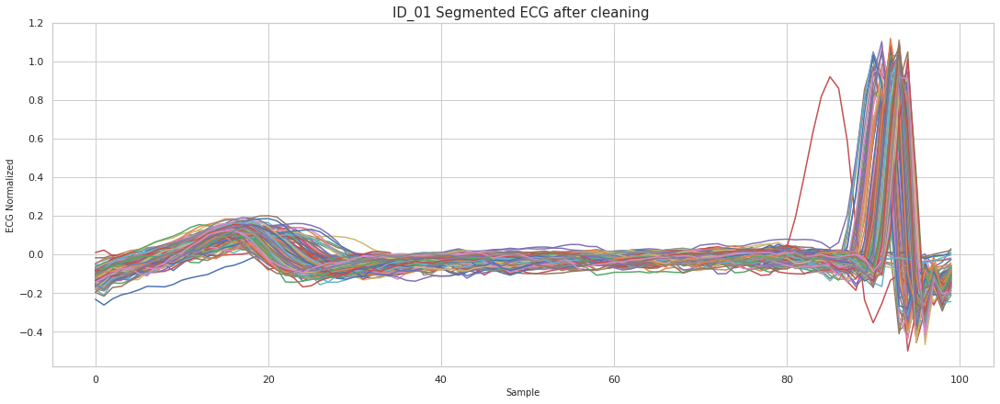

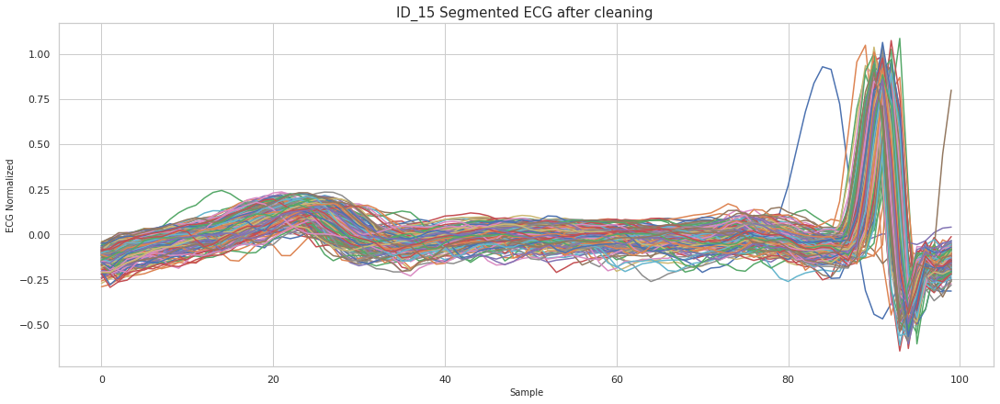

In [47]:
for key, value in segments_rest.items():
  plt.figure(constrained_layout=True, figsize=(15,6))
  plt.title(f'{key} Segmented ECG after cleaning ', fontsize = 15)
  plt.plot(value[0].T)
  plt.grid(True)
  plt.xlabel('Sample', fontsize = 10)
  plt.ylabel('ECG Normalized', fontsize = 10)
  plt.show()

**Task segments**

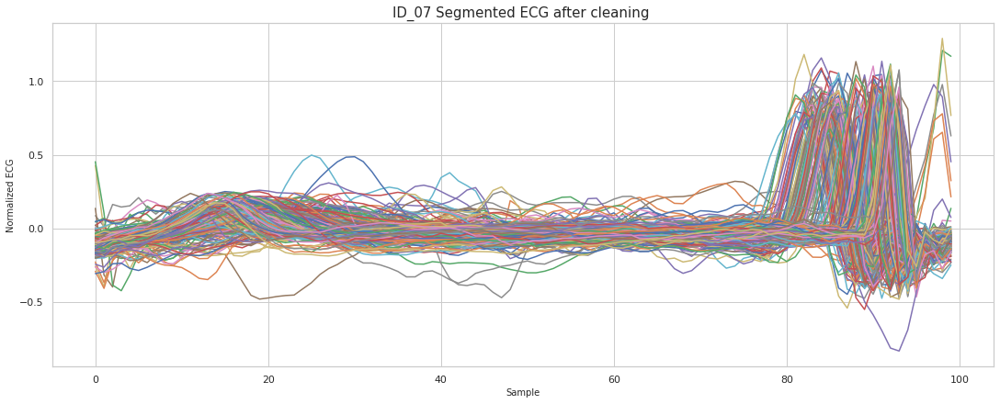

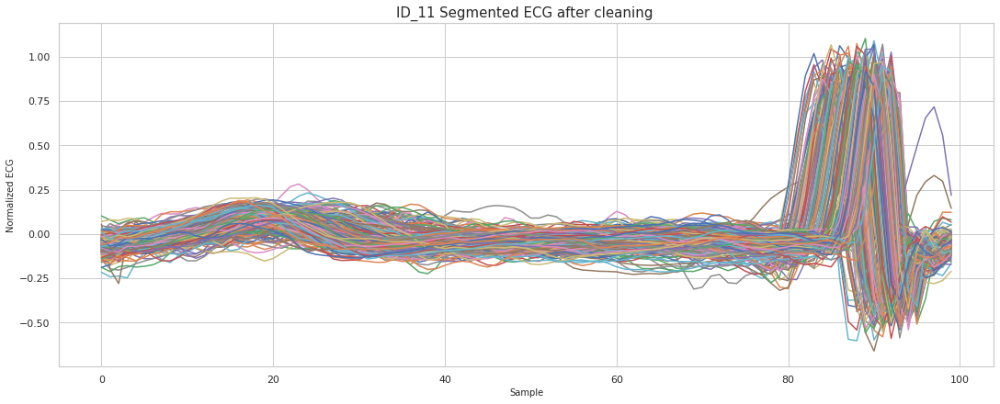

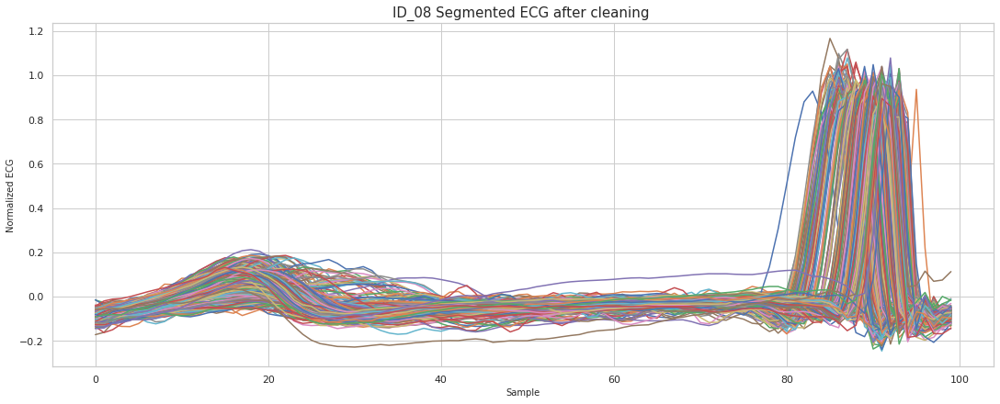

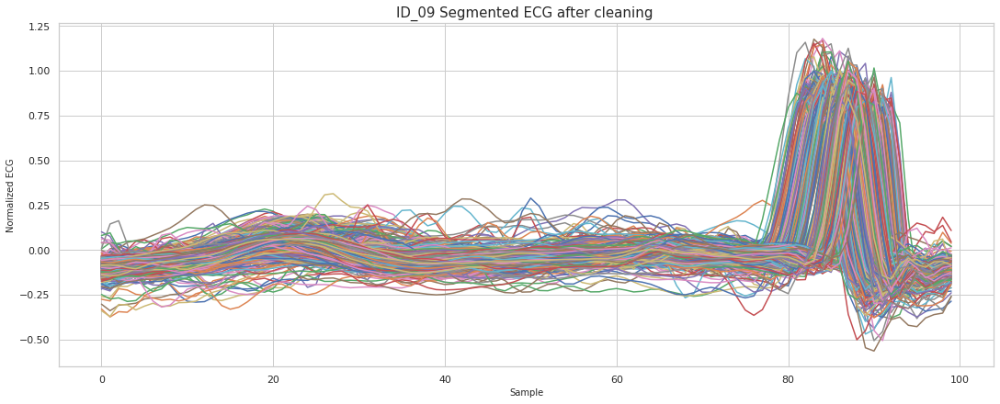

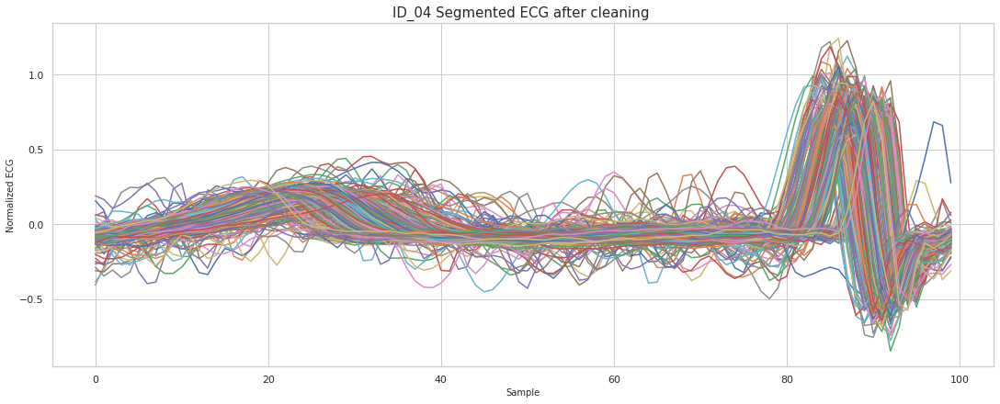

...

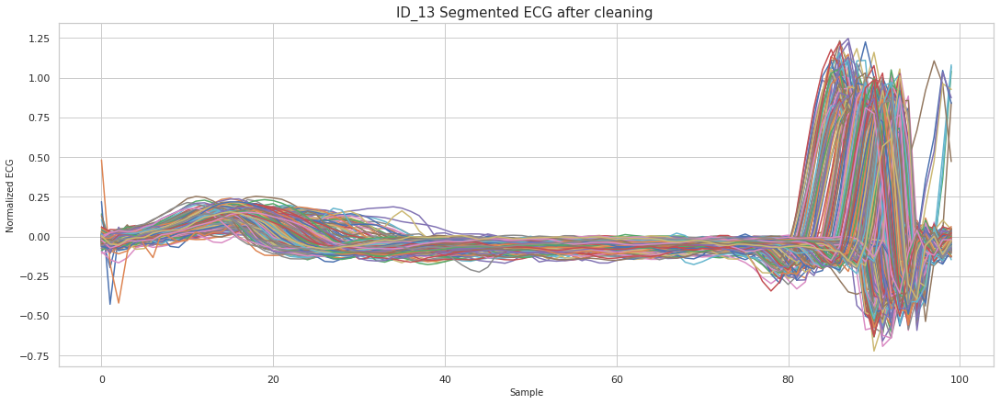

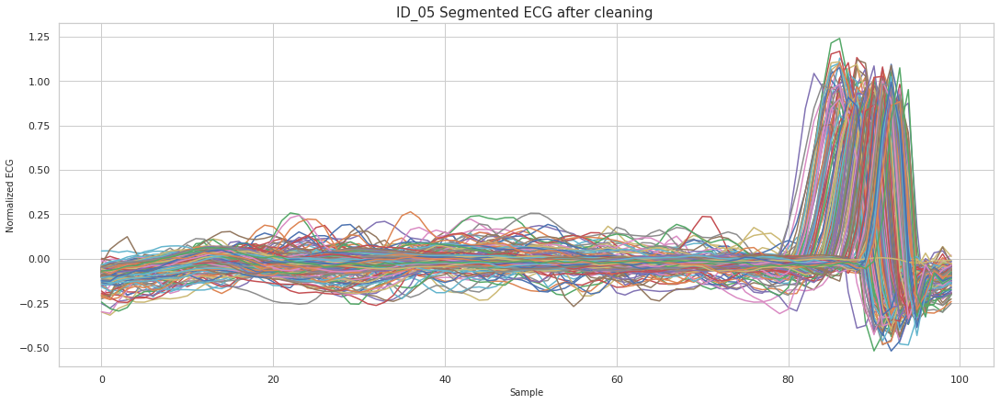

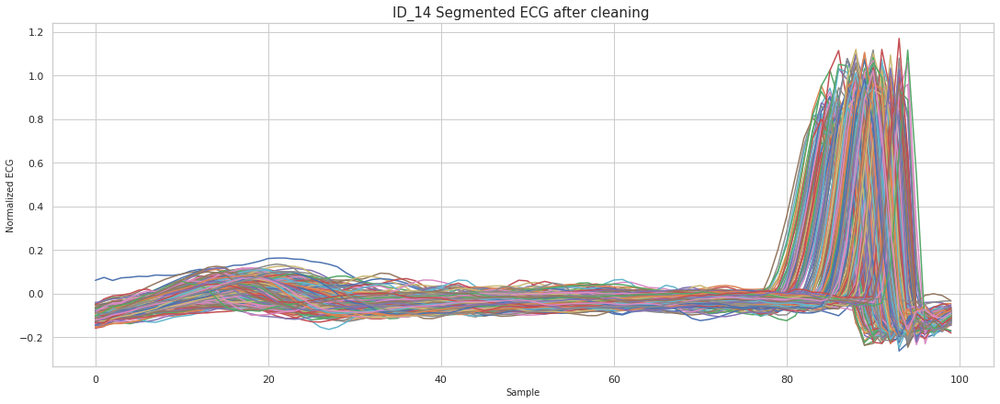

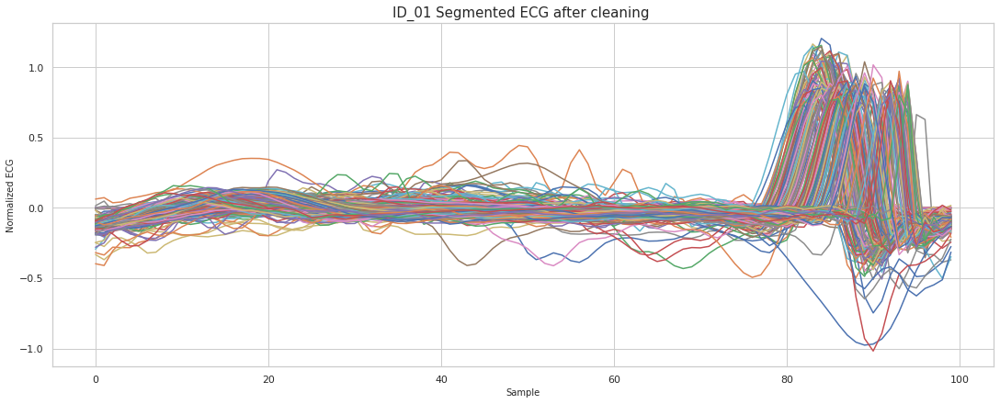

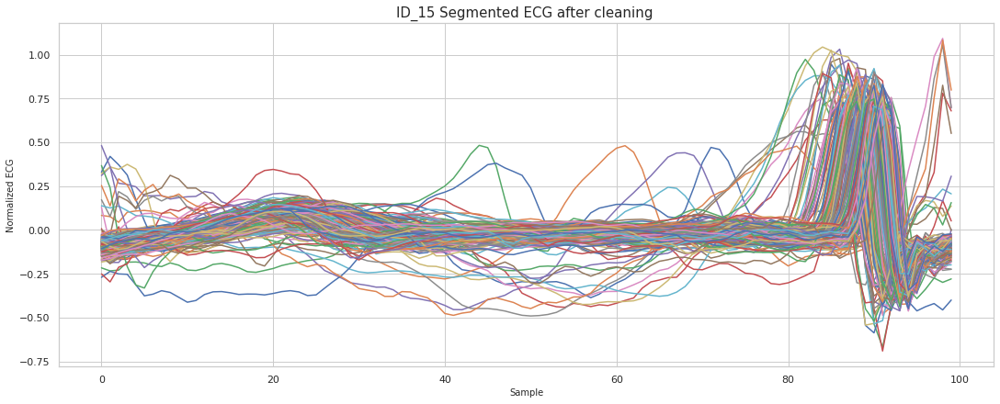

In [48]:
for key, value in segments_task.items():
  plt.figure(constrained_layout=True, figsize=(15,6))
  plt.title(f'{key} Segmented ECG after cleaning ', fontsize = 15)
  plt.plot(value[0].T)
  plt.grid(True)
  plt.xlabel('Sample', fontsize = 10)
  plt.ylabel('Normalized ECG', fontsize = 10)
  plt.show()

**MOVING AVERAGE**



In [49]:
def moving_average(data, moving_window_size,  length_seg, num_seg):
    
      for k in range(1,num_seg-1):
        moving_average_list = []
        padding = int((moving_window_size -1)/2) # window size always odd
        start = int((k*(length_seg/num_seg))- moving_window_size *2 )
        end = int((k*(length_seg/num_seg))+ moving_window_size *2 )

        data_aux = data [(start-padding):(end+padding)]
        data_aux = data [(start-padding):(end+padding)]

        for i in range(len(data_aux)-moving_window_size+1):
            moving_average = sum(data_aux[i:i+moving_window_size ]) / moving_window_size 
            moving_average_list.append(moving_average)
        data [start:end] = np.array(moving_average_list)

**SEGMENTS CONCATENATION**

In [50]:
def segments_concatenated(key_segments, label, number):

  vet_temp = np.zeros((int(np.round(key_segments.shape[0] - (number-1), 0)), number*100))
  z = 0

  for i in range(key_segments.shape[0] - (number - 1)): 

    if number == 5:
      vet_aux= np.concatenate((key_segments[i,:], key_segments[i+1,:], key_segments[i+2,:], key_segments[i+3,:], key_segments[i+4,:]))
   
    if number == 12:
      vet_aux= np.concatenate((key_segments[i,:], key_segments[i+1,:], key_segments[i+2,:], key_segments[i+3,:], key_segments[i+4,:],
                                key_segments[i+5,:], key_segments[i+6,:], key_segments[i+7,:], key_segments[i+8,:], key_segments[i+9,:],
                               key_segments[i+10,:], key_segments[i+11,:] ))
      
    moving_average(vet_aux, moving_window_size = 3,  length_seg = number*100, num_seg = number)

    vet_temp[z,:] = vet_aux
    z = z + 1

  # label
  row = vet_temp.shape[0]
  ind = range(row, label.shape[0])
  l = np.delete(label, ind)

  return vet_temp, l

# **ECG SPECTROGRAM**






In [51]:
def spectrogram(X_train, X_test, fs_data, dim_window):

  spectrogram_train = [] #
  spectrogram_test = [] #


  ## DIFFERENT WINDOWS COULD TAKEN INTO ACCOUNT ##
  # window = signal.get_window('general_hamming',M = 50, alpha= 2)
  # window = signal.windows.general_hamming(M = dim_window, alpha = 0.75, sym=True)
  # window = signal.windows.tukey(M = 2, alpha = 0.1)

  window = signal.windows.tukey(M = dim_window, alpha=0.5, sym=True)
  index = [0, 2, 3, 4, 5, 6, 7, 8,9]  #cleaning non-informative data, to make the image squared-form

  # print(index)
  for i in range(X_train.shape[0]): 
    data = X_train[i,:] 
    freq_axis, time_axis, Sxx = signal.spectrogram(data, fs_data, window = window, nperseg = dim_window, noverlap = 20)


    Sxx = np.tile(Sxx, (1, 3))
    Sxx = np.delete(Sxx, index, axis = 0)


    spectrogram_train.append(Sxx) 
    
  for i in range(X_test.shape[0]):
    data = X_test[i,:]
    freq_axis, time_axis, Sxx = signal.spectrogram(data, fs_data, window = window, nperseg = dim_window, noverlap = 20)
      

    Sxx = np.tile(Sxx, (1, 3))
    Sxx = np.delete(Sxx, index, axis = 0)

    spectrogram_test.append(Sxx)
  
  return spectrogram_train, spectrogram_test

# **DATA-SET PREPARATION**

In [52]:
def create_dataset(segment_matrix, fs_data, n, is_img, random_state):  #is_img, dim_window

  #Creo 4 liste
  train_matrices = []
  test_matrices = []
  train_labels = []
  test_labels = []

  n_temp = n

  for key, value in segment_matrix.items(): #Split Train-Test for each segment
    X = value[0] #segments
    y = value[1] # label
    
    X, y = segments_concatenated(X, y, number = n_temp) 

    # [train - test]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = RANDOM_SEED, stratify = y) 

    train_matrices.append(X_train)
    test_matrices.append(X_test)
    train_labels.append(y_train) 
    test_labels.append(y_test)



  X_train = train_matrices[0]
  X_test = test_matrices[0]
  y_train = train_labels[0]
  y_test = test_labels[0]


  for Xtr, Xte, ytr, yte in zip(train_matrices[1:], test_matrices[1:], train_labels[1:], test_labels[1:]):

    X_train = np.vstack((X_train, Xtr))
    X_test = np.vstack((X_test, Xte))
    y_train = np.hstack((y_train, ytr))
    y_test = np.hstack((y_test, yte))

  ## --- SHUFFLE OF Data --- ###

  ind_list = [i for i in range(len(y_train))]
  random.seed(random_state)
  random.shuffle(ind_list)
  X_train  = X_train[ind_list,:]
  y_train = y_train[ind_list,]

  ind_list = [i for i in range(len(y_test))]
  random.seed(random_state)
  random.shuffle(ind_list)
  X_test  = X_test[ind_list,:]
  y_test = y_test[ind_list,]

  # 2D DATASET
  if is_img:
    # Define spectrogram
    spectrogram_train, spectrogram_test = spectrogram(X_train, X_test, fs_data, dim_window = 100) 

    spectrogram_train = np.expand_dims(spectrogram_train, -1) 
    spectrogram_test = np.expand_dims(spectrogram_test, -1) 
    print (spectrogram_train.shape)
    print (spectrogram_test.shape)

    spectrogram_train = np.squeeze(spectrogram_train) 
    spectrogram_test = np.squeeze(spectrogram_test) 
    print (spectrogram_train.shape)
    print (spectrogram_test.shape)

    print('SHAPE: Training-set 2D', spectrogram_train.shape, '--- Test-set 2D', (spectrogram_test.shape), '--- label', y_train.shape, y_test.shape)
    print('TRAINING SET 2D: {} ({:.2f}%)'.format(spectrogram_train.shape[0], 100 * spectrogram_train.shape[0]/ (spectrogram_train.shape[0] + spectrogram_test.shape[0])))
    print('TEST SET 2D: {} ({:.2f}%)'.format(spectrogram_test.shape[0], 100 * spectrogram_test.shape[0]/ (spectrogram_train.shape[0] + spectrogram_test.shape[0])))
    print('\n')
    print(f'TOTAL NUMBER OF SAMPLES: {spectrogram_train.shape[0] + spectrogram_test.shape[0]}')
    
    return spectrogram_train, y_train, spectrogram_test, y_test

  else:

    print('SHAPE: Training-set', X_train.shape, '--- Test-set', (X_test.shape), '--- label', y_train.shape, y_test.shape)
    print('TRAINING SET : {} ({:.2f}%)'.format(X_train.shape[0], 100 * X_train.shape[0]/ (X_train.shape[0] + X_test.shape[0])))
    print('TEST SET : {} ({:.2f}%)'.format(X_test.shape[0], 100 * X_test.shape[0]/ (X_train.shape[0] + X_test.shape[0])))
    print('\n')
    print(f'TOTAL NUMBER OF SAMPLES: {X_train.shape[0] + X_test.shape[0]}')

    return X_train, y_train, X_test, y_test

## **Preparing dataset for One-Dimensional Network**

Extraction of Test set, Train Set and relatives labels, from the *Rest Dataset* and *Taks Dataset*

### **Rest Dataset**

In [53]:
# Segments Extraction (rest)
X_train_rest, y_train_rest, X_test_rest, y_test_rest = create_dataset(segments_rest, fs_min_rest, n = 12, is_img = False, random_state = RANDOM_SEED)

SHAPE: Training-set (1839, 1200) --- Test-set (620, 1200) --- label (1839,) (620,)
TRAINING SET : 1839 (74.79%)
TEST SET : 620 (25.21%)


TOTAL NUMBER OF SAMPLES: 2459


In [54]:
# Validation set for Rest Dataset
X_train_rest, X_val_rest, y_train_rest, y_val_rest = train_test_split(X_train_rest, y_train_rest, test_size = 0.2, random_state = RANDOM_SEED, stratify = y_train_rest)
print('SHAPE: Training-set', X_train_rest.shape, '--- Val-set', (X_val_rest.shape), '--- label', y_train_rest.shape, y_val_rest.shape)
print('FINAL TRAINING SET : {} ({:.2f}%)'.format(X_train_rest.shape[0], 100 * X_train_rest.shape[0]/ (X_train_rest.shape[0] + X_val_rest.shape[0])))
print('VALIDATION SET : {} ({:.2f}%)'.format(X_val_rest.shape[0], 100 * X_val_rest.shape[0]/ (X_train_rest.shape[0] + X_val_rest.shape[0])))
print('\n')
print(f'TOTAL NUMBER OF SAMPLES: {X_train_rest.shape[0] + X_val_rest.shape[0]}')

SHAPE: Training-set (1471, 1200) --- Val-set (368, 1200) --- label (1471,) (368,)
FINAL TRAINING SET : 1471 (79.99%)
VALIDATION SET : 368 (20.01%)


TOTAL NUMBER OF SAMPLES: 1839


### **Task Dataset**

In [55]:
# Segments Extraction (Task)
X_train_task, y_train_task, X_test_task, y_test_task = create_dataset(segments_task, fs_min_task, n = 12, is_img = False, random_state = RANDOM_SEED)

SHAPE: Training-set (2778, 1200) --- Test-set (932, 1200) --- label (2778,) (932,)
TRAINING SET : 2778 (74.88%)
TEST SET : 932 (25.12%)


TOTAL NUMBER OF SAMPLES: 3710


In [56]:
# Validation set for Task Dataset
X_train_task, X_val_task, y_train_task, y_val_task = train_test_split(X_train_task, y_train_task, test_size = 0.2, random_state = RANDOM_SEED, stratify = y_train_task)
print('SHAPE: Training-set', X_train_task.shape, '--- Val-set', (X_val_task.shape), '--- label', y_train_task.shape, y_val_task.shape)
print('FINAL TRAINING SET : {} ({:.2f}%)'.format(X_train_task.shape[0], 100 * X_train_task.shape[0]/ (X_train_task.shape[0] + X_val_task.shape[0])))
print('VALIDATION SET : {} ({:.2f}%)'.format(X_val_task.shape[0], 100 * X_val_task.shape[0]/ (X_train_task.shape[0] + X_val_task.shape[0])))
print('\n')
print(f'TOTAL NUMBER OF SAMPLES: {X_train_task.shape[0] + X_val_task.shape[0]}')

SHAPE: Training-set (2222, 1200) --- Val-set (556, 1200) --- label (2222,) (556,)
FINAL TRAINING SET : 2222 (79.99%)
VALIDATION SET : 556 (20.01%)


TOTAL NUMBER OF SAMPLES: 2778


## **Preparing dataset for 2-Dimensional Network**

Extraction of Test set, Train Set and relatives labels, from the **Spectrogram** of *Rest Dataset* and *Taks Dataset*

### **Spectrogram Rest Dataset**

In [57]:
# Spectrograms Extraction (rest)
X_train_spect_rest, y_train_spect_rest, X_test_spect_rest, y_test_spect_rest = create_dataset(segments_rest, fs_min_rest, n = 12, is_img = True, random_state = RANDOM_SEED)

(1839, 42, 42, 1)
(620, 42, 42, 1)
(1839, 42, 42)
(620, 42, 42)
SHAPE: Training-set 2D (1839, 42, 42) --- Test-set 2D (620, 42, 42) --- label (1839,) (620,)
TRAINING SET 2D: 1839 (74.79%)
TEST SET 2D: 620 (25.21%)


TOTAL NUMBER OF SAMPLES: 2459


In [58]:
y_train_spect_rest.shape

(1839,)

In [59]:
# Validation set for Spectrogram Rest Dataset
X_train_spect_rest, X_val_spect_rest, y_train_spect_rest, y_val_spect_rest = train_test_split(X_train_spect_rest, y_train_spect_rest, test_size = 0.2, random_state = RANDOM_SEED, stratify = y_train_spect_rest)
print('SHAPE: Training-set', X_train_spect_rest.shape, '--- Val-set', (X_val_spect_rest.shape), '--- label', y_train_spect_rest.shape, y_val_spect_rest.shape)
print('FINAL TRAINING SET : {} ({:.2f}%)'.format(X_train_spect_rest.shape[0], 100 * X_train_spect_rest.shape[0]/ (X_train_spect_rest.shape[0] + X_val_spect_rest.shape[0])))
print('VALIDATION SET : {} ({:.2f}%)'.format(X_val_spect_rest.shape[0], 100 * X_val_spect_rest.shape[0]/ (X_train_spect_rest.shape[0] + X_val_spect_rest.shape[0])))
print('\n')
print(f'TOTAL NUMBER OF SAMPLES: {X_train_rest.shape[0] + X_val_rest.shape[0]}')

SHAPE: Training-set (1471, 42, 42) --- Val-set (368, 42, 42) --- label (1471,) (368,)
FINAL TRAINING SET : 1471 (79.99%)
VALIDATION SET : 368 (20.01%)


TOTAL NUMBER OF SAMPLES: 1839


### **Spectrogram Task Dataset**

In [60]:
# Spectrograms Extraction (Task)
X_train_spect_task, y_train_spect_task, X_test_spect_task, y_test_spect_task = create_dataset(segments_task, fs_min_task, n = 12, is_img = True, random_state = RANDOM_SEED)

(2778, 42, 42, 1)
(932, 42, 42, 1)
(2778, 42, 42)
(932, 42, 42)
SHAPE: Training-set 2D (2778, 42, 42) --- Test-set 2D (932, 42, 42) --- label (2778,) (932,)
TRAINING SET 2D: 2778 (74.88%)
TEST SET 2D: 932 (25.12%)


TOTAL NUMBER OF SAMPLES: 3710


In [61]:
# Validation set for Spectrogram Task Dataset
X_train_spect_task, X_val_spect_task, y_train_spect_task, y_val_spect_task = train_test_split(X_train_spect_task, y_train_spect_task, test_size = 0.2, random_state = RANDOM_SEED, stratify = y_train_spect_task)
print('SHAPE: Training-set', X_train_spect_task.shape, '--- Val-set', (X_val_spect_task.shape), '--- label', y_train_spect_task.shape, y_val_spect_task.shape)
print('FINAL TRAINING SET : {} ({:.2f}%)'.format(X_train_spect_task.shape[0], 100 * X_train_spect_task.shape[0]/ (X_train_spect_task.shape[0] + X_val_spect_task.shape[0])))
print('TEST SET : {} ({:.2f}%)'.format(X_val_spect_task.shape[0], 100 * X_val_spect_task.shape[0]/ (X_train_spect_task.shape[0] + X_val_spect_task.shape[0])))
print('\n')
print(f'TOTAL NUMBER OF SAMPLES: {X_train_spect_task.shape[0] + X_val_spect_task.shape[0]}')

SHAPE: Training-set (2222, 42, 42) --- Val-set (556, 42, 42) --- label (2222,) (556,)
FINAL TRAINING SET : 2222 (79.99%)
TEST SET : 556 (20.01%)


TOTAL NUMBER OF SAMPLES: 2778


In [62]:
print('SHAPE: Training-set', X_train_spect_task.shape, '--- Val-set', (X_val_spect_task.shape), '--- label', y_train_spect_task.shape, y_val_spect_task.shape)
print('FINAL TRAINING SET : {} ({:.2f}%)'.format(X_train_spect_task.shape[0], 100 * X_train_spect_task.shape[0]/ (X_train_spect_task.shape[0] + X_val_spect_task.shape[0])))
print('TEST SET : {} ({:.2f}%)'.format(X_val_spect_task.shape[0], 100 * X_val_spect_task.shape[0]/ (X_train_spect_task.shape[0] + X_val_spect_task.shape[0])))
print('\n')
print(f'TOTAL NUMBER OF SAMPLES: {X_train_spect_task.shape[0] + X_val_spect_task.shape[0]}')

SHAPE: Training-set (2222, 42, 42) --- Val-set (556, 42, 42) --- label (2222,) (556,)
FINAL TRAINING SET : 2222 (79.99%)
TEST SET : 556 (20.01%)


TOTAL NUMBER OF SAMPLES: 2778


**PLOT SPECTROGRAMS**

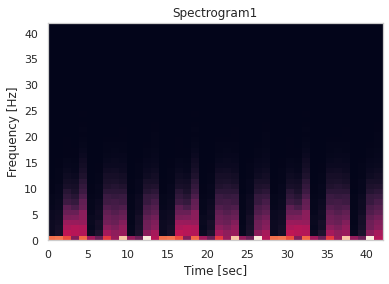

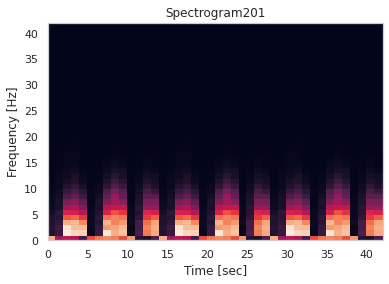

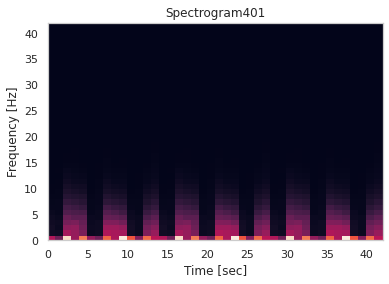

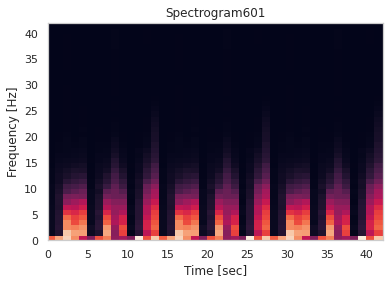

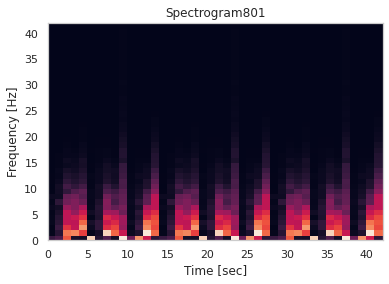

...

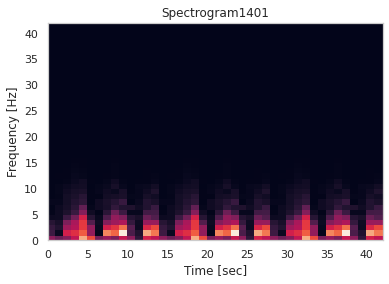

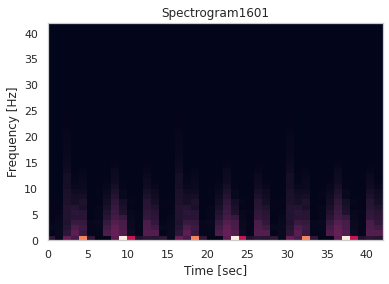

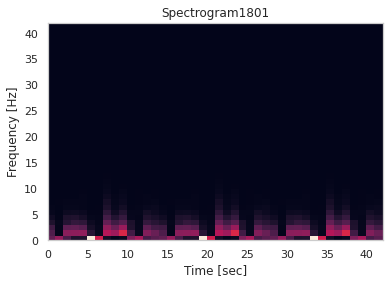

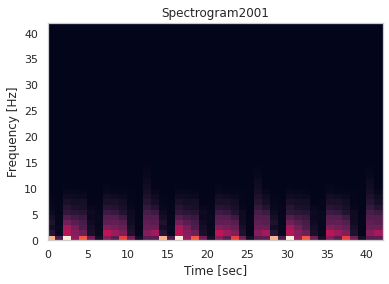

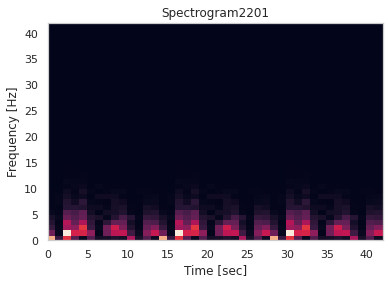

In [63]:
 # Plot the spectrogram 

for i in range(1, X_train_spect_task.shape[0], 200):
  plt.pcolormesh(X_train_spect_task[i,:,:])
  plt.title('Spectrogram' f'{i}')
  plt.ylabel('Frequency [Hz]')
  plt.xlabel('Time [sec]')
  plt.show()

# **DEEP LEARNING APPROACH**

> **1. Feed forward neural network**:

> **2.** **Recurrent neural network** (provare 5/8 segmenti, magari anche bidirezionale);

> **3.  Convolutional neural network (2D)**;

> **4.** **Networks comparison**.








**UTILS**

In [64]:
# Plot training history
def plot_history(history, path):
   plt.figure(figsize=(16,4))
   plt.subplot(121)
   plt.title('Loss')
   plt.plot(history.history['loss'], label='training_loss')
   plt.plot(history.history['val_loss'], label='validation_loss')
   #plt.grid()
   plt.xlabel('Epoch')
   plt.ylabel('Loss')
   plt.legend()
   
   plt.subplot(122)
   plt.title('Accuracy')
   plt.plot(history.history['accuracy'], label='training accuracy')
   plt.plot(history.history['val_accuracy'], label='validation accuracy')
   #plt.grid()
   plt.xlabel('Epoch')
   plt.ylabel('Accuracy')
   plt.legend()

In [65]:
def plot_all_histories(models, epochs):
  plt.figure(figsize = (16,4))
  
  # LOSS COMPARISON
  plt.subplot(121)
  plt.title('Loss')
  for key, value in models.items():
    plt.plot(epochs, value[1]['loss'], label = 'loss ' + key)
    plt.plot(epochs, value[1]['val_loss'], '--', label = 'val_loss ' + key)
  #plt.grid()
  plt.legend()
  
  # ACCURACY COMPARISON
  plt.subplot(122)
  plt.title('Accuracy')
  for key, value in models.items():
    plt.plot(epochs, value[1]['accuracy'], label = 'acc ' + key)
    plt.plot(epochs, value[1]['val_accuracy'], '--', label = 'val_acc ' + key)
  #plt.grid()
  plt.legend()

- Metrics

In [66]:
# Confusion matrix
def get_metrics(y_test: np.array, y_pred_labels: np.array, labels):
    #print(y_test.shape, y_pred_labels.shape, labels.shape)
    #print(classification_report(y_test, y_pred, target_names=labels, digits = 3))

    cm = confusion_matrix(y_test, y_pred_labels, normalize = 'true')
    fig, ax = plt.subplots(figsize=(10,10))
    if labels is None:
        labels = "auto"
    sns.heatmap(cm, annot=True, xticklabels=labels, yticklabels=labels, ax=ax)
    ax.set_ylabel("True", fontsize = 18)
    ax.set_xlabel("Predicted", fontsize = 18)
    plt.title('CONFUSION MATRIX', fontsize = 25)
    fig.tight_layout()

    plt.savefig('confusion_matrix.png')

In [67]:
from timeit import default_timer as timer

class TimingCallback(keras.callbacks.Callback):
    def __init__(self, logs={}):
        self.logs=[]
    def on_epoch_begin(self, epoch, logs={}):
        self.starttime = timer()
    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(timer()-self.starttime)

In [68]:
num_classes = 15 #number of classes

In [69]:
labels = np.array(range(1,16))
print(labels)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


# **FEED FORWARD NEURAL NETWORK**

Application of a *Feed-Forward Neural Network* to the Rest Dataset e Task Dataset

#**FFNN Rest**

##**1.Build the model**

In [70]:
input_shape = (1200,)

In [71]:
FFNN_rest = keras.Sequential(
    [
        keras.layers.Input(input_shape),

        # FIRST HIDDEN LAYER
        keras.layers.Dense(8, activation = 'relu'), 
        keras.layers.BatchNormalization(), #batch normalization 

        # SECOND HIDDEN LAYER
        keras.layers.Dense(8, activation = 'relu'),
        keras.layers.BatchNormalization(),
     
 
        keras.layers.Dense(16, activation = 'relu', kernel_regularizer = 'L2'), 
        keras.layers.Dense(num_classes, activation="softmax") #fully-connected
    ]
)
print(FFNN_rest.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 8)                 9608      
                                                                 
 batch_normalization (BatchN  (None, 8)                32        
 ormalization)                                                   
                                                                 
 dense_1 (Dense)             (None, 8)                 72        
                                                                 
 batch_normalization_1 (Batc  (None, 8)                32        
 hNormalization)                                                 
                                                                 
 dense_2 (Dense)             (None, 16)                144       
                                                                 
 dense_3 (Dense)             (None, 15)                2

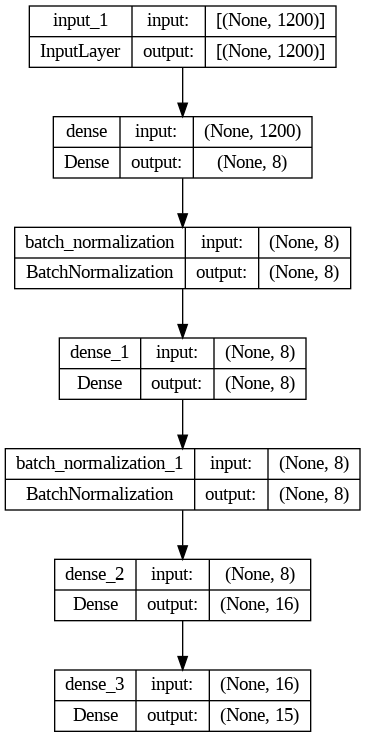

In [72]:
keras.utils.plot_model(FFNN_rest, "FFNN_rest.png", show_shapes=True)

##**2.Train the model**

In [73]:
print(y_train_rest.shape)

(1471,)


In [74]:
## COMPUTE CLASS WEIGHTS FOR UNBALANCED CLASSES


occurrence = np.bincount(y_train_rest)
n_samples = np.array(y_train_rest.shape)
n_classes = num_classes


class_weights = dict()

for i in range(0,15):
    score = n_samples/(n_classes * occurrence[i])

    class_weights[i] = score


print(class_weights)

{0: array([0.79728997]), 1: array([0.9709571]), 2: array([1.27359307]), 3: array([1.07765568]), 4: array([0.80382514]), 5: array([1.04326241]), 6: array([1.08962963]), 7: array([1.27359307]), 8: array([0.69061033]), 9: array([1.07765568]), 10: array([1.16746032]), 11: array([1.22583333]), 12: array([0.9709571]), 13: array([1.11439394]), 14: array([0.89151515])}


In [75]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 5), TimingCallback()]
optimizer = keras.optimizers.Adam(learning_rate = 1e-3)
FFNN_rest.compile(loss="categorical_crossentropy",  optimizer = optimizer , weighted_metrics=["accuracy"]) 

batch_size = 32 
epochs = 40 

In [76]:
# Categorical classes
y_train_cat_rest = keras.utils.to_categorical(y_train_rest, num_classes)
y_test_cat_rest = keras.utils.to_categorical(y_test_rest, num_classes)
y_val_cat_rest = keras.utils.to_categorical(y_val_rest, num_classes)

In [77]:
print(y_train_cat_rest.shape, y_train_rest.shape)
print(y_test_cat_rest.shape, y_test_rest.shape)
print(y_val_cat_rest.shape, y_val_rest.shape)

(1471, 15) (1471,)
(620, 15) (620,)
(368, 15) (368,)


In [78]:
history_FFNN_rest = FFNN_rest.fit(X_train_rest, y_train_cat_rest, batch_size=batch_size, epochs=epochs, class_weight = class_weights,  validation_data = (X_val_rest, y_val_cat_rest), callbacks = [callbacks])

Epoch 1/40
46/46 [==============================] - 7s 14ms/step - loss: 2.6068 - accuracy: 0.1908 - val_loss: 2.7547 - val_accuracy: 0.1875
Epoch 2/40
46/46 [==============================] - 0s 8ms/step - loss: 2.3252 - accuracy: 0.3225 - val_loss: 2.6339 - val_accuracy: 0.2011
Epoch 3/40
46/46 [==============================] - 0s 8ms/step - loss: 2.1173 - accuracy: 0.3741 - val_loss: 2.4956 - val_accuracy: 0.2174
Epoch 4/40
46/46 [==============================] - 0s 9ms/step - loss: 1.9273 - accuracy: 0.4246 - val_loss: 2.2935 - val_accuracy: 0.2772
Epoch 5/40
46/46 [==============================] - 0s 9ms/step - loss: 1.7356 - accuracy: 0.5303 - val_loss: 2.1096 - val_accuracy: 0.3424
Epoch 6/40
46/46 [==============================] - 0s 8ms/step - loss: 1.5574 - accuracy: 0.6356 - val_loss: 1.8860 - val_accuracy: 0.3832
Epoch 7/40
46/46 [==============================] - 0s 7ms/step - loss: 1.3478 - accuracy: 0.7292 - val_loss: 1.5880 - val_accuracy: 0.5380
Epoch 8/40
46/46 [=

In [79]:
print(sum(callbacks[1].logs))

22.79285643800017


###**Save the model and the history**

In [80]:
# Save trained model
FFNN_rest.save(f'/content/FFNN_rest.h5') 

# Save history json
with open(f'/content/history_FFNN_rest.json', 'w', encoding='utf-8') as f:
    json.dump(history_FFNN_rest.history, f, ensure_ascii=False, indent=4)

In [81]:
# Load saved model
saved_FFNN_rest = load_model(f'/content/FFNN_rest.h5')

#Load history json
with open(f'/content/history_FFNN_rest.json', "r") as f:
  saved_history_FFNN_rest = json.load(f)

###**Evaluate the model**

- Learning curves

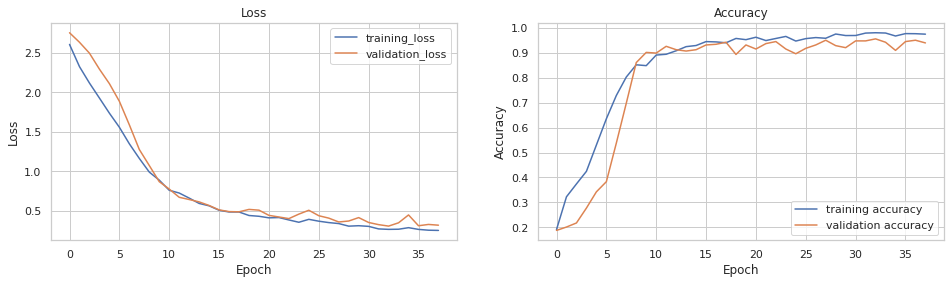

In [82]:
plot_history(history_FFNN_rest, path = "history_FFNN_rest.png")
plt.savefig('history_FFNN_rest.png')

- Confusion matrix

In [83]:
y_pred_rest = FFNN_rest.predict(X_test_rest)
y_pred_rest = np.argmax(y_pred_rest, axis=1)

20/20 [==============================] - 0s 2ms/step


In [84]:
## COMPUTE SAMPLE WEIGHTS FOR TEST SET, FOR UNBALANCED CLASSES
n_samples = np.array(y_test_rest.shape)
n_classes = num_classes
occurrence = np.bincount(y_test_rest)

print (occurrence)

weights = np.zeros(num_classes)
for i in range(0,15):
  weights[i,] = n_samples/(n_classes * occurrence[i])

weights = np.array(weights)
print(weights)
print(weights.shape)

sample_weights = np.zeros(len(y_test_rest))
for i in range(0, len(y_test_rest)):
  pos = y_test_rest[i]
  sample_weights[i] = weights[pos,]

print(sample_weights.shape)


[52 42 32 38 51 40 38 33 59 38 36 34 43 37 47]
[0.79487179 0.98412698 1.29166667 1.0877193  0.81045752 1.03333333
 1.0877193  1.25252525 0.70056497 1.0877193  1.14814815 1.21568627
 0.96124031 1.11711712 0.87943262]
(15,)
(620,)


In [85]:
score = saved_FFNN_rest.evaluate(X_test_rest, y_test_cat_rest, sample_weight=sample_weights, verbose=0)

print("Test loss:", score[0])
print("Test accuracy:", score[1])

Test loss: 0.3750884234905243
Test accuracy: 0.9345442056655884


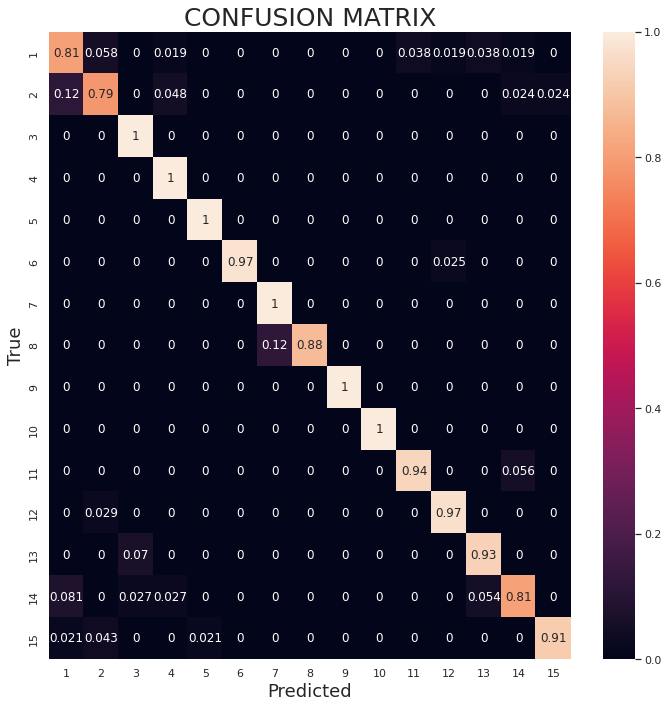

In [86]:
get_metrics(y_test_rest, y_pred_rest, labels=labels)

- Other metrics

In [87]:
print(classification_report(y_test_rest, y_pred_rest, target_names=[str(label) for label in labels]))

              precision    recall  f1-score   support

           1       0.82      0.81      0.82        52
           2       0.85      0.79      0.81        42
           3       0.89      1.00      0.94        32
           4       0.90      1.00      0.95        38
           5       0.98      1.00      0.99        51
           6       1.00      0.97      0.99        40
           7       0.90      1.00      0.95        38
           8       1.00      0.88      0.94        33
           9       1.00      1.00      1.00        59
          10       1.00      1.00      1.00        38
          11       0.94      0.94      0.94        36
          12       0.94      0.97      0.96        34
          13       0.91      0.93      0.92        43
          14       0.88      0.81      0.85        37
          15       0.98      0.91      0.95        47

    accuracy                           0.93       620
   macro avg       0.93      0.93      0.93       620
weighted avg       0.93   

#**FFNN Task**

##**1.Build the model**

In [88]:
input_shape = (1200,)

In [89]:
FFNN_task = keras.Sequential(
    [
        keras.layers.Input(input_shape),

        # FIRST HIDDEN LAYER
        keras.layers.Dense(8, activation = 'relu'), # 
        keras.layers.BatchNormalization(), #batch normalization 

        # SECOND HIDDEN LAYER
        keras.layers.Dense(8, activation = 'relu'),
        keras.layers.BatchNormalization(),
     
   
 
        keras.layers.Dense(16, activation = 'relu', kernel_regularizer = 'L2'), 
        keras.layers.Dense(num_classes, activation="softmax") #fully-connected
    ]
)
print(FFNN_task.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 8)                 9608      
                                                                 
 batch_normalization_2 (Batc  (None, 8)                32        
 hNormalization)                                                 
                                                                 
 dense_5 (Dense)             (None, 8)                 72        
                                                                 
 batch_normalization_3 (Batc  (None, 8)                32        
 hNormalization)                                                 
                                                                 
 dense_6 (Dense)             (None, 16)                144       
                                                                 
 dense_7 (Dense)             (None, 15)               

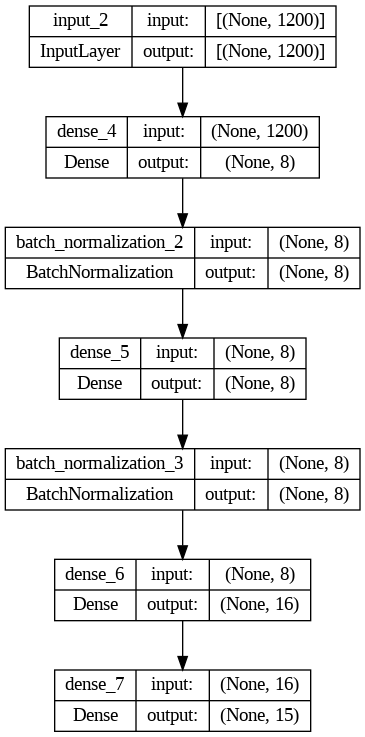

In [90]:
keras.utils.plot_model(FFNN_task, "FFNN_task.png", show_shapes=True)

##**2.Train the model**

In [91]:
# Categorical classes
y_train_cat_task = keras.utils.to_categorical(y_train_task, num_classes)
y_test_cat_task = keras.utils.to_categorical(y_test_task, num_classes)
y_val_cat_task = keras.utils.to_categorical(y_val_task, num_classes)

In [92]:
## COMPUTE CLASS WEIGHTS FOR UNBALANCED CLASSES

occurrence = np.bincount(y_train_task)
n_samples = np.array(y_train_task.shape)
n_classes = num_classes


class_weights = dict()

for i in range(0,15):
    score = n_samples/(n_classes * occurrence[i])

    class_weights[i] = score


print(class_weights)

{0: array([1.08126521]), 1: array([0.91440329]), 2: array([0.93755274]), 3: array([0.70877193]), 4: array([0.89236948]), 5: array([0.98101545]), 6: array([1.07342995]), 7: array([1.35902141]), 8: array([0.88174603]), 9: array([1.01461187]), 10: array([1.08126521]), 11: array([1.1664042]), 12: array([1.0009009]), 13: array([1.05809524]), 14: array([1.17566138])}


In [93]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 5), TimingCallback()]
optimizer = keras.optimizers.Adam(learning_rate = 1e-3)
FFNN_task.compile(loss="categorical_crossentropy", optimizer = optimizer , weighted_metrics=["accuracy"]) 

batch_size = 32 
epochs = 40 

In [94]:
print(y_train_cat_task.shape, y_train_task.shape)
print(y_test_cat_task.shape, y_test_task.shape)
print(y_val_cat_task.shape, y_val_task.shape)

(2222, 15) (2222,)
(932, 15) (932,)
(556, 15) (556,)


In [95]:
history_FFNN_task = FFNN_task.fit(X_train_task, y_train_cat_task, batch_size=batch_size, epochs=epochs, class_weight = class_weights, validation_data = (X_val_task, y_val_cat_task), callbacks = [callbacks])

Epoch 1/40
70/70 [==============================] - 4s 11ms/step - loss: 2.6568 - accuracy: 0.1536 - val_loss: 2.7242 - val_accuracy: 0.1187
Epoch 2/40
70/70 [==============================] - 1s 8ms/step - loss: 2.3420 - accuracy: 0.2675 - val_loss: 2.5421 - val_accuracy: 0.2176
Epoch 3/40
70/70 [==============================] - 1s 8ms/step - loss: 2.1048 - accuracy: 0.3444 - val_loss: 2.2462 - val_accuracy: 0.3129
Epoch 4/40
70/70 [==============================] - 1s 7ms/step - loss: 1.8863 - accuracy: 0.4381 - val_loss: 1.9610 - val_accuracy: 0.4712
Epoch 5/40
70/70 [==============================] - 1s 8ms/step - loss: 1.6918 - accuracy: 0.5080 - val_loss: 1.7519 - val_accuracy: 0.4694
Epoch 6/40
70/70 [==============================] - 1s 8ms/step - loss: 1.5141 - accuracy: 0.5616 - val_loss: 1.5201 - val_accuracy: 0.5126
Epoch 7/40
70/70 [==============================] - 1s 8ms/step - loss: 1.3816 - accuracy: 0.5988 - val_loss: 1.4025 - val_accuracy: 0.5881
Epoch 8/40
70/70 [=

In [96]:
print(sum(callbacks[1].logs))

24.232934684000043


###**Save the model and the history**

In [97]:
# Save trained model
FFNN_task.save(f'/content/FFNN_task.h5') 

# Save history json
with open(f'/content/history_FFNN_task.json', 'w', encoding='utf-8') as f:
    json.dump(history_FFNN_task.history, f, ensure_ascii=False, indent=4)

In [98]:
# Load saved model
saved_FFNN_task = load_model(f'/content/FFNN_task.h5')

#Load history json
with open(f'/content/history_FFNN_task.json', "r") as f:
  saved_history_FFNN_task = json.load(f)

###**Evaluate the model**

- Learning curves

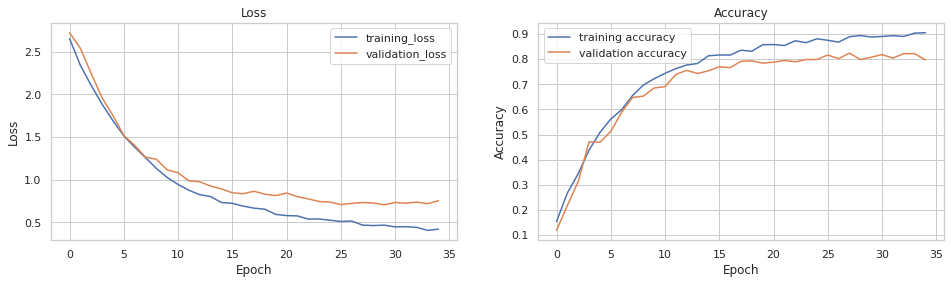

In [99]:
plot_history(history_FFNN_task, path = "history_FFNN_task.png")
plt.savefig('history_FFNN_task.png')

- Confusion matrix

In [100]:
y_pred_task = FFNN_task.predict(X_test_task)
y_pred_task = np.argmax(y_pred_task, axis=1)

30/30 [==============================] - 0s 3ms/step


In [101]:
## COMPUTE SAMPPLE WEIGHTS FOR TEST SET, FOR UNBALANCED CLASSES
n_samples = np.array(y_test_task.shape)
n_classes = num_classes
occurrence = np.bincount(y_test_task)

print (occurrence)

weights = np.zeros(num_classes)
for i in range(0,15):
  weights[i,] = n_samples/(n_classes * occurrence[i])

weights = np.array(weights)
print(weights)
print(weights.shape)

sample_weights = np.zeros(len(y_test_task))
for i in range(0, len(y_test_task)):
  pos = y_test_task[i]
  sample_weights[i] = weights[pos,]

print(sample_weights.shape)


[57 68 67 87 70 63 58 46 71 61 57 53 62 59 53]
[1.09005848 0.91372549 0.92736318 0.71417625 0.88761905 0.98624339
 1.07126437 1.35072464 0.87511737 1.01857923 1.09005848 1.17232704
 1.00215054 1.05310734 1.17232704]
(15,)
(932,)


In [102]:
score = saved_FFNN_task.evaluate(X_test_task, y_test_cat_task,sample_weight=sample_weights, verbose=0)

print("Test loss:", score[0])
print("Test accuracy:", score[1])

Test loss: 0.7482627630233765
Test accuracy: 0.8201382756233215


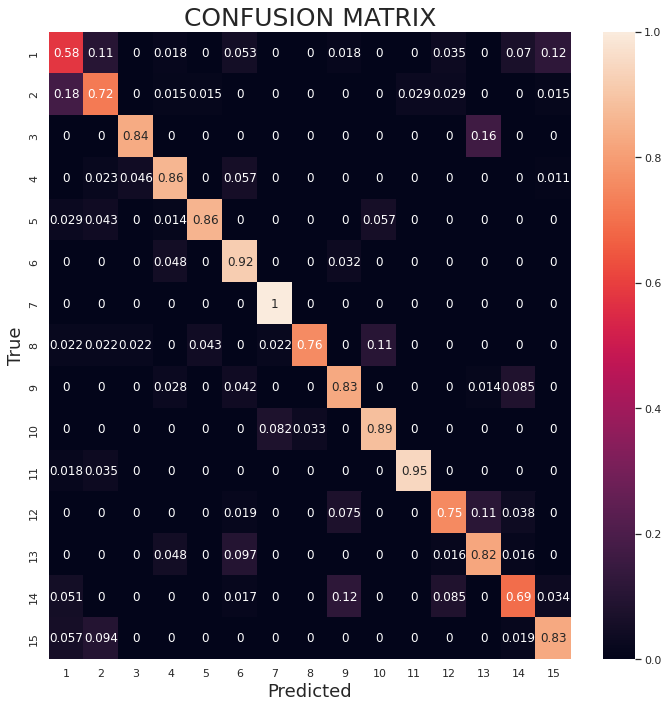

In [103]:
get_metrics(y_test_task, y_pred_task, labels=labels)

- Other metrics

In [104]:
print(classification_report(y_test_task, y_pred_task, target_names=[str(label) for label in labels]))

              precision    recall  f1-score   support

           1       0.60      0.58      0.59        57
           2       0.72      0.72      0.72        68
           3       0.92      0.84      0.88        67
           4       0.87      0.86      0.87        87
           5       0.95      0.86      0.90        70
           6       0.75      0.92      0.83        63
           7       0.91      1.00      0.95        58
           8       0.95      0.76      0.84        46
           9       0.81      0.83      0.82        71
          10       0.86      0.89      0.87        61
          11       0.96      0.95      0.96        57
          12       0.80      0.75      0.78        53
          13       0.74      0.82      0.78        62
          14       0.75      0.69      0.72        59
          15       0.80      0.83      0.81        53

    accuracy                           0.82       932
   macro avg       0.83      0.82      0.82       932
weighted avg       0.83   

# **RECURRENT NEURAL NETWORK**


# **RNN Rest**

##**1.Build the model**

In [105]:
input_shape = (1200,1)

In [106]:
RNN_rest = keras.Sequential(
    [
        keras.layers.Input(input_shape),
      
        tf.keras.layers.GRU(16, activation = 'tanh', return_sequences=True, dropout = 0.1),
      
        tf.keras.layers.GRU(16, activation = 'tanh', return_sequences=True, dropout = 0.1),
      
        keras.layers.Flatten(),

        keras.layers.Dense(16, activation = 'relu', kernel_regularizer = 'L2'),
        keras.layers.Dense(num_classes, activation="softmax") #fully-connected
    ]
)
print(RNN_rest.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 1200, 16)          912       
                                                                 
 gru_1 (GRU)                 (None, 1200, 16)          1632      
                                                                 
 flatten (Flatten)           (None, 19200)             0         
                                                                 
 dense_8 (Dense)             (None, 16)                307216    
                                                                 
 dense_9 (Dense)             (None, 15)                255       
                                                                 
Total params: 310,015
Trainable params: 310,015
Non-trainable params: 0
_________________________________________________________________
None


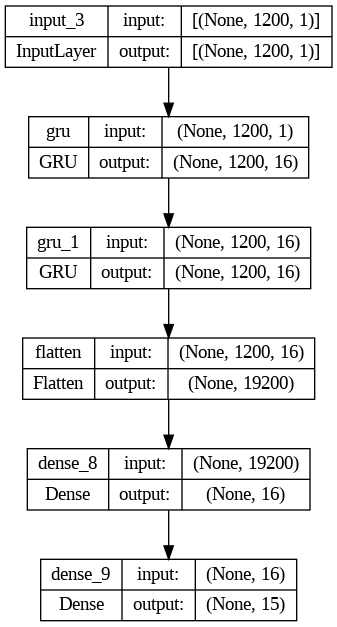

In [107]:
keras.utils.plot_model(RNN_rest, "gru_rest.png", show_shapes=True)

##**2. Train the model**

In [108]:
# Categorical classes
y_train_cat_rest = keras.utils.to_categorical(y_train_rest, num_classes)
y_test_cat_rest = keras.utils.to_categorical(y_test_rest, num_classes)
y_val_cat_rest = keras.utils.to_categorical(y_val_rest, num_classes)

In [109]:
## COMPUTE CLASS WEIGHTS FOR TRAIN SET, FOR UNBALANCED CLASSES


occurrence = np.bincount(y_train_rest)
n_samples = np.array(y_train_rest.shape)
n_classes = num_classes


class_weights = dict()

for i in range(0,15):
    score = n_samples/(n_classes * occurrence[i])

    class_weights[i] = score


print(class_weights)

{0: array([0.79728997]), 1: array([0.9709571]), 2: array([1.27359307]), 3: array([1.07765568]), 4: array([0.80382514]), 5: array([1.04326241]), 6: array([1.08962963]), 7: array([1.27359307]), 8: array([0.69061033]), 9: array([1.07765568]), 10: array([1.16746032]), 11: array([1.22583333]), 12: array([0.9709571]), 13: array([1.11439394]), 14: array([0.89151515])}


In [110]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 5), TimingCallback()]
optimizer = keras.optimizers.Adam(learning_rate = 5e-4) 
RNN_rest.compile(loss="categorical_crossentropy", optimizer= optimizer, weighted_metrics=["accuracy"]) 
batch_size = 32 
epochs = 40

In [111]:
history_RNN_rest = RNN_rest.fit(X_train_rest, y_train_cat_rest, batch_size=batch_size, epochs=epochs, class_weight = class_weights, validation_data = (X_val_rest, y_val_cat_rest), callbacks = callbacks)

Epoch 1/40
46/46 [==============================] - 12s 113ms/step - loss: 2.6353 - accuracy: 0.2188 - val_loss: 2.2338 - val_accuracy: 0.3152
Epoch 2/40
46/46 [==============================] - 3s 76ms/step - loss: 1.9238 - accuracy: 0.4341 - val_loss: 1.4625 - val_accuracy: 0.6250
Epoch 3/40
46/46 [==============================] - 3s 68ms/step - loss: 1.2632 - accuracy: 0.6919 - val_loss: 1.0848 - val_accuracy: 0.7174
Epoch 4/40
46/46 [==============================] - 3s 76ms/step - loss: 0.8987 - accuracy: 0.7924 - val_loss: 0.8354 - val_accuracy: 0.8207
Epoch 5/40
46/46 [==============================] - 4s 77ms/step - loss: 0.6922 - accuracy: 0.8687 - val_loss: 0.6692 - val_accuracy: 0.8777
Epoch 6/40
46/46 [==============================] - 3s 67ms/step - loss: 0.5568 - accuracy: 0.9133 - val_loss: 0.6702 - val_accuracy: 0.8614
Epoch 7/40
46/46 [==============================] - 3s 67ms/step - loss: 0.4861 - accuracy: 0.9225 - val_loss: 0.5123 - val_accuracy: 0.9185
Epoch 8/40


In [112]:
print(sum(callbacks[1].logs))

80.54274638400005


### **Save the model and the history**

In [113]:
# Save trained model
RNN_rest.save(f'/content/RNN_rest.h5') 

# Save history json
with open(f'/content/history_RNN_rest.json', 'w', encoding='utf-8') as f:
    json.dump(history_RNN_rest.history, f, ensure_ascii=False, indent=4)

In [114]:
# Load saved model
saved_RNN_rest = load_model(f'/content/RNN_rest.h5')

#Load history json
with open(f'/content/history_RNN_rest.json', "r") as f:
  saved_history_RNN_rest = json.load(f)

### **Evaluate the model**


- Learning curves

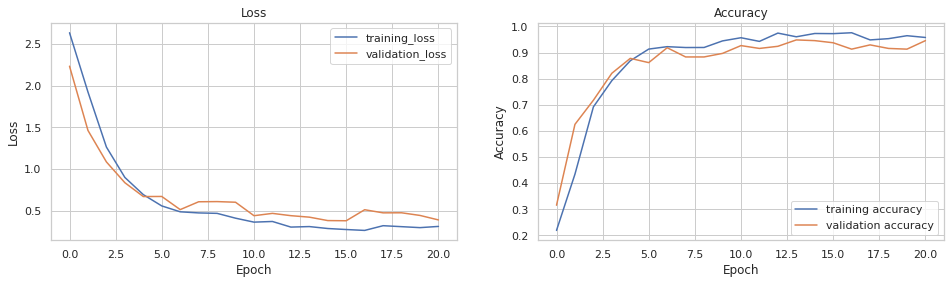

In [115]:
plot_history(history_RNN_rest, path = 'History_RNN_rest.png')

- Confusion matrix

In [116]:
y_pred_rest = RNN_rest.predict(X_test_rest)
y_pred_rest = np.argmax(y_pred_rest, axis=1) 

20/20 [==============================] - 1s 39ms/step


In [117]:
## COMPUTE SAMPLE WEIGHTS FOR TEST SET, FOR UNBALANCED CLASSES
n_samples = np.array(y_test_rest.shape)
n_classes = num_classes
occurrence = np.bincount(y_test_rest)

print (occurrence)

weights = np.zeros(num_classes)
for i in range(0,15):
  weights[i,] = n_samples/(n_classes * occurrence[i])

weights = np.array(weights)
print(weights)
print(weights.shape)

sample_weights = np.zeros(len(y_test_rest))
for i in range(0, len(y_test_rest)):
  pos = y_test_rest[i]
  sample_weights[i] = weights[pos,]

print(sample_weights.shape)


[52 42 32 38 51 40 38 33 59 38 36 34 43 37 47]
[0.79487179 0.98412698 1.29166667 1.0877193  0.81045752 1.03333333
 1.0877193  1.25252525 0.70056497 1.0877193  1.14814815 1.21568627
 0.96124031 1.11711712 0.87943262]
(15,)
(620,)


In [118]:
score = RNN_rest.evaluate(X_test_rest, y_test_cat_rest, sample_weight=sample_weights, verbose=0)

print("Test loss:", score[0])
print("Test accuracy:", score[1])



Test loss: 0.4055580198764801
Test accuracy: 0.9247350096702576


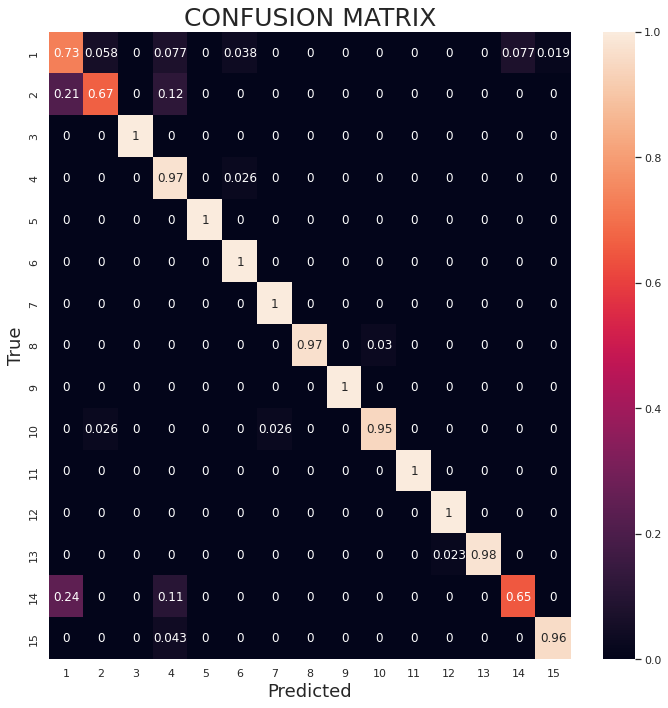

In [119]:
get_metrics(y_test_rest, y_pred_rest, labels=labels)

In [120]:
print(labels)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


In [121]:
print(classification_report(y_test_rest, y_pred_rest, target_names=[str(label) for label in labels]))

              precision    recall  f1-score   support

           1       0.68      0.73      0.70        52
           2       0.88      0.67      0.76        42
           3       1.00      1.00      1.00        32
           4       0.71      0.97      0.82        38
           5       1.00      1.00      1.00        51
           6       0.93      1.00      0.96        40
           7       0.97      1.00      0.99        38
           8       1.00      0.97      0.98        33
           9       1.00      1.00      1.00        59
          10       0.97      0.95      0.96        38
          11       1.00      1.00      1.00        36
          12       0.97      1.00      0.99        34
          13       1.00      0.98      0.99        43
          14       0.86      0.65      0.74        37
          15       0.98      0.96      0.97        47

    accuracy                           0.92       620
   macro avg       0.93      0.92      0.92       620
weighted avg       0.93   

# **RNN Task**

##**1.Build the model**

In [122]:
input_shape = (1200,1)

In [123]:
RNN_task = keras.Sequential(
    [
        keras.layers.Input(input_shape),
      
        tf.keras.layers.GRU(16, activation = 'tanh', return_sequences=True, dropout = 0.1),
      
        tf.keras.layers.GRU(16, activation = 'tanh', return_sequences=True, dropout = 0.1),
      
        keras.layers.Flatten(),

        keras.layers.Dense(16, activation = 'relu', kernel_regularizer = 'L2'),
        keras.layers.Dense(num_classes, activation="softmax") #fully-connected
    ]
)
print(RNN_task.summary())

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 1200, 16)          912       
                                                                 
 gru_3 (GRU)                 (None, 1200, 16)          1632      
                                                                 
 flatten_1 (Flatten)         (None, 19200)             0         
                                                                 
 dense_10 (Dense)            (None, 16)                307216    
                                                                 
 dense_11 (Dense)            (None, 15)                255       
                                                                 
Total params: 310,015
Trainable params: 310,015
Non-trainable params: 0
_________________________________________________________________
None


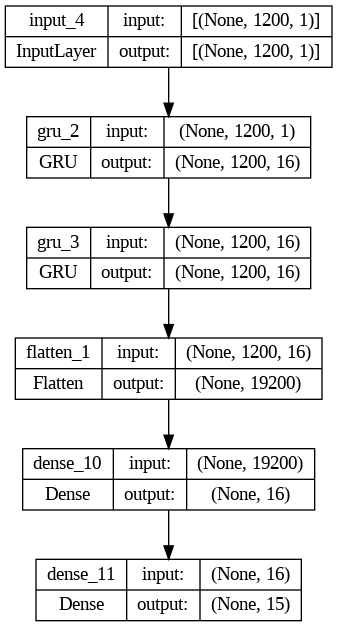

In [124]:
keras.utils.plot_model(RNN_task, "gru_task.png", show_shapes=True)

##**2. Train the model**

In [125]:
# Categorical classes
y_train_cat_task = keras.utils.to_categorical(y_train_task, num_classes)
y_test_cat_task = keras.utils.to_categorical(y_test_task, num_classes)
y_val_cat_task = keras.utils.to_categorical(y_val_task, num_classes)

In [126]:
## COMPUTE CLASS WEIGHTS FOR UNBALANCED CLASSES


occurrence = np.bincount(y_train_task)
n_samples = np.array(y_train_task.shape)
n_classes = num_classes


class_weights = dict()

for i in range(0,15):
    score = n_samples/(n_classes * occurrence[i])

    class_weights[i] = score


print(class_weights)

{0: array([1.08126521]), 1: array([0.91440329]), 2: array([0.93755274]), 3: array([0.70877193]), 4: array([0.89236948]), 5: array([0.98101545]), 6: array([1.07342995]), 7: array([1.35902141]), 8: array([0.88174603]), 9: array([1.01461187]), 10: array([1.08126521]), 11: array([1.1664042]), 12: array([1.0009009]), 13: array([1.05809524]), 14: array([1.17566138])}


In [127]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 5), TimingCallback()]
optimizer = keras.optimizers.Adam(learning_rate = 5e-4) 
RNN_task.compile(loss="categorical_crossentropy", optimizer= optimizer, weighted_metrics=["accuracy"]) 

batch_size = 32 
epochs = 40

In [128]:
history_RNN_task = RNN_task.fit(X_train_task, y_train_cat_task, batch_size=batch_size, epochs=epochs, class_weight = class_weights, validation_data = (X_val_task, y_val_cat_task), callbacks = callbacks)

Epoch 1/40
70/70 [==============================] - 11s 92ms/step - loss: 2.4833 - accuracy: 0.2448 - val_loss: 2.0823 - val_accuracy: 0.3615
Epoch 2/40
70/70 [==============================] - 5s 70ms/step - loss: 1.6889 - accuracy: 0.5153 - val_loss: 1.5190 - val_accuracy: 0.5863
Epoch 3/40
70/70 [==============================] - 5s 77ms/step - loss: 1.2861 - accuracy: 0.6358 - val_loss: 1.3025 - val_accuracy: 0.6115
Epoch 4/40
70/70 [==============================] - 5s 69ms/step - loss: 1.0901 - accuracy: 0.6919 - val_loss: 1.0984 - val_accuracy: 0.7086
Epoch 5/40
70/70 [==============================] - 5s 68ms/step - loss: 0.9722 - accuracy: 0.7513 - val_loss: 1.0753 - val_accuracy: 0.6924
Epoch 6/40
70/70 [==============================] - 5s 78ms/step - loss: 0.8276 - accuracy: 0.8089 - val_loss: 0.9548 - val_accuracy: 0.7500
Epoch 7/40
70/70 [==============================] - 5s 67ms/step - loss: 0.7425 - accuracy: 0.8293 - val_loss: 0.9222 - val_accuracy: 0.7428
Epoch 8/40
7

In [129]:
print(sum(callbacks[1].logs))

168.63629298499973


### **Save the model and the history**

In [130]:
# Save trained model
RNN_task.save(f'/content/RNN_task.h5') 

# Save history json
with open(f'/content/history_RNN_task.json', 'w', encoding='utf-8') as f:
    json.dump(history_RNN_task.history, f, ensure_ascii=False, indent=4)

In [131]:
# Load saved model
saved_RNN_task = load_model(f'/content/RNN_task.h5')

#Load history json
with open(f'/content/history_RNN_task.json', "r") as f:
  saved_history_RNN_task = json.load(f)

### **Evaluate the model**


- Learning curves

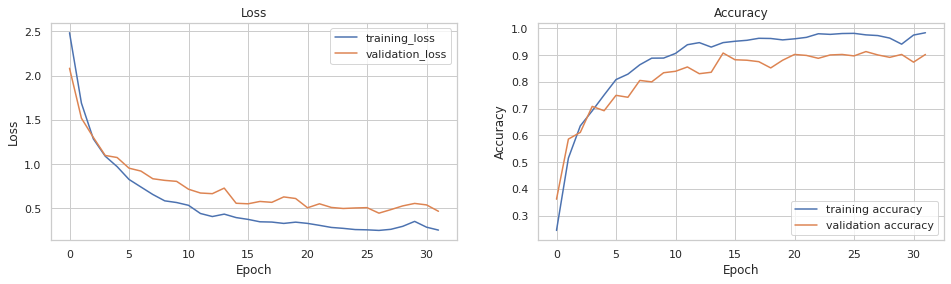

In [132]:
plot_history(history_RNN_task, path = 'History_RNN_task.png')

- Confusion matrix

In [133]:
y_pred_task = RNN_task.predict(X_test_task)
y_pred_task = np.argmax(y_pred_task, axis=1) 

30/30 [==============================] - 2s 31ms/step


In [134]:
## COMPUTE SAMPLE WEIGHTS FOR TEST SET, FOR UNBALANCED CLASSES
n_samples = np.array(y_test_task.shape)
n_classes = num_classes
occurrence = np.bincount(y_test_task)

print (occurrence)

weights = np.zeros(num_classes)
for i in range(0,15):
  weights[i,] = n_samples/(n_classes * occurrence[i])

weights = np.array(weights)
print(weights)
print(weights.shape)

sample_weights = np.zeros(len(y_test_task))
for i in range(0, len(y_test_task)):
  pos = y_test_task[i]
  sample_weights[i] = weights[pos,]

print(sample_weights.shape)


[57 68 67 87 70 63 58 46 71 61 57 53 62 59 53]
[1.09005848 0.91372549 0.92736318 0.71417625 0.88761905 0.98624339
 1.07126437 1.35072464 0.87511737 1.01857923 1.09005848 1.17232704
 1.00215054 1.05310734 1.17232704]
(15,)
(932,)


In [135]:
score = RNN_task.evaluate(X_test_task, y_test_cat_task, sample_weight=sample_weights, verbose=0)

print("Test loss:", score[0])
print("Test accuracy:", score[1])



Test loss: 0.4465773403644562
Test accuracy: 0.9160369634628296


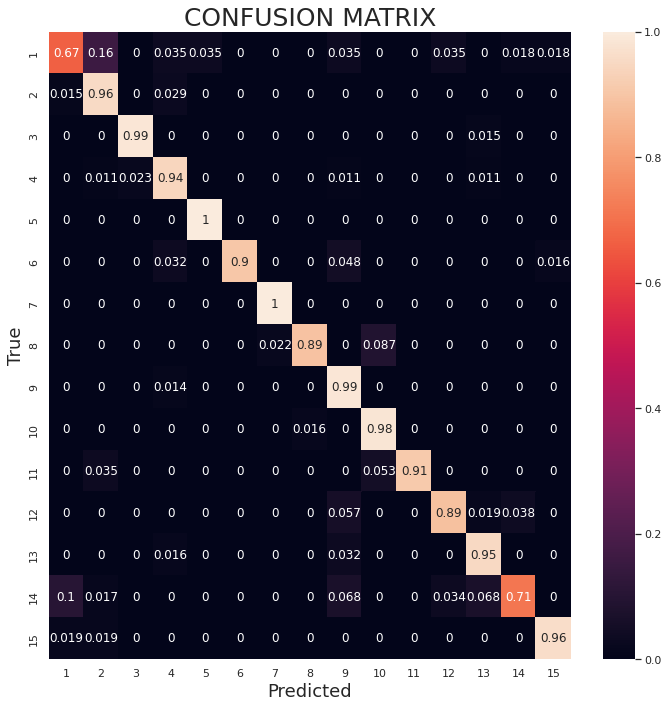

In [136]:
get_metrics(y_test_task, y_pred_task, labels=labels)

In [137]:
print(labels)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


In [138]:
print(classification_report(y_test_task, y_pred_task, target_names=[str(label) for label in labels]))

              precision    recall  f1-score   support

           1       0.83      0.67      0.74        57
           2       0.82      0.96      0.88        68
           3       0.97      0.99      0.98        67
           4       0.91      0.94      0.93        87
           5       0.97      1.00      0.99        70
           6       1.00      0.90      0.95        63
           7       0.98      1.00      0.99        58
           8       0.98      0.89      0.93        46
           9       0.82      0.99      0.90        71
          10       0.90      0.98      0.94        61
          11       1.00      0.91      0.95        57
          12       0.92      0.89      0.90        53
          13       0.89      0.95      0.92        62
          14       0.93      0.71      0.81        59
          15       0.96      0.96      0.96        53

    accuracy                           0.92       932
   macro avg       0.93      0.92      0.92       932
weighted avg       0.92   

# **CONVOLUTIONAL 2D**

##**1.Build the model**

In [139]:
## CHECK SIZE, IT MUST BE (size,42,42,1)

print(X_train_spect_rest.shape, X_test_spect_rest.shape)

(1471, 42, 42) (620, 42, 42)


In [140]:
#Expand dims 
X_train_spect_rest = np.expand_dims(X_train_spect_rest, -1) 
X_test_spect_rest = np.expand_dims(X_test_spect_rest, -1)
X_val_spect_rest = np.expand_dims(X_val_spect_rest, -1)
print(X_train_spect_rest.shape, X_test_spect_rest.shape)

## PAY ATTENTION, THE DIMENSION MUST BE (size, 42,42,1)
## IF RUN AGAIN, USE THE ABOVE 'SQUEEZE' TO SET THE RIGHT DIMENSION

(1471, 42, 42, 1) (620, 42, 42, 1)


In [141]:
## SQUEEZE DIMENSION

# X_train_spect_rest = np.squeeze(X_train_spect_rest, -1) 
# X_test_spect_rest = np.squeeze(X_test_spect_rest, -1)
# X_val_spect_rest = np.squeeze(X_val_spect_rest, -1)
# print(X_train_spect_rest.shape, X_test_spect_rest.shape)

In [142]:
img_shape = (42,42,1)

In [143]:
# NETWORK MODEL

CONV2D_rest = keras.Sequential(
    [
        keras.layers.Input(img_shape),

        keras.layers.Conv2D(32, (3, 3), strides=(1,1), padding='same', activation=None),
        keras.layers.BatchNormalization(axis=-1),
        keras.layers.Activation('relu'),
          
        keras.layers.MaxPool2D((2, 2), strides=(1, 1), padding='same'),
            
        keras.layers.Conv2D(64, (3, 3), strides=(1,1), padding='same', activation=None),
        keras.layers.BatchNormalization(axis=-1),
        keras.layers.Activation('relu'),
            
        keras.layers.MaxPool2D((2, 2), strides=(1, 1), padding='same'),
     

        keras.layers.Conv2D(128, (4, 4), strides=(1,1), padding='same', activation=None),
        keras.layers.BatchNormalization(axis=-1),
        keras.layers.Activation('relu'),
     
        keras.layers.MaxPool2D(pool_size=2, padding='same'),

              
        keras.layers.Flatten(), 
        keras.layers.Dropout(0.6), 
     
        keras.layers.Dense(num_classes, activation="softmax") #fully-connected
     
      ]
)

print(CONV2D_rest.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 42, 42, 32)        320       
                                                                 
 batch_normalization_4 (Batc  (None, 42, 42, 32)       128       
 hNormalization)                                                 
                                                                 
 activation (Activation)     (None, 42, 42, 32)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 42, 42, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 42, 42, 64)        18496     
                                                                 
 batch_normalization_5 (Batc  (None, 42, 42, 64)      

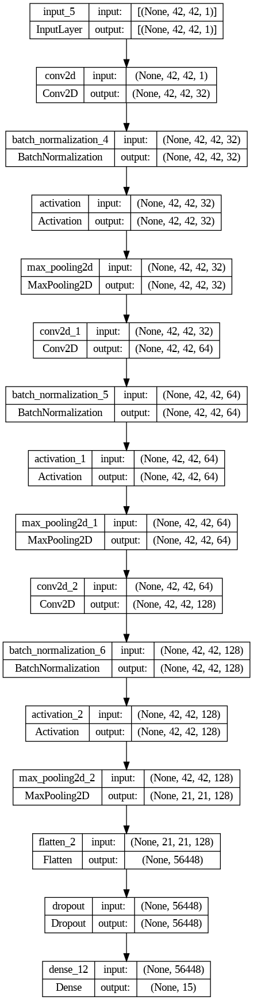

In [144]:
keras.utils.plot_model(CONV2D_rest, "CONV2D_rest.png", show_shapes=True)

##**2. Train the model**

In [145]:
# Categorical classes
y_train_cat_rest = keras.utils.to_categorical(y_train_spect_rest, num_classes)
y_test_cat_rest = keras.utils.to_categorical(y_test_spect_rest, num_classes)
y_val_cat_rest = keras.utils.to_categorical(y_val_spect_rest, num_classes)

In [146]:
## COMPUTE CLASS WEIGHTS FOR UNBALANCED CLASSES

 
occurrence = np.bincount(y_train_rest)
n_samples = np.array(y_train_rest.shape)
n_classes = num_classes


class_weights = dict()

for i in range(0,15):
    score = n_samples/(n_classes * occurrence[i])

    class_weights[i] = score


print(class_weights)

{0: array([0.79728997]), 1: array([0.9709571]), 2: array([1.27359307]), 3: array([1.07765568]), 4: array([0.80382514]), 5: array([1.04326241]), 6: array([1.08962963]), 7: array([1.27359307]), 8: array([0.69061033]), 9: array([1.07765568]), 10: array([1.16746032]), 11: array([1.22583333]), 12: array([0.9709571]), 13: array([1.11439394]), 14: array([0.89151515])}


In [147]:
callbacks = [EarlyStopping(monitor = 'val_loss', patience = 8), TimingCallback()]
opt = keras.optimizers.SGD(learning_rate=0.0001,momentum=0.01)
CONV2D_rest.compile(loss="categorical_crossentropy", optimizer=opt, weighted_metrics=["accuracy"]) 

batch_size = 8 
epochs = 60 

In [148]:
history_CONV2D_rest = CONV2D_rest.fit(X_train_spect_rest, y_train_cat_rest, batch_size=batch_size, epochs=epochs, class_weight= class_weights, validation_data = (X_val_spect_rest, y_val_cat_rest), callbacks = [callbacks])

Epoch 1/60
184/184 [==============================] - 8s 13ms/step - loss: 2.6489 - accuracy: 0.1440 - val_loss: 2.7083 - val_accuracy: 0.0543
Epoch 2/60
184/184 [==============================] - 2s 11ms/step - loss: 2.2753 - accuracy: 0.2456 - val_loss: 2.7093 - val_accuracy: 0.0571
Epoch 3/60
184/184 [==============================] - 2s 10ms/step - loss: 2.1520 - accuracy: 0.2823 - val_loss: 2.6982 - val_accuracy: 0.0707
Epoch 4/60
184/184 [==============================] - 2s 10ms/step - loss: 1.9604 - accuracy: 0.3456 - val_loss: 2.1932 - val_accuracy: 0.3152
Epoch 5/60
184/184 [==============================] - 2s 12ms/step - loss: 1.8341 - accuracy: 0.3869 - val_loss: 1.8537 - val_accuracy: 0.3071
Epoch 6/60
184/184 [==============================] - 2s 12ms/step - loss: 1.7219 - accuracy: 0.4206 - val_loss: 1.7377 - val_accuracy: 0.5163
Epoch 7/60
184/184 [==============================] - 2s 10ms/step - loss: 1.6406 - accuracy: 0.4454 - val_loss: 1.4825 - val_accuracy: 0.5598

In [149]:
print(sum(callbacks[1].logs))

101.61886154400008


### **Save the model and the history**

In [150]:
# Save trained model
CONV2D_rest.save(f'/content/CONV2D_rest.h5') 

# Save history json
with open(f'/content/history_CONV2D_rest.json', 'w', encoding='utf-8') as f:
    json.dump(history_CONV2D_rest.history, f, ensure_ascii=False, indent=4)

In [151]:
# Load saved model
saved_CONV2D_rest = load_model(f'/content/CONV2D_rest.h5')

#Load history json
with open(f'/content/history_CONV2D_rest.json', "r") as f:
  saved_history_CONV2D_rest = json.load(f)

###**Evaluate the model**


- Learning curves

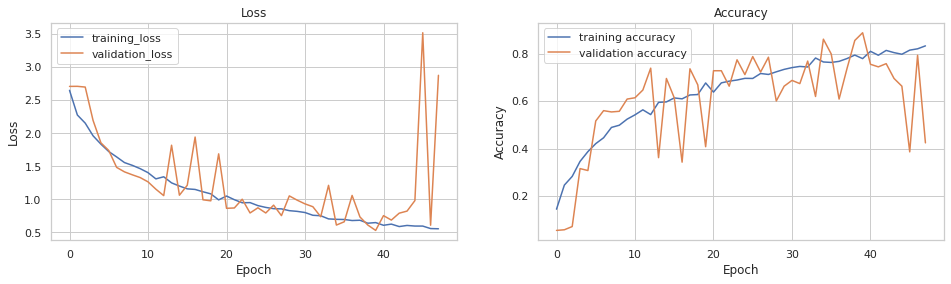

In [152]:
plot_history(history_CONV2D_rest, path = 'CONV2D_rest.png')

- Confusion matrix

In [153]:
y_pred_spect_rest = CONV2D_rest.predict(X_test_spect_rest)
y_pred_spect_rest = np.argmax(y_pred_spect_rest, axis=1) 

20/20 [==============================] - 0s 11ms/step


In [154]:
## COMPUTE SAMPLE WEIGHTS FOR TEST SET, FOR UNBALANCED CLASSES
n_samples = np.array(y_test_spect_rest.shape)
n_classes = num_classes
occurrence = np.bincount(y_test_spect_rest)

print (occurrence)

weights = np.zeros(num_classes)
for i in range(0,15):
  weights[i,] = n_samples/(n_classes * occurrence[i])

weights = np.array(weights)
print(weights)
print(weights.shape)

sample_weights = np.zeros(len(y_test_spect_rest))
for i in range(0, len(y_test_spect_rest)):
  pos = y_test_spect_rest[i]
  sample_weights[i] = weights[pos,]

print(sample_weights.shape)


[52 42 32 38 51 40 38 33 59 38 36 34 43 37 47]
[0.79487179 0.98412698 1.29166667 1.0877193  0.81045752 1.03333333
 1.0877193  1.25252525 0.70056497 1.0877193  1.14814815 1.21568627
 0.96124031 1.11711712 0.87943262]
(15,)
(620,)


In [155]:
score = CONV2D_rest.evaluate(X_test_spect_rest, y_test_cat_rest, sample_weight=sample_weights, verbose=0)

print("Test loss:", score[0])
print("Test accuracy:", score[1])



Test loss: 3.0936200618743896
Test accuracy: 0.3909173309803009


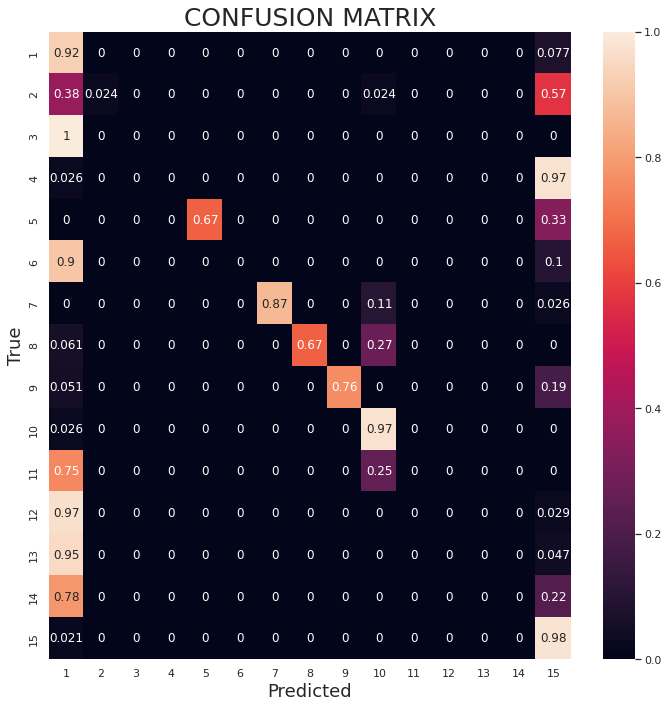

In [156]:
get_metrics(y_test_spect_rest, y_pred_spect_rest, labels=labels)

In [157]:
print(labels)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


In [158]:
print(classification_report(y_test_spect_rest, y_pred_spect_rest, target_names=[str(label) for label in labels]))

              precision    recall  f1-score   support

           1       0.18      0.92      0.30        52
           2       1.00      0.02      0.05        42
           3       0.00      0.00      0.00        32
           4       0.00      0.00      0.00        38
           5       1.00      0.67      0.80        51
           6       0.00      0.00      0.00        40
           7       1.00      0.87      0.93        38
           8       1.00      0.67      0.80        33
           9       1.00      0.76      0.87        59
          10       0.62      0.97      0.76        38
          11       0.00      0.00      0.00        36
          12       0.00      0.00      0.00        34
          13       0.00      0.00      0.00        43
          14       0.00      0.00      0.00        37
          15       0.30      0.98      0.46        47

    accuracy                           0.43       620
   macro avg       0.41      0.39      0.33       620
weighted avg       0.43   

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
